Hello! Welcome to the autocalibration pipeline for SLAB superconducting qubits. This autocalibration code will run the following experiments in this order !!!!!!. The data will them be saved automatically to the configuration file <code>autocalibrate_cfg.yml</code> 

Initializations

In [1]:
# %matplotlib widget
%matplotlib inline

%load_ext autoreload
%autoreload 2

import numpy as np
import matplotlib.pyplot as plt

from qick import *
from qick.helpers import gauss
from tqdm import tqdm_notebook as tqdm

import time
import os
import sys
import scipy as sp
import json
import cProfile
import re 

from scipy.fft import fft, fftfreq

from slab.instruments import *
from slab.experiment import Experiment
from slab.datamanagement import SlabFile
from slab import get_next_filename, AttrDict
from datetime import datetime

# Figure params
plt.rcParams['figure.figsize'] = [10,6]
plt.rcParams.update({'font.size': 14})

Could not import QickSoc: No module named 'pynq'
Could not load InstrumentManagerWindow
Could not import QickInstrument, try install qick package
Could not load labbrick
Could not load Autonics TM4 Driver


In [2]:
# %aimport experiments
# NOTE: ADDING NEW METHODS WILL NOT BE UPDATED
import experiments as meas


imported experiments.clifford_averager_program
imported experiments.fitting
imported experiments.qram_protocol_timestepped
imported experiments.single_qubit.acstarkshift_spectroscopy
imported experiments.single_qubit.amplitude_rabi
imported experiments.single_qubit.DONOTUSE_ramsey_ef
imported experiments.single_qubit.DONOTUSE_randbench
imported experiments.single_qubit.length_rabi
imported experiments.single_qubit.pulse_probe_ef_spectroscopy
imported experiments.single_qubit.pulse_probe_spectroscopy
imported experiments.single_qubit.pulse_probe_spectroscopy_test
imported experiments.single_qubit.resonator_spectroscopy
imported experiments.single_qubit.rfsoc_tof_calibration
imported experiments.single_qubit.SingleRB
imported experiments.single_qubit.single_shot
imported experiments.single_qubit.t1
imported experiments.single_qubit.t1_2qb
imported experiments.single_qubit.t2_echo
imported experiments.single_qubit.t2_ramsey
imported experiments.three_qubit.threeQ_state_tomo
imported exper

In [3]:
import importlib 
importlib.reload(meas)


imported experiments.clifford_averager_program
imported experiments.fitting
imported experiments.qram_protocol_timestepped
imported experiments.single_qubit.acstarkshift_spectroscopy
imported experiments.single_qubit.amplitude_rabi
imported experiments.single_qubit.DONOTUSE_ramsey_ef
imported experiments.single_qubit.DONOTUSE_randbench
imported experiments.single_qubit.length_rabi
imported experiments.single_qubit.pulse_probe_ef_spectroscopy
imported experiments.single_qubit.pulse_probe_spectroscopy
imported experiments.single_qubit.pulse_probe_spectroscopy_test
imported experiments.single_qubit.resonator_spectroscopy
imported experiments.single_qubit.rfsoc_tof_calibration
imported experiments.single_qubit.SingleRB
imported experiments.single_qubit.single_shot
imported experiments.single_qubit.t1
imported experiments.single_qubit.t1_2qb
imported experiments.single_qubit.t2_echo
imported experiments.single_qubit.t2_ramsey
imported experiments.three_qubit.threeQ_state_tomo
imported exper

<module 'experiments' from 'c:\\_Lib\\python\\rfsoc\\elaine_rfsoc\\slab_rfsoc_expts\\experiments\\__init__.py'>

In [4]:
"""Reopen saved data"""
def prev_data(expt_path, filename):
    temp_data_file = expt_path+'/'+filename
    with SlabFile(temp_data_file) as a:
        attrs = dict()
        for key in list(a.attrs):
            attrs.update({key:json.loads(a.attrs[key])})
        keys = list(a)
        temp_data = dict()
        for key in keys:
            temp_data.update({key:np.array(a[key])})
        print(f'Extracted data and attrs {list(a.attrs)}')
    return temp_data, attrs

In [11]:
expt_path=os.getcwd()
# print('Data will be stored in', expt_path)

# Set the configuration file 

Note: make sure you set your ADC/DAC channels correctly. This code does not automatically fill in the ADC/DAC into your configuration file, so you should check yourself to make sure these values are correct. 

In [6]:
import yaml
# Results config file:
results_config_file = 'autocalibration_cfg.yml'
results_config_path = os.getcwd() + '\\' + results_config_file
print('Results config will be', results_config_path)

# open the file 
with open(results_config_file,'r') as file:
  auto_cfg=AttrDict(yaml.safe_load(file)) # turn it into an attribute dictionary 

def save_edits(file_name, edit_config, edit_list, qubit_i,  value):
    print('Assumes edit_list is already in edit_config')
    print('If it is not, it will not update edit_config')
    # open the file 
    # edit the file
    edit_list[qubit_i] = value
    # dump it: 
    edit_config= yaml.safe_dump(edit_config.to_dict(), default_flow_style=  True)

    # write it: 
    with open(file_name, 'w') as modified_file:
        modified_file.write(edit_config)

    # now, open the modified file again 
    with open(file_name,'r') as file:
      edit_config=AttrDict(yaml.safe_load(file)) # turn it into an attribute dictionary 
    return edit_config

Results config will be c:\_Lib\python\rfsoc\elaine_rfsoc\slab_rfsoc_expts\autocalibration_cfg.yml


In [6]:
num_qubits = 6

In [7]:
import yaml

# Results config file:
results_config_file = 'autocalibration_cfg.yml'
results_config_path = os.getcwd() + '\\' + results_config_file
print('Results config will be', results_config_path)

# open the file 
with open(results_config_file,'r') as file:
  auto_cfg=AttrDict(yaml.safe_load(file)) # turn it into an attribute dictionary 

Results config will be c:\_Lib\python\rfsoc\elaine_rfsoc\slab_rfsoc_expts\autocalibration_cfg.yml


In [87]:
# with open(results_config_file,'r') as file:
#   auto_cfg=AttrDict(yaml.safe_load(file)) # turn it into an attribute dictionary 

# make sure the config file is updated with the correct number of qubits
# for subcfg in (auto_cfg.device.readout, auto_cfg.device.qubit, auto_cfg.hw.soc):
#     for key, value in subcfg.items() :
#         if isinstance(value, dict):
#             for key2, value2 in value.items():
#                 for key3, value3 in value2.items():
#                     if not(isinstance(value3, list)):
#                         value2.update({key3: [value3]*num_qubits})                                
#         elif not(isinstance(value, list)):
#             subcfg.update({key: [value]*num_qubits})

auto_cfg.device.qubit.T1 = []
auto_cfg.device.qubit.f_ge = [] 
auto_cfg.device.qubit.f_EgGf = []
auto_cfg.device.qubit.f_ef = []
auto_cfg.device.qubit.kappa = []
auto_cfg.device.qubit.pulses.hpi_ge.gain = [] 
auto_cfg.device.qubit.pulses.hpi_ge.sigma = [] 
auto_cfg.device.qubit.pulses.pi_ge.gain = [] 
auto_cfg.device.qubit.pulses.pi_ge.sigma = [] 
auto_cfg.device.qubit.pulses.pi_EgGf.gain = [] 
auto_cfg.device.qubit.pulses.pi_EgGf.sigma = []
auto_cfg.device.qubit.pulses.pi_ef.gain = []
auto_cfg.device.qubit.pulses.pi_ef.sigma = []
auto_cfg.device.readout.Max_amp = [] 
auto_cfg.device.readout.frequency = [] 
auto_cfg.device.readout.gain = [] 
auto_cfg.device.readout.phase = [] 
auto_cfg.device.readout.readout_length = [] 
auto_cfg.device.readout.threshold = [] 
auto_cfg.device.readout.kappa = []  

for i in range(num_qubits):      
  auto_cfg.device.qubit.T1.append(100)
  auto_cfg.device.qubit.f_ge.append(3300)
  auto_cfg.device.qubit.f_EgGf.append(2000)
  auto_cfg.device.qubit.f_ef.append(4000)
  auto_cfg.device.qubit.kappa.append(0)
  auto_cfg.device.qubit.pulses.hpi_ge.gain.append(500)
  auto_cfg.device.qubit.pulses.hpi_ge.sigma.append(0.20)
  auto_cfg.device.qubit.pulses.pi_ge.gain.append(1000)
  auto_cfg.device.qubit.pulses.pi_ge.sigma.append(0.01)
  auto_cfg.device.qubit.pulses.pi_EgGf.gain = int(10000)
  auto_cfg.device.qubit.pulses.pi_EgGf.sigma = 0.1
  auto_cfg.device.qubit.pulses.pi_ef.gain = int(10000)
  auto_cfg.device.qubit.pulses.pi_ef.sigma = 0.1
  auto_cfg.device.readout.Max_amp.append(int(1))
  auto_cfg.device.readout.frequency.append(7000)
  auto_cfg.device.readout.gain.append(int(15000))
  auto_cfg.device.readout.phase.append(0)
  auto_cfg.device.readout.readout_length.append(5)
  auto_cfg.device.readout.threshold.append(0)
  auto_cfg.device.readout.kappa.append(0)


# # dump it: 
auto_cfg= yaml.safe_dump(auto_cfg.to_dict(), default_flow_style=  True)

# # write it: 
with open('autocalibration_cfg.yml', 'w') as modified_file:
  modified_file.write(auto_cfg)

# now, open the modified file again 
with open('autocalibration_cfg.yml','r') as file:
  auto_cfg=AttrDict(yaml.safe_load(file)) # turn it into an attribute dictionary 


In [8]:
im = InstrumentManager(ns_address='192.168.137.1') # SLAC lab

soc = QickConfig(im[auto_cfg['aliases']['soc']].get_cfg())
print(soc)
print(auto_cfg['aliases']['soc'])
print(soc.description())



QICK configuration:

	Board: ZCU216

	Global clocks (MHz): tProcessor 430.080, RF reference 245.760

	7 signal generator channels:
	0:	axis_signal_gen_v4 - tProc output 1, envelope memory 65536 samples
		DAC tile 2, ch 0, 32-bit DDS, fabric=430.080 MHz, fs=6881.280 MHz
	1:	axis_signal_gen_v4 - tProc output 2, envelope memory 65536 samples
		DAC tile 2, ch 1, 32-bit DDS, fabric=430.080 MHz, fs=6881.280 MHz
	2:	axis_signal_gen_v4 - tProc output 3, envelope memory 65536 samples
		DAC tile 2, ch 2, 32-bit DDS, fabric=430.080 MHz, fs=6881.280 MHz
	3:	axis_signal_gen_v4 - tProc output 4, envelope memory 65536 samples
		DAC tile 2, ch 3, 32-bit DDS, fabric=430.080 MHz, fs=6881.280 MHz
	4:	axis_signal_gen_v4 - tProc output 5, envelope memory 65536 samples
		DAC tile 3, ch 0, 32-bit DDS, fabric=430.080 MHz, fs=6881.280 MHz
	5:	axis_signal_gen_v4 - tProc output 6, envelope memory 65536 samples
		DAC tile 3, ch 1, 32-bit DDS, fabric=430.080 MHz, fs=6881.280 MHz
	6:	axis_signal_gen_v4 - tProc out

# Time of Flight (TOF)

TOF measures the time it takes for the signal to run through the wires. It will give us the time in clock ticks that we should wait to make a measurements 

215 307
readout freq 0 +/- 7098.030026730655


  0%|          | 0/1000 [00:00<?, ?it/s]

Saving c:\_Lib\python\rfsoc\elaine_rfsoc\slab_rfsoc_expts\data\00035_adc_trig_offset_calibration_qubit0.h5


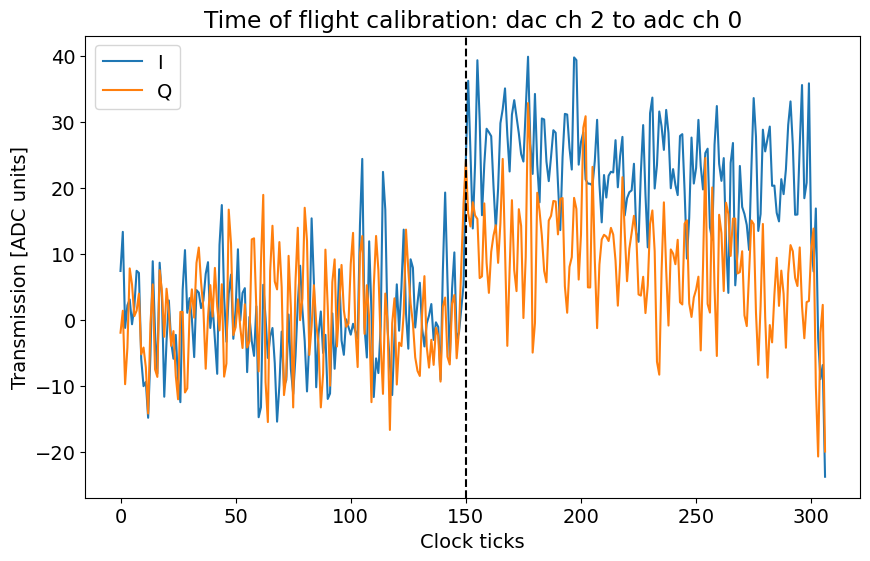

In [9]:
qubit_i = 0
tof = meas.ToFCalibrationExperiment(
    soccfg=soc,
    path=expt_path,
    prefix=f"adc_trig_offset_calibration_qubit{qubit_i}",
    config_file=results_config_path,
)

tof.cfg.expt = dict(
    pulse_length=0.5, # [us]
    readout_length=1.0, # [us]
    trig_offset=0, # [clock ticks]
    gain=30000, # blast the power just for the RFSoC calibration
    # gain=5000, # [MUX units: -1 to 1]
    frequency=tof.cfg.device.readout.frequency[qubit_i], # [MHz]
    reps=1000, # Number of averages per point
    # qubit=qubit_i,
    qubit=qubit_i,
)
tof.cfg.device.readout.relax_delay=0.1 # wait time between experiments [us]

import Pyro4.util
try: 
    tof.go(analyze=False, display=False, progress=True, save=True)
except Exception:
    print("Pyro traceback:")
    print("".join(Pyro4.util.getPyroTraceback()))

tof.display(adc_trig_offset=150) 

# Coarse Resonator Spectroscopy 

Run resonator spectroscopy for all resonators by choosing a large frequency scan to look over. The scan will then find the different resonators and fill in the config file with their respective frequencies. In the autocalibration, there will be a finer sweep of each resonator to more accurately find its frequency. The frequencies are saved in <code>auto_cfg.device.readout.frequency</code>

In [15]:
qubit_i = 0
rspec = meas.ResonatorSpectroscopyExperiment(
    soccfg=soc,
    path=expt_path,
    prefix=f"resonator_spectroscopy_qubit{qubit_i}",
    config_file=results_config_path,   
)
span = 160 # MHz
npts = 8000 

rspec.cfg.expt = dict(
    start = 7090, #Lowest resontaor frequency
    step=span/npts, # min step ~1 Hz
    expts=npts, # Number experiments stepping from start
    reps= 800, # Number averages per point 500
    pulse_e=False, # add ge pi pulse prior to measurement
    pulse_f=False, # add ef pi pulse prior to measurement
    qubit=qubit_i,
)

rspec.cfg.device.readout.relax_delay = 5 # Wait time between experiments [us]

rspec.go(analyze=False, display=False, progress=True, save=False)

rspec.analyze(fit=False, findpeaks=False, coarse_scan = True)
rspec.display(fit=False, findpeaks=False, coarse_scan = True)


  0%|          | 0/8000 [00:00<?, ?it/s]

NameError: name 'find_peaks' is not defined

number of peaks: 3


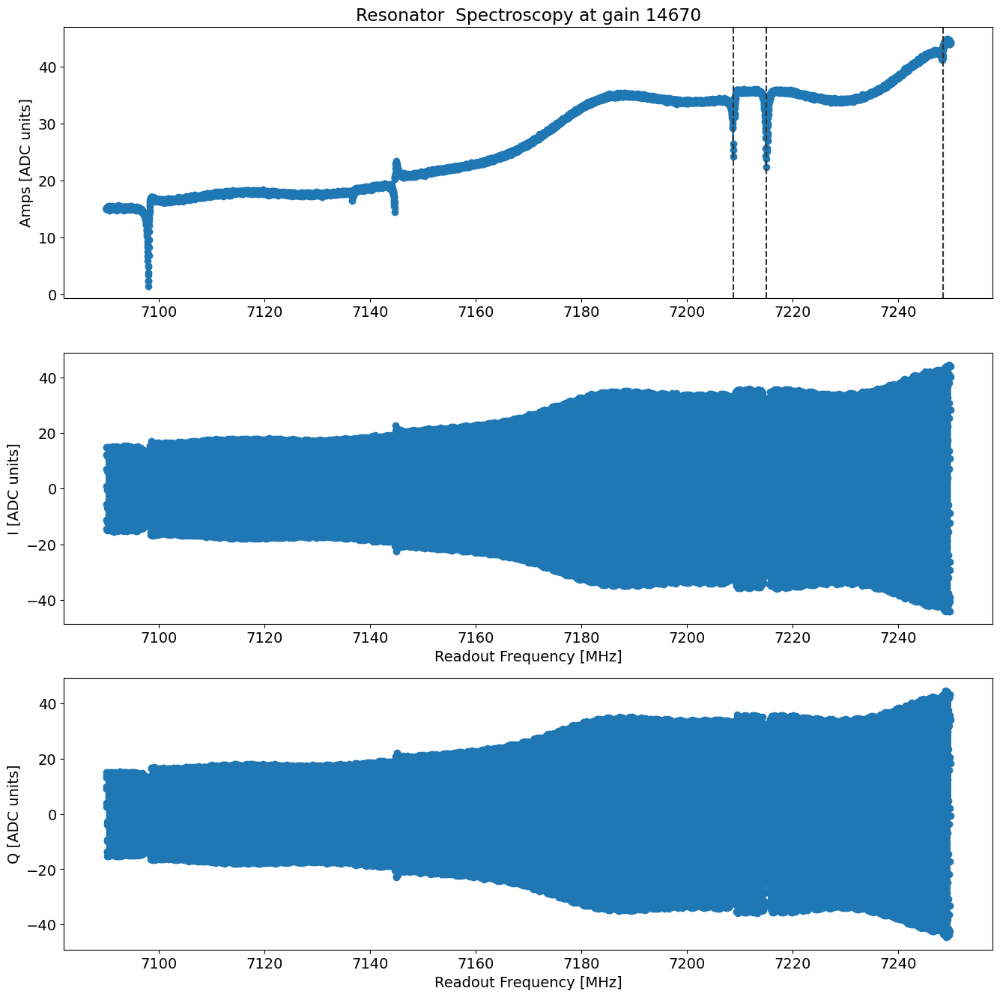

In [16]:

rspec.analyze(fit=False, findpeaks=False, coarse_scan = True)
rspec.display(fit=False, findpeaks=False, coarse_scan = True)

From Fit:
	f0: 7098.252803904504
	kappa[MHz]: 0.35238530940233437


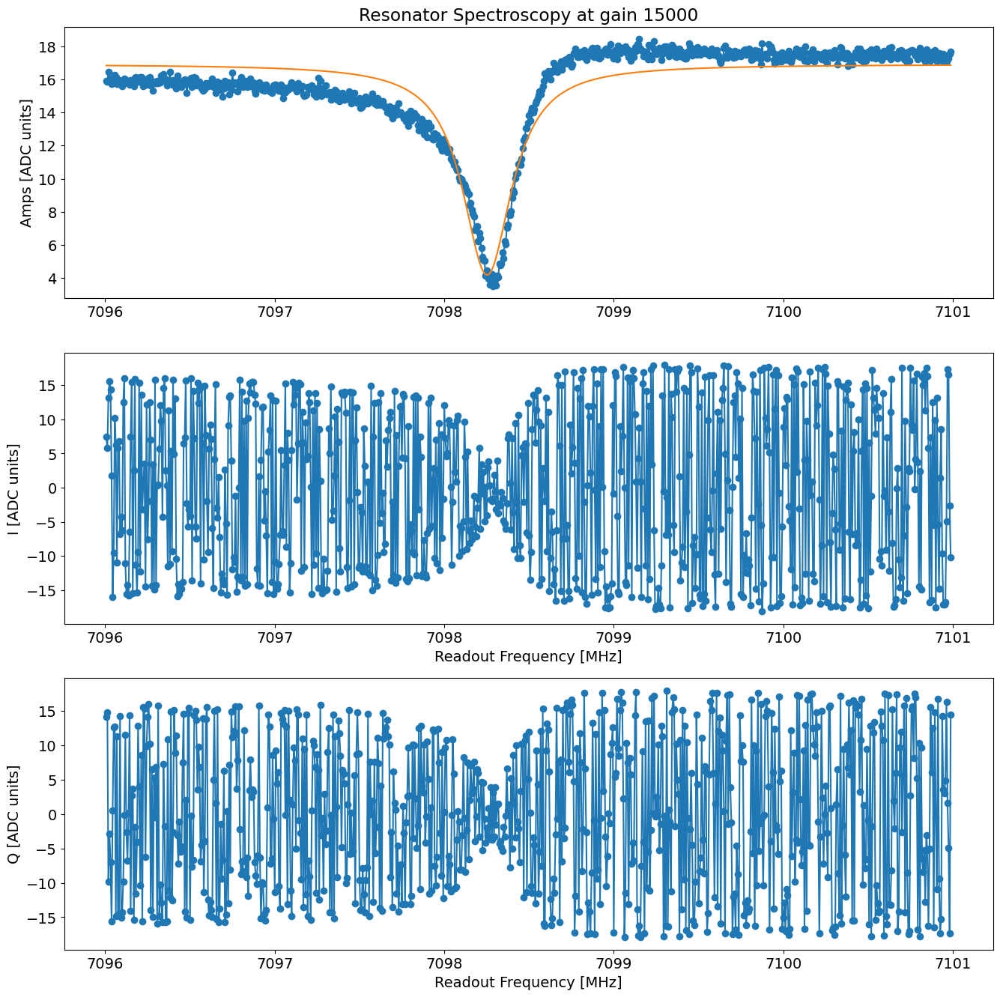

[]
[]


In [120]:
rspec.analyze(fit=False, findpeaks=False, coarse_scan = True)
rspec.display(fit=False, findpeaks=False, coarse_scan = True)
print(rspec.data['coarse_peaks'])
rspec_list = list(rspec.data['coarse_peaks'])
# rspec_list.insert(1, 7130.083)
print(rspec_list)
rspec_list = [7096.2465, 7130.083, 7142.48, 7199.914435667174, 7213.007999999999, 7242.232]


If you are okay with the peaks, save data to <code>auto_cfg.device.readout.frequency</code>

In [107]:
res_values = rspec.data['coarse_peaks']
res_values = rspec_list
# open the results config file 
with open(results_config_file,'r') as file:
    auto_cfg=AttrDict(yaml.safe_load(file)) # turn it into an attribute dictionary 
    
for i in range(len(res_values)):
    # assign the resonator frequency to the results config file
    auto_cfg.device.readout.frequency[i] = float(res_values[i])


auto_cfg= yaml.safe_dump(auto_cfg.to_dict(), default_flow_style=  True)

# write it: 
with open('autocalibration_cfg.yml', 'w') as modified_file:
    modified_file.write(auto_cfg)
# now, open the modified file again 
with open('autocalibration_cfg.yml','r') as file:
    auto_cfg=AttrDict(yaml.safe_load(file)) # turn it into an attribute dictionary 

for i in range(len(res_values)):
    print(f'*Set cfg res {i} freq to {auto_cfg.device.readout.frequency[i]}*')

*Set cfg res 0 freq to 7096.2465*
*Set cfg res 1 freq to 7130.083*
*Set cfg res 2 freq to 7142.48*
*Set cfg res 3 freq to 7199.914435667174*
*Set cfg res 4 freq to 7213.007999999999*
*Set cfg res 5 freq to 7242.232*


# Resonator Power Spectroscopy 

Find a good value for gain to park your readout at until you run readout optimization. From the 2D sweep that is produced, choose a value for gain that is right before the resonator 'breaks' (goes from e -> f). Want to choose a high value for gain because we want to be in the shot noise limited regime which increases our signal:noise ratio. The gain value should be saved in <code>auto_cfg.device.readout.gain</code>

In [38]:
results_config_file 

'autocalibration_cfg.yml'

  0%|          | 0/11 [00:00<?, ?it/s]

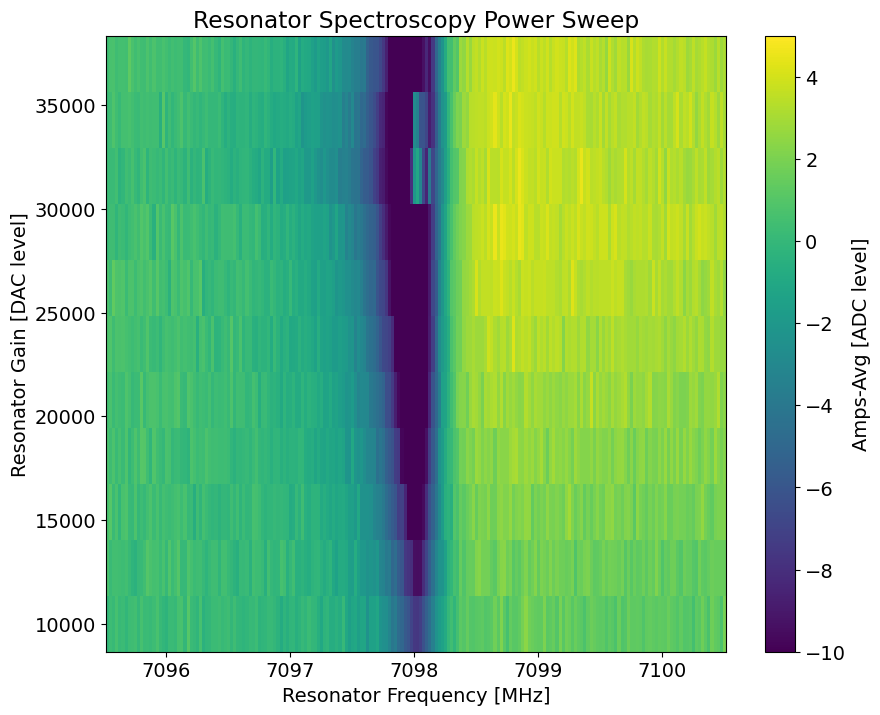

In [14]:
qubit_i = 0 
rpowspec = meas.ResonatorPowerSweepSpectroscopyExperiment(
    soccfg=soc,
    path=expt_path,
    prefix=f"ResonatorPowerSweepSpectroscopyExperiment{qubit_i}",
    config_file=results_config_file,
)

span_f = 5.0 
npts_f =  200 

span_gain = 27000 
npts_gain = 10  

rpowspec.cfg.expt = dict(
    start_f = auto_cfg.device.readout.frequency[qubit_i]-span_f/2, # resonator frequency to be mixed up [MHz]
    step_f = span_f/npts_f, # min step ~1 Hz 
    expts_f=npts_f, # Number experiments stepping freq from start
    start_gain=10000,
    step_gain=int(span_gain/npts_gain), # Gain step size
    expts_gain=npts_gain+1, # Number experiments stepping gain from start
    reps= 500, # Number averages per point
    pulse_e=False, # add ge pi pulse before measurement
    pulse_f=False, # add ef pi pulse before measurement
    qubit=qubit_i,  
) 

rpowspec.cfg.device.readout.relax_delay = 5 # Wait time between experiments [us]    
rpowspec.cfg.device.readout.readout_length = 5

rpowspec.go(analyze=False, display=False, progress=True, save=False)

# Testing 
rpowspec.analyze(fit=False, lowgain=None, highgain=None)
rpowspec.display(fit=False)

In [79]:
gain = 15000 # set desired gain value 

In [ ]:
# open the results config file 
with open(results_config_file,'r') as file:
    auto_cfg=AttrDict(yaml.safe_load(file)) # turn it into an attribute dictionary 

# assign the gain value to the results config file
for i in range(len(auto_cfg.device.readout.frequency)):
    auto_cfg.device.readout.gain[i] = int(gain)


auto_cfg= yaml.safe_dump(auto_cfg.to_dict(), default_flow_style=  True)

# write it: 
with open('autocalibration_cfg.yml', 'w') as modified_file:
    modified_file.write(auto_cfg)
# now, open the modified file again 
with open('autocalibration_cfg.yml','r') as file:
    auto_cfg=AttrDict(yaml.safe_load(file)) # turn it into an attribute dictionary 

print(f'*Set cfg readout gain  to {auto_cfg.device.readout.gain}*')

# Qubit Spectroscopy Coarse Scan 

Running qubit spectroscopy for qubit 0


  0%|          | 0/20 [00:00<?, ?it/s]

Found peak in amps at [MHz] 3308.8112252522997, HWHM 3.1427712797701814
Found peak in I at [MHz] 3477.864917111565, HWHM -49.58561922346059
Found peak in Q at [MHz] 3310.3125, HWHM 49.98125


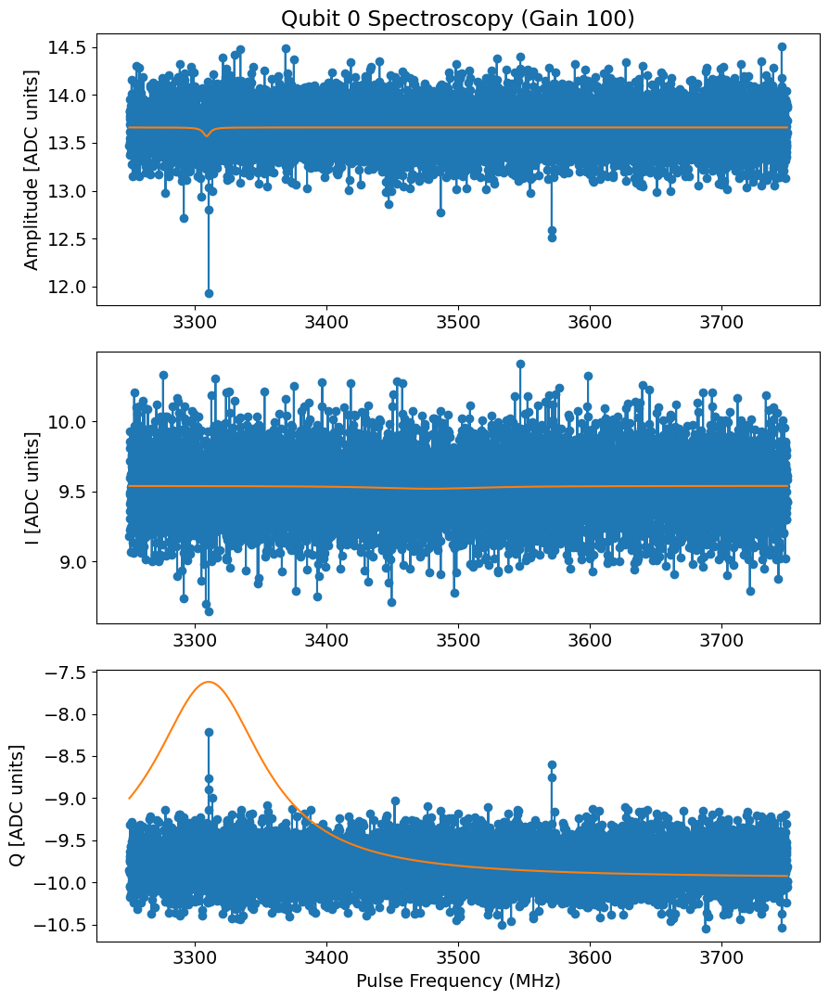

Running qubit spectroscopy for qubit 1


  0%|          | 0/20 [00:00<?, ?it/s]

Found peak in amps at [MHz] 3455.2925293538906, HWHM 41.59528113706317
Found peak in I at [MHz] 3642.161517909265, HWHM 3.919912110503391
Found peak in Q at [MHz] 3452.6022835239314, HWHM 47.90708568203624


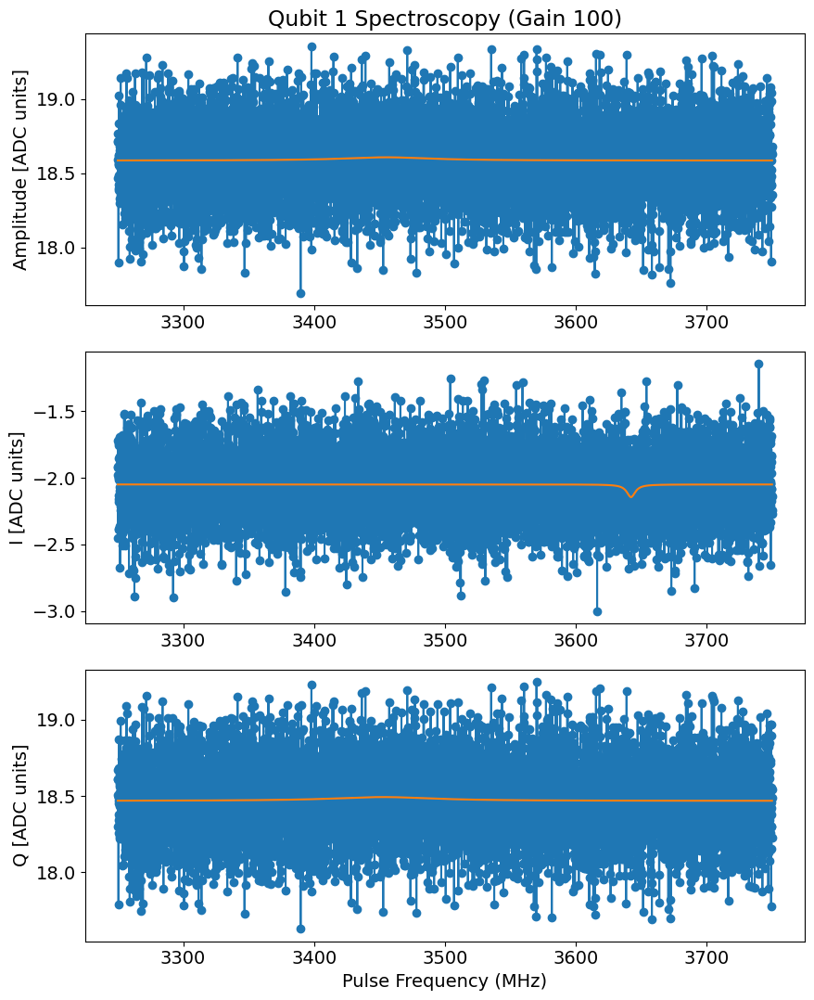

Running qubit spectroscopy for qubit 2


  0%|          | 0/20 [00:00<?, ?it/s]

Found peak in amps at [MHz] 3714.3125, HWHM 49.98125
Found peak in I at [MHz] 3250.1002836374473, HWHM 0.10158377391892134
Found peak in Q at [MHz] 3318.392212829271, HWHM -10.483501556761194


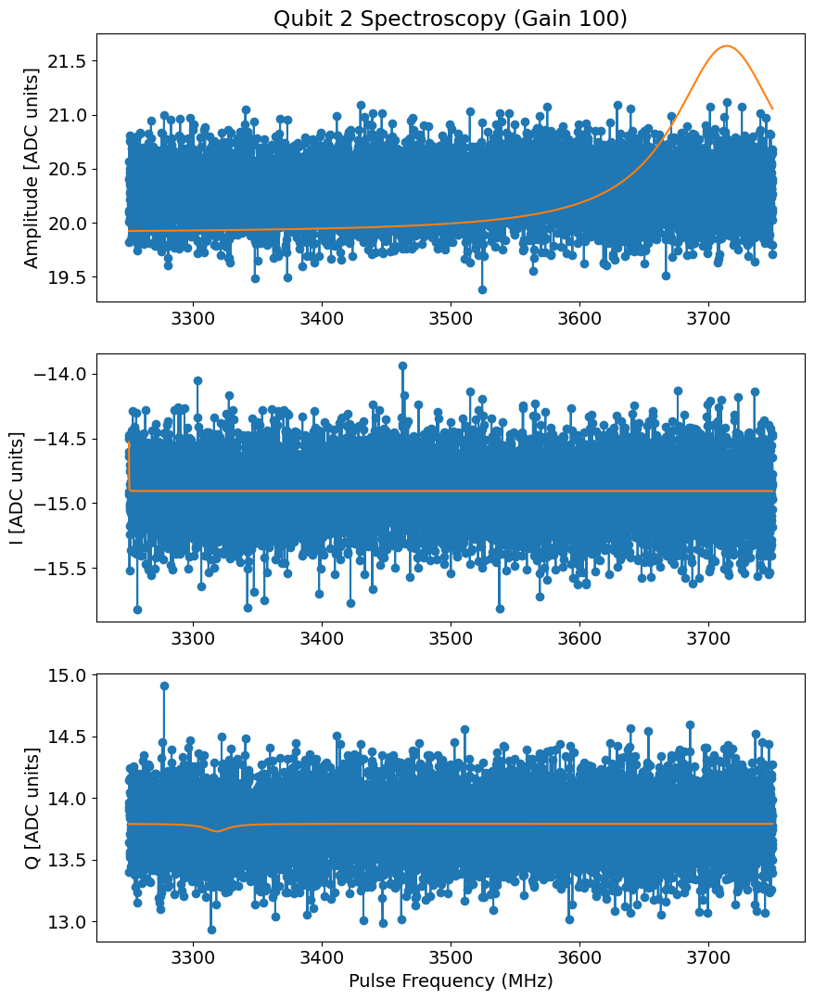

Running qubit spectroscopy for qubit 3


  0%|          | 0/20 [00:00<?, ?it/s]

Found peak in amps at [MHz] 3467.9733518564635, HWHM 4.221144680097811
Found peak in I at [MHz] 3297.4773623253855, HWHM 3.375091651692488
Found peak in Q at [MHz] 3467.652273170614, HWHM 6.5203301015087805


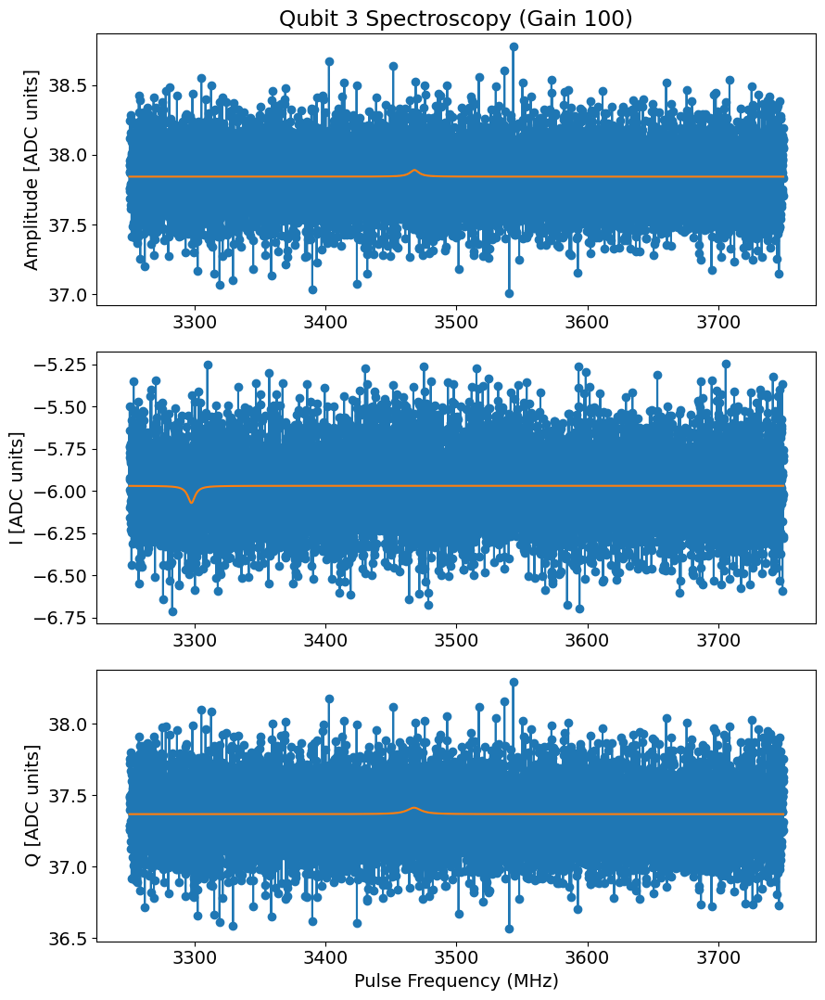

Running qubit spectroscopy for qubit 4


  0%|          | 0/20 [00:00<?, ?it/s]

Found peak in amps at [MHz] 3249.516764331327, HWHM -0.08735438246224105
Found peak in I at [MHz] 3405.077998260747, HWHM 6.316856489504553
Found peak in Q at [MHz] 3620.1167160529785, HWHM 24.941005225433386


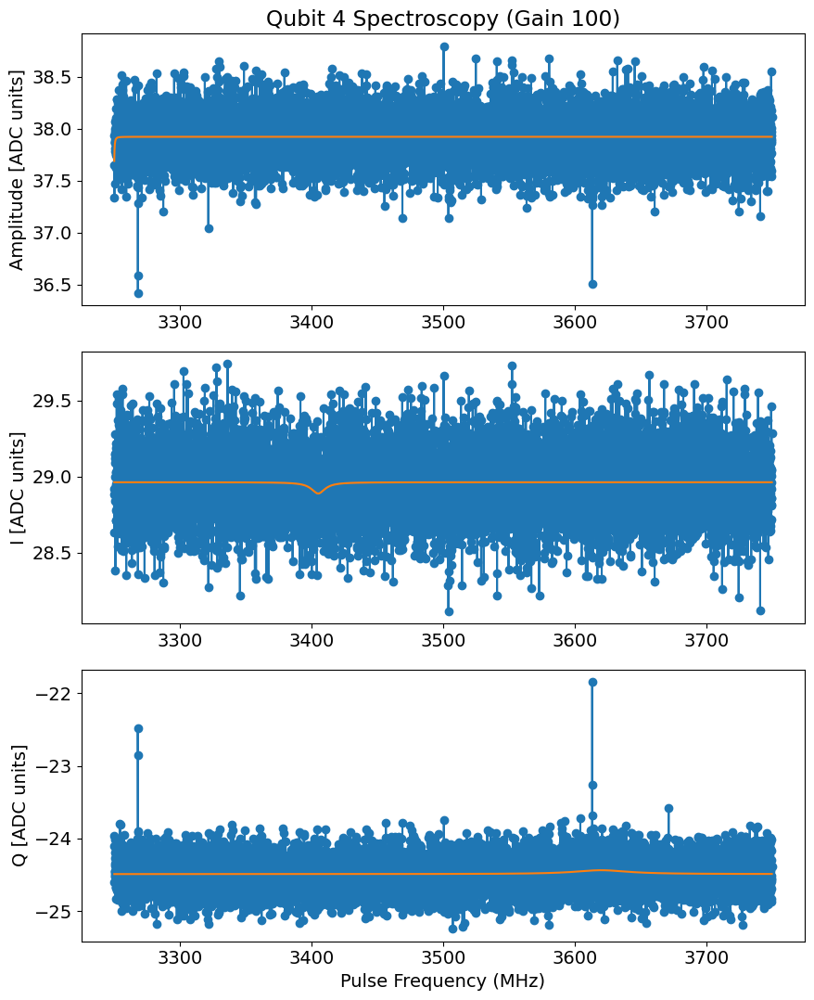

Running qubit spectroscopy for qubit 5


  0%|          | 0/20 [00:00<?, ?it/s]

Found peak in amps at [MHz] 3677.1524067547393, HWHM 133.656149870133
Found peak in I at [MHz] 3396.2550507926626, HWHM -4.164677681898333
Found peak in Q at [MHz] 3702.2069214817834, HWHM 93.72514097050097


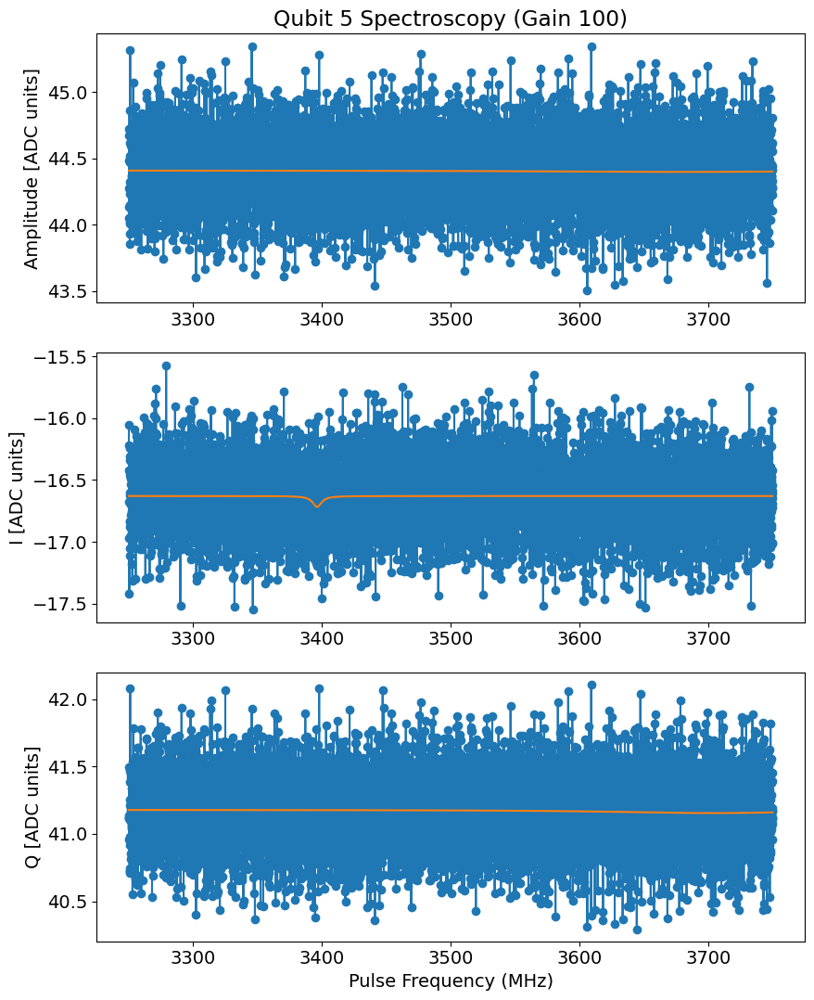

In [80]:
qspec_list = []
for k in range(num_qubits): 
# Qubit Spectroscopy
  qubit_i = k 
  print('Running qubit spectroscopy for qubit', qubit_i )
  qspec = meas.PulseProbeSpectroscopyExperiment(
      soccfg=soc,
      path = expt_path, 
      prefix = f"qubit_spectroscopy_qubit{qubit_i}",
      config_file=results_config_path,
      )

  span = 500 # MHz  
  npts = 8000

  qspec.cfg.expt = dict(
      # start= qspec.cfg.device.qubit.f_ge[qubit_i]-span/2, # qubit frequency to be mixed up [MHz]
      start = 3250,
      step = span/npts, # min step ~1 Hz
      expts = npts, # Number experiments stepping from start
      reps = 50, # Number averages per point
      rounds = 20, #Number of start to finish sweeps to average over 
      length = 50, # qubit probe constant pulse length [us]
      gain = 100, #qubit pulse gain  
      pulse_type = 'const', 
      #pulse_type = 'gauss',  
      qubit = qubit_i,
  ) 

  qspec.cfg.device.readout.relax_delay = 10 # Wait time between experiments [us]
  qspec.go(analyze=False, display=False, progress=True, save=False)

  qspec.analyze(fit=True, signs = [1,-1,1])
  qspec.display(fit=True, signs= [1, -1, 1])
  qspec_list.append(qspec.data["fit_amps"][2])

# # open the results config file 
#   with open(results_config_file,'r') as file:
#     auto_cfg=AttrDict(yaml.safe_load(file)) # turn it into an attribute dictionary 

#   # assign the qubit frequency to the results config file
#   auto_cfg.device.qubit.f_ge[qubit_i] = float(qspec.data["fit_amps"][2])
#   auto_cfg.device.qubit.kappa[qubit_i] = float(2*qspec.data["fit_amps"][3])
#   auto_cfg= yaml.safe_dump(auto_cfg.to_dict(), default_flow_style=  True) # dump it 

#   # write it: 
#   with open('autocalibration_cfg.yml', 'w') as modified_file:
#     modified_file.write(auto_cfg)
#   # now, open the modified file again 
#   with open('autocalibration_cfg.yml','r') as file:
#     auto_cfg=AttrDict(yaml.safe_load(file)) # turn it into an attribute dictionary 


#   print(f'*Set cfg qubit {qubit_i} freq to {auto_cfg.device.qubit.f_ge[qubit_i]} MHz*')
#   print(f'*Set cfg qubit {qubit_i} kappa to {auto_cfg.device.qubit.kappa[qubit_i]} MHz*')

In [6]:
import yaml

# Results config file:
results_config_file = 'test.yml'
results_config_path = os.getcwd() + '\\' + results_config_file
print('Results config will be', results_config_path)

# open the file 
with open(results_config_file,'r') as file:
  auto_cfg=AttrDict(yaml.safe_load(file)) # turn it into an attribute dictionary 


im = InstrumentManager(ns_address='192.168.137.1') # SLAC lab

soc = QickConfig(im[auto_cfg['aliases']['soc']].get_cfg())
print(soc)
print(auto_cfg['aliases']['soc'])
print(soc.description())





Results config will be c:\_Lib\python\rfsoc\elaine_rfsoc\slab_rfsoc_expts\test.yml

QICK configuration:

	Board: ZCU216

	Global clocks (MHz): tProcessor 430.080, RF reference 245.760

	7 signal generator channels:
	0:	axis_signal_gen_v4 - tProc output 1, envelope memory 65536 samples
		DAC tile 2, ch 0, 32-bit DDS, fabric=430.080 MHz, fs=6881.280 MHz
	1:	axis_signal_gen_v4 - tProc output 2, envelope memory 65536 samples
		DAC tile 2, ch 1, 32-bit DDS, fabric=430.080 MHz, fs=6881.280 MHz
	2:	axis_signal_gen_v4 - tProc output 3, envelope memory 65536 samples
		DAC tile 2, ch 2, 32-bit DDS, fabric=430.080 MHz, fs=6881.280 MHz
	3:	axis_signal_gen_v4 - tProc output 4, envelope memory 65536 samples
		DAC tile 2, ch 3, 32-bit DDS, fabric=430.080 MHz, fs=6881.280 MHz
	4:	axis_signal_gen_v4 - tProc output 5, envelope memory 65536 samples
		DAC tile 3, ch 0, 32-bit DDS, fabric=430.080 MHz, fs=6881.280 MHz
	5:	axis_signal_gen_v4 - tProc output 6, envelope memory 65536 samples
		DAC tile 3, ch 1,

In [7]:
meas.run_calibration(results_config_file, soc)


AttributeError: module 'experiments' has no attribute 'run_calibration'

# Autocalibration 

We have now completed the necessary steps to run the full autocalibration of the qubits. The code below will run xxx and save all results to <code>autocalibration_cfg.yml</code>

Running analysis for qubit:  0 ...


  0%|          | 0/500 [00:00<?, ?it/s]

From Fit:
	f0: 6993.017541494722
	kappa[MHz]: 27.56306654527437


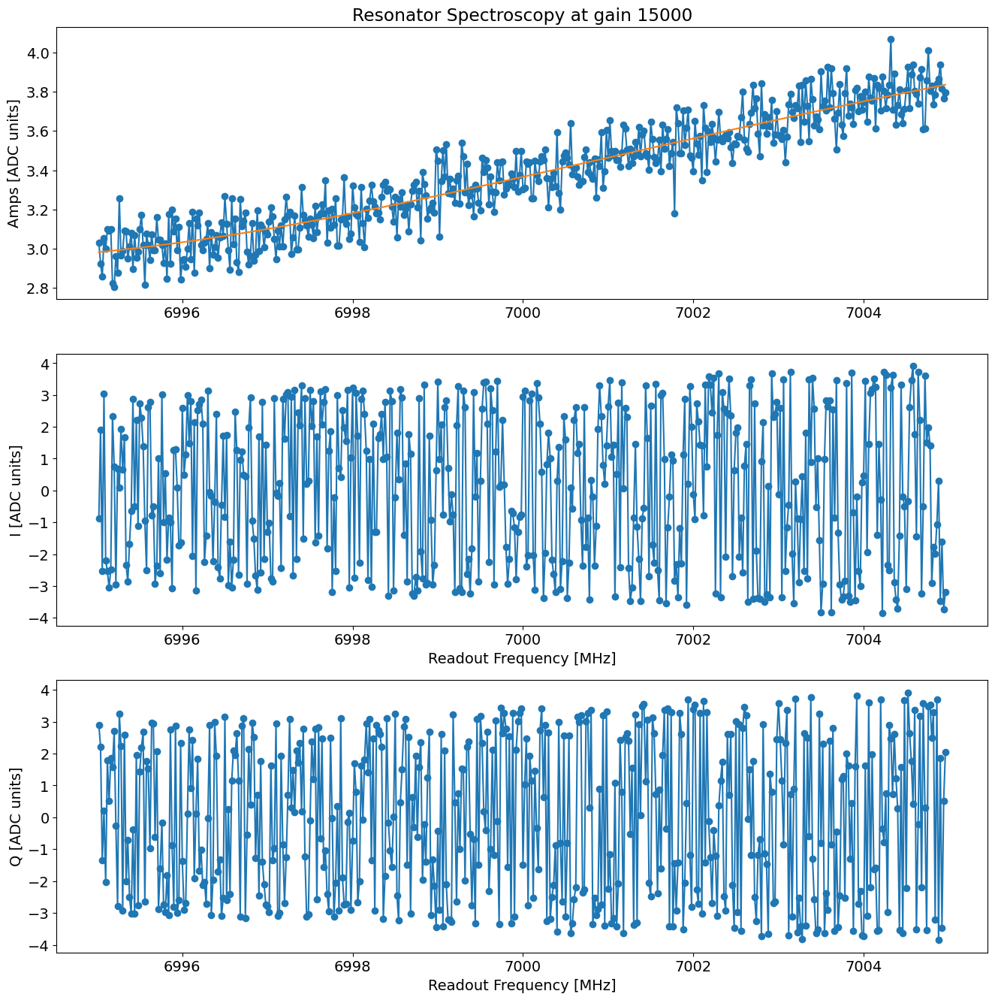

From Fit:
	f0: 6993.017541494722
	kappa[MHz]: 27.56306654527437
*Set cfg res 0 freq to 6993.017541494722*


  0%|          | 0/20 [00:00<?, ?it/s]

Found peak in amps at [MHz] 3000.0901120978174, HWHM 318.96107189303115
Found peak in I at [MHz] 3000.7871098275177, HWHM 0.9156561593192452
Found peak in Q at [MHz] 3000.408383186754, HWHM 278.41417919567346


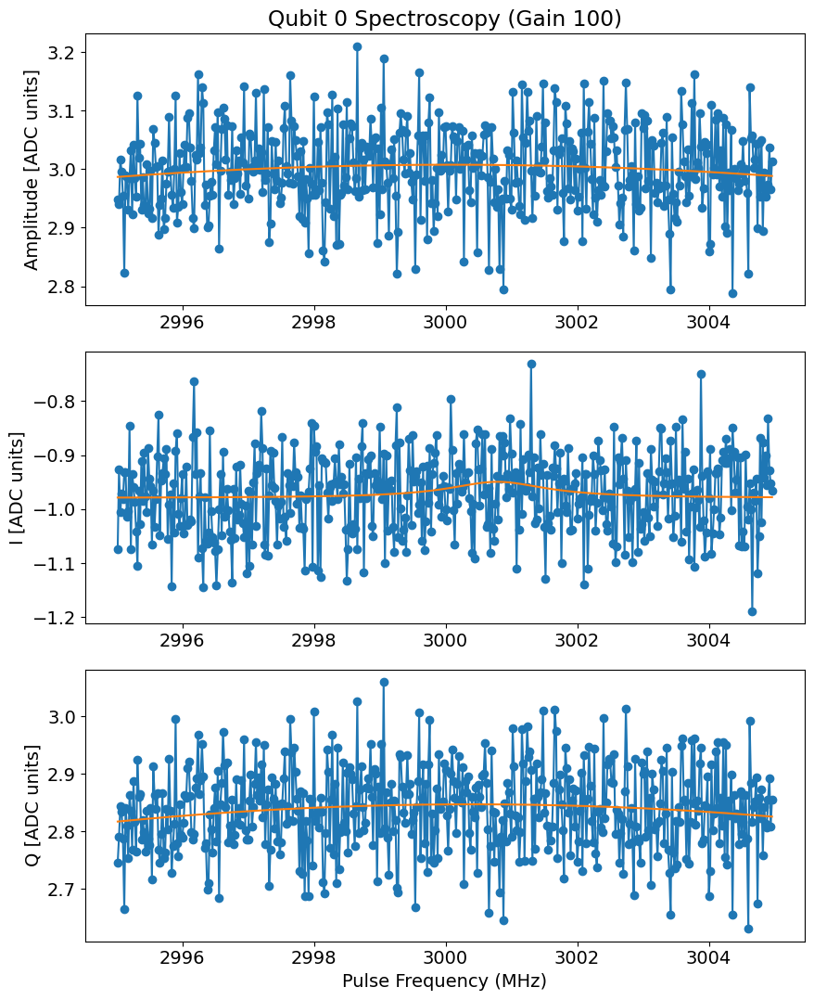

*Set cfg qubit 0 freq to 3000.0901120978174*


  0%|          | 0/100 [00:00<?, ?it/s]

Attempted to init fitparam 1 to 199.8351515151515, which is out of bounds 0.4388571428571429 to 65.82857142857142. Instead init to 33.133714285714284
Attempted to init fitparam 1 to 173.76969696969695, which is out of bounds 0.4388571428571429 to 65.82857142857142. Instead init to 33.133714285714284
Attempted to init fitparam 1 to 182.4581818181818, which is out of bounds 0.4388571428571429 to 65.82857142857142. Instead init to 33.133714285714284
Decay from avgi [us] 0.06835937500000001
Pi length from avgi data [us]: 0.008135723160141876
	Pi/2 length from avgi data [us]: 0.004067861580070938

Decay from avgq [us] 0.06835937500000001
Pi length from avgq data [us]: 0.012173581729238851
Pi/2 length from avgq data [us]: 0.0060867908646194254


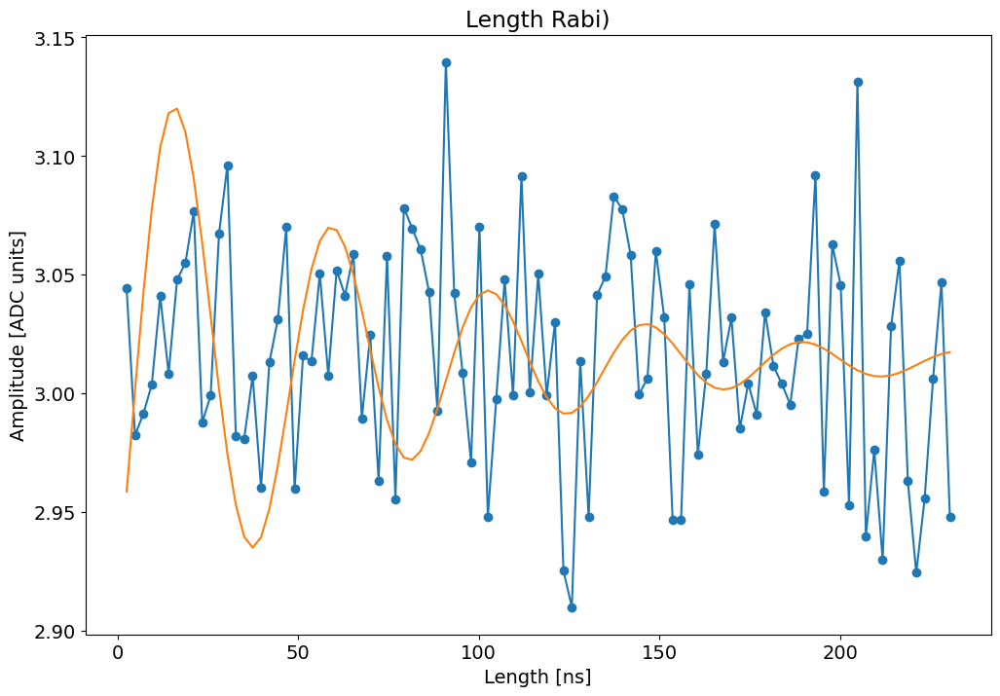

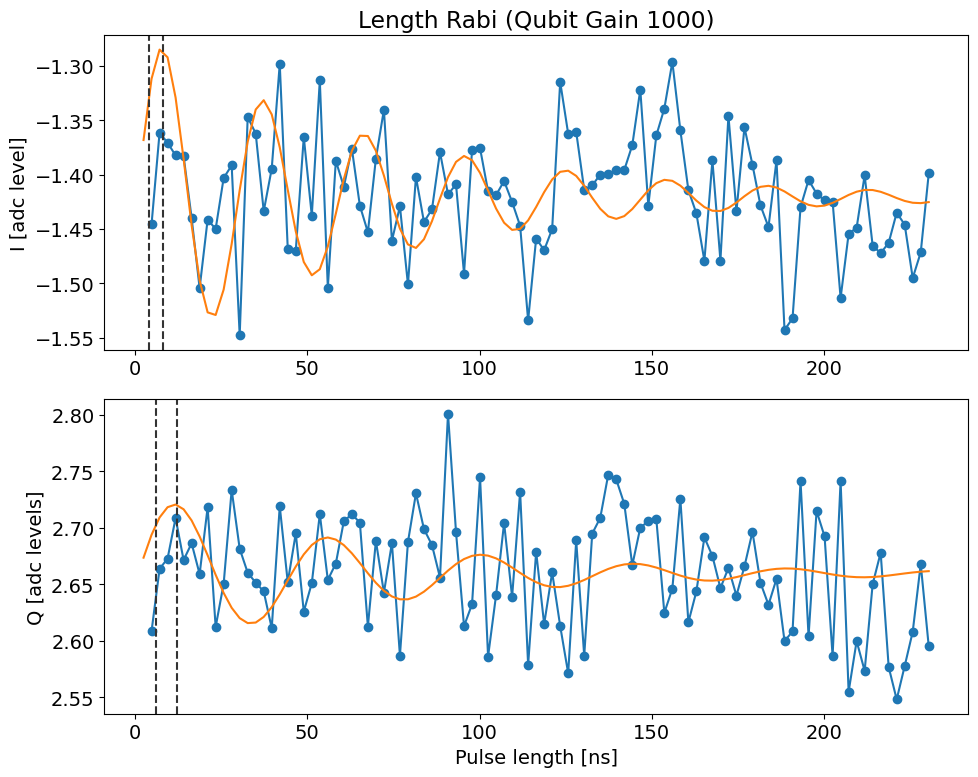

*Set cfg qubit 0 rabi length to 0.008135723160141876* us
qTest =  0.008135723160141876
gauss


  0%|          | 0/200000 [00:00<?, ?it/s]

Attempted to init fitparam 1 to 0.02747068676716918, which is out of bounds 3.3670033670033675e-05 to 0.003367003367003367. Instead init to 0.0017003367003367003
Attempted to init fitparam 1 to 0.02479061976549414, which is out of bounds 3.3670033670033675e-05 to 0.003367003367003367. Instead init to 0.0017003367003367003
Attempted to init fitparam 1 to 0.02479061976549414, which is out of bounds 3.3670033670033675e-05 to 0.003367003367003367. Instead init to 0.0017003367003367003
Pi gain from amps data [dac units]: 306
	Pi/2 gain from amps data [dac units]: 153
Pi gain from avgi data [dac units]: 289
	Pi/2 gain from avgi data [dac units]: 144
Pi gain from avgq data [dac units]: 294
	Pi/2 gain from avgq data [dac units]: 147


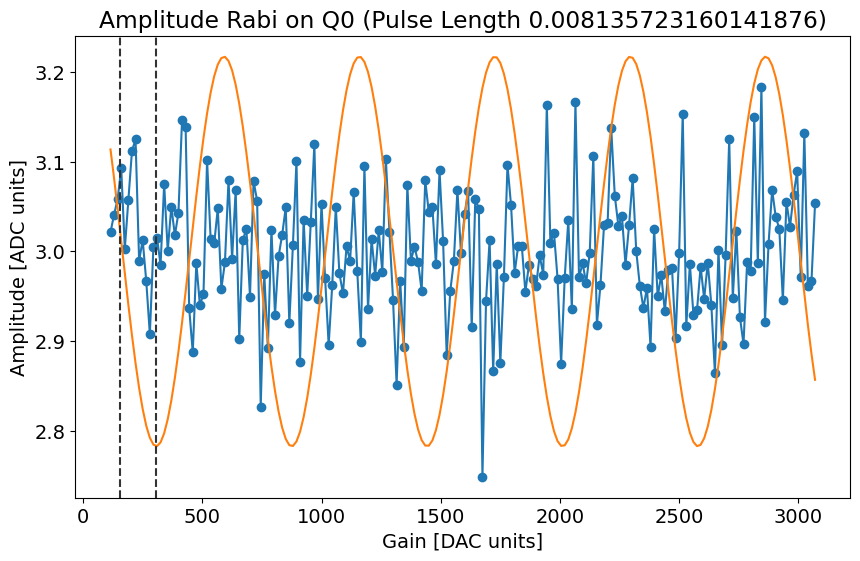

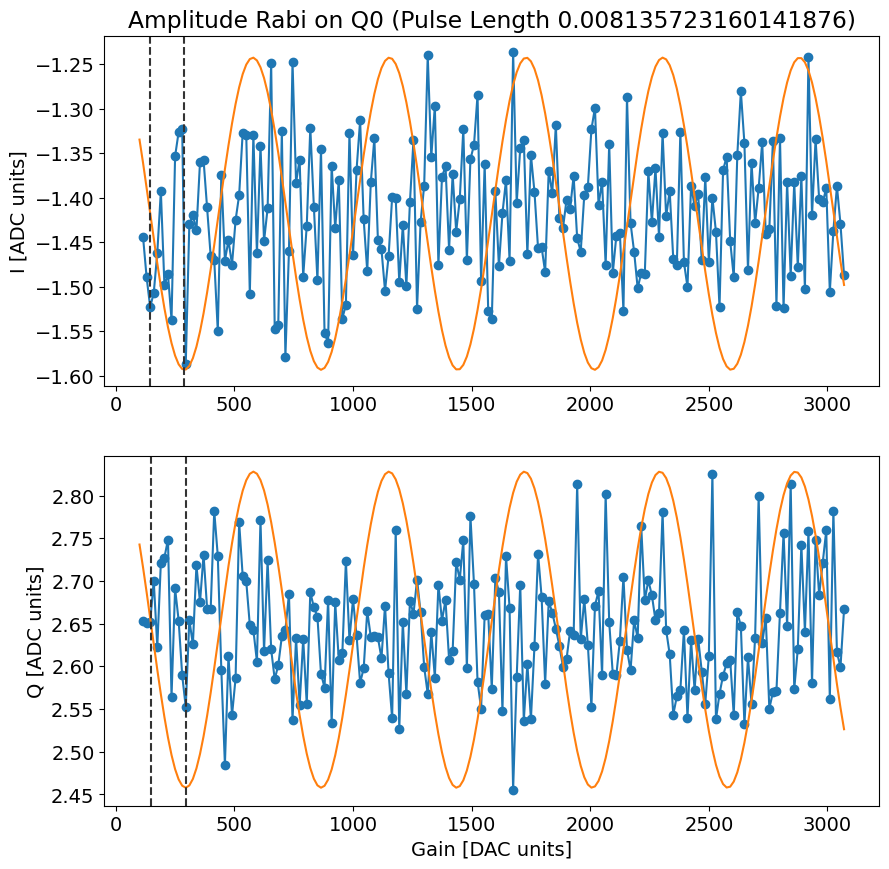

*Set cfg qubit 0 rabi amplitude to 289* DAC units


  0%|          | 0/60000 [00:00<?, ?it/s]

Attempted to init fitparam 1 to 0.2408026755852843, which is out of bounds 0.0006711409395973155 to 0.10067114093959731. Instead init to 0.05067114093959731
Attempted to init fitparam 1 to 0.1471571906354515, which is out of bounds 0.0006711409395973155 to 0.10067114093959731. Instead init to 0.05067114093959731
Attempted to init fitparam 1 to 0.7357859531772575, which is out of bounds 0.0006711409395973155 to 0.10067114093959731. Instead init to 0.05067114093959731
Current pi pulse frequency: 3000.0901120978174
Fit frequency from amps [MHz]: 0.02760679953528191 +/- 0.00132621020892267
Suggested new pi pulse frequencies from fit amps [MHz]:
 	3002.0625052982823
 	2998.0625052982823
T2 Ramsey from fit amps [us]: 44.7
Current pi pulse frequency: 3000.0901120978174
Fit frequency from I [MHz]: 0.05521447422243496 +/- 0.0006227687581611504
Suggested new pi pulse frequency from fit I [MHz]:
 	3002.034897623595
 	2998.034897623595
T2 Ramsey from fit I [us]: 44.7
Fit frequency from Q [MHz]: 0.

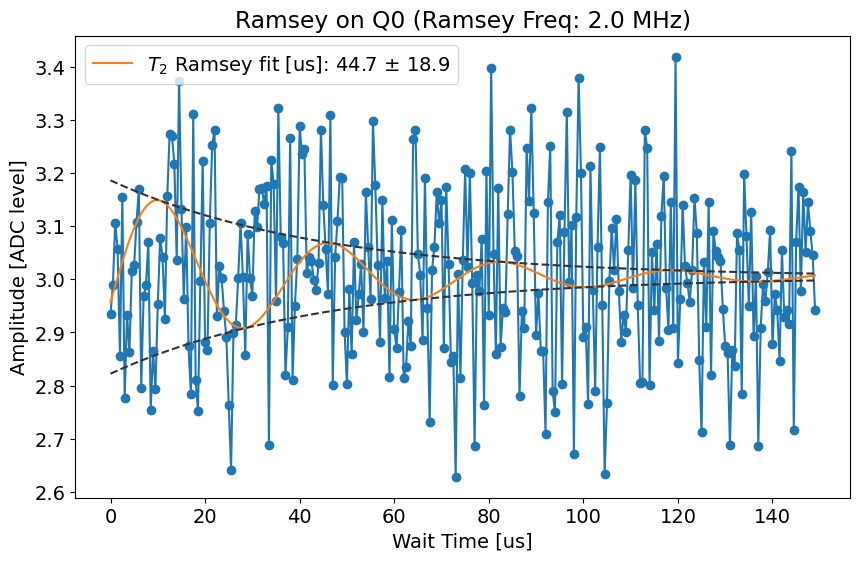

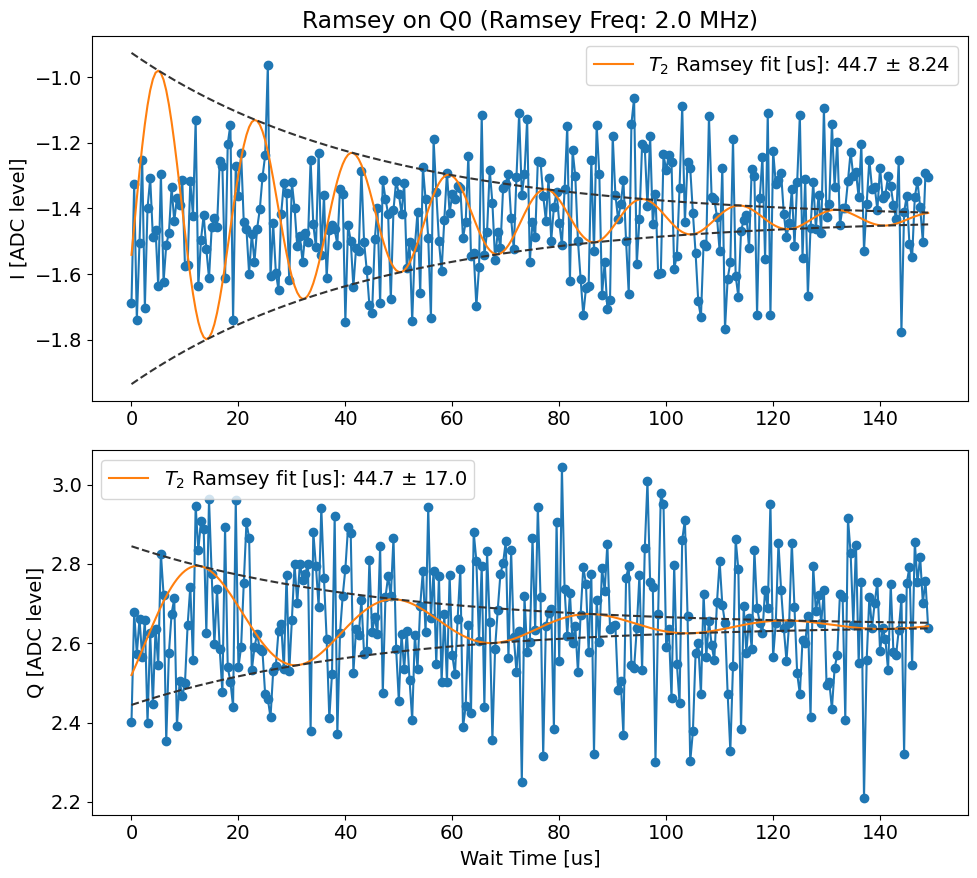

Replacing 3000.0901120978174 with 2998.034897623595 in results cfg file
qTest =  0.008135723160141876
gauss


  0%|          | 0/200000 [00:00<?, ?it/s]

Attempted to init fitparam 1 to 0.030485762144053602, which is out of bounds 3.3670033670033675e-05 to 0.003367003367003367. Instead init to 0.0017003367003367003
Attempted to init fitparam 1 to 0.012730318257956449, which is out of bounds 3.3670033670033675e-05 to 0.003367003367003367. Instead init to 0.0017003367003367003
Pi gain from amps data [dac units]: 318
	Pi/2 gain from amps data [dac units]: 159
Pi gain from avgi data [dac units]: 18710
	Pi/2 gain from avgi data [dac units]: 9355
Pi gain from avgq data [dac units]: 296
	Pi/2 gain from avgq data [dac units]: 148


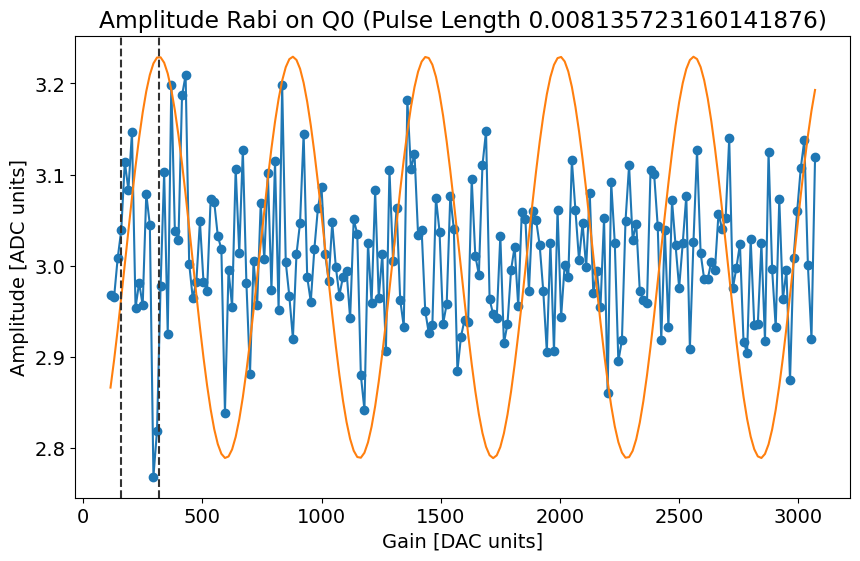

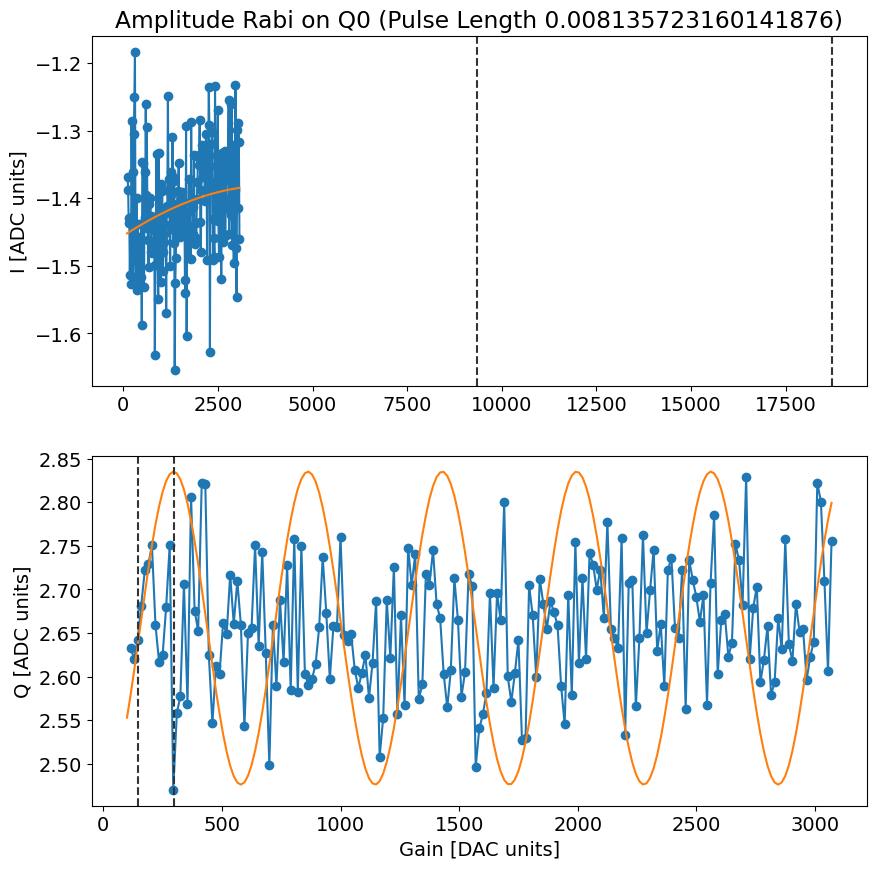

*Set cfg qubit 0 rabi amplitude to 18710* DAC units


  0%|          | 0/200000 [00:00<?, ?it/s]

c:\_Lib\python\rfsoc\elaine_rfsoc\slab_rfsoc_expts\experiments\fitting.py:65: RuntimeWarning: overflow encountered in exp
  return y0 + yscale*np.exp(-(x-x0)/decay)


Fit T1 avgi [us]: 134198.74720820188
Fit T1 avgq [us]: 60.160408292092164


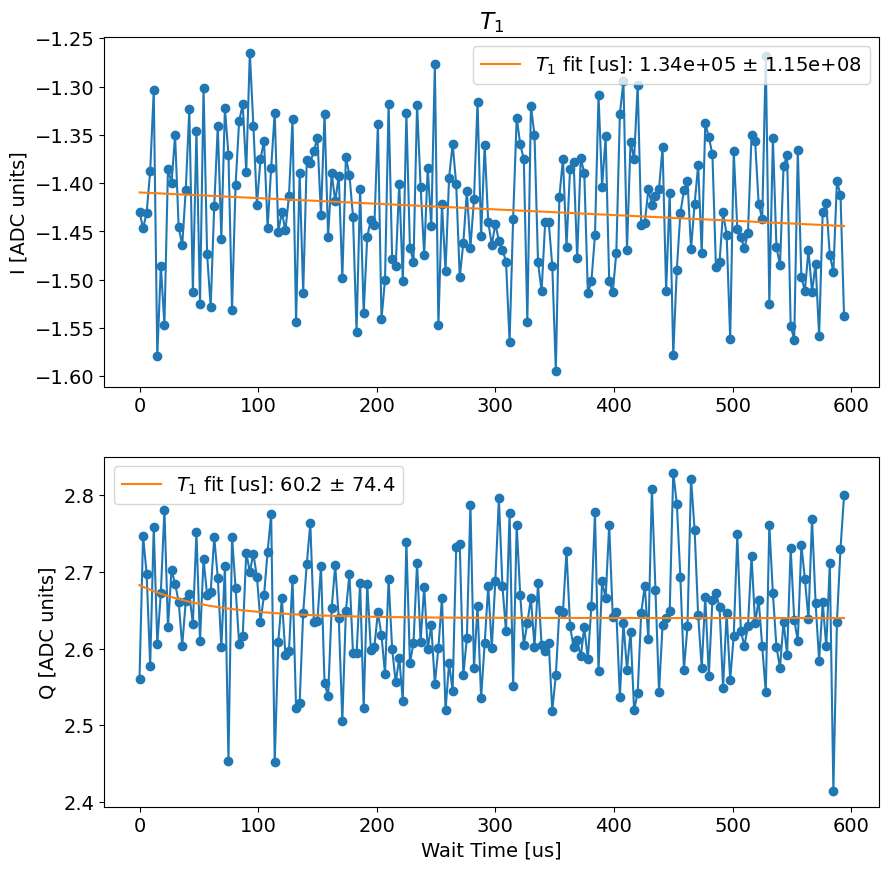

t1_i error:fit ratio= 858.1642484482169
t1_q error:fit ratio= 1.2372965660294448
t1_q is better, saving t1_q to results cfg file
*Set cfg qubit 0 T1 to 60.160408292092164* us
Running analysis for qubit:  1 ...


  0%|          | 0/500 [00:00<?, ?it/s]

From Fit:
	f0: 6990.345550412253
	kappa[MHz]: 48.65613774555949


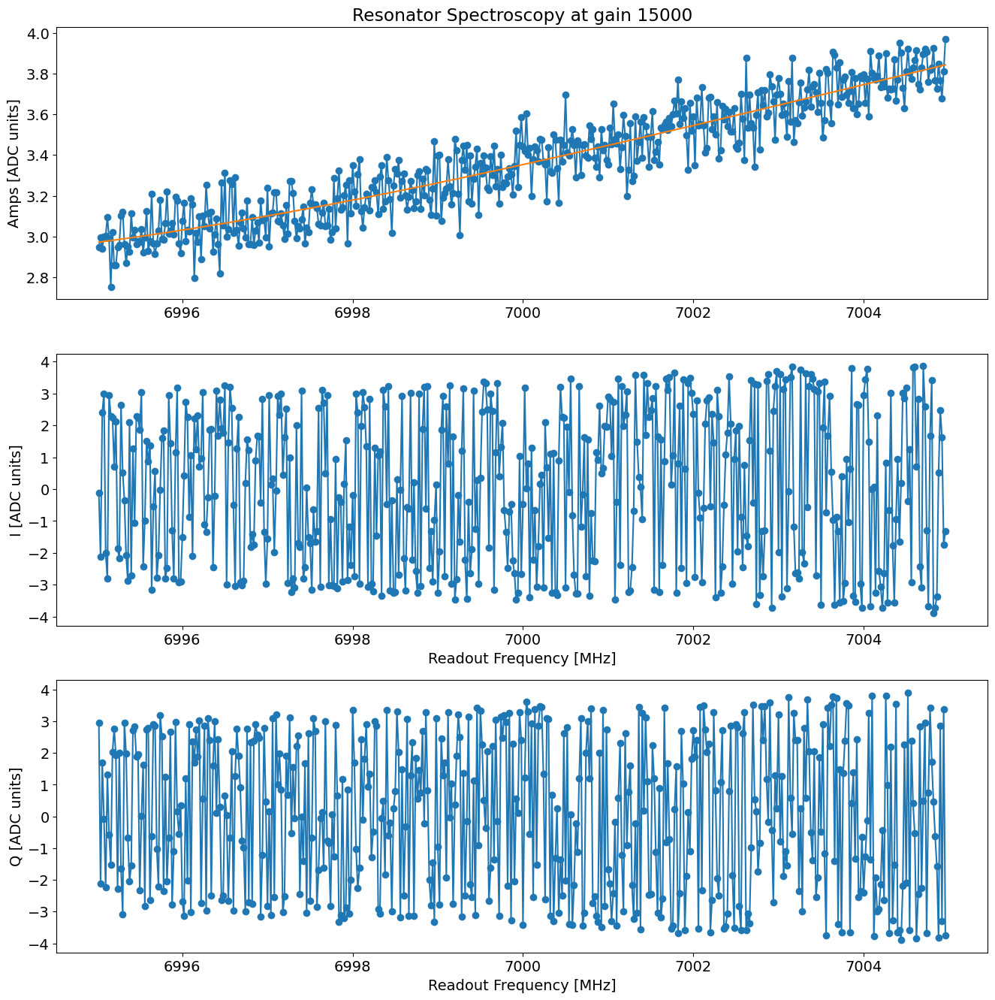

From Fit:
	f0: 6990.345550412253
	kappa[MHz]: 48.65613774555949
*Set cfg res 1 freq to 6990.345550412253*


  0%|          | 0/20 [00:00<?, ?it/s]

Found peak in amps at [MHz] 3001.7119158814457, HWHM 0.29182368781345697
Found peak in I at [MHz] 3004.4494940600307, HWHM 0.00027850884186052244
Found peak in Q at [MHz] 2999.29882199026, HWHM -0.009968789045950374


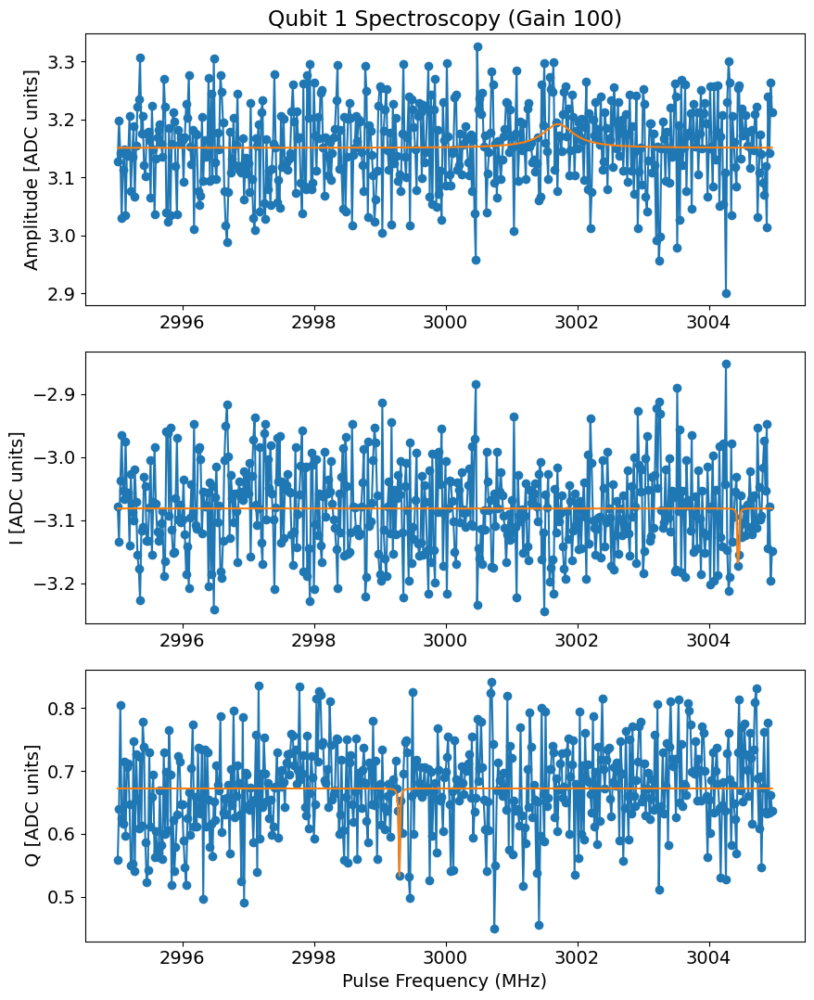

*Set cfg qubit 1 freq to 3001.7119158814457*


  0%|          | 0/100 [00:00<?, ?it/s]

Attempted to init fitparam 1 to 104.26181818181817, which is out of bounds 0.4388571428571429 to 65.82857142857142. Instead init to 33.133714285714284
Attempted to init fitparam 1 to 117.29454545454544, which is out of bounds 0.4388571428571429 to 65.82857142857142. Instead init to 33.133714285714284
Decay from avgi [us] 0.06835937500000001
Pi length from avgi data [us]: 0.00940918884798137
	Pi/2 length from avgi data [us]: 0.004704594423990685

Decay from avgq [us] 3.2749483572508087
Pi length from avgq data [us]: 0.5721808547192436
Pi/2 length from avgq data [us]: 0.2860904273596218


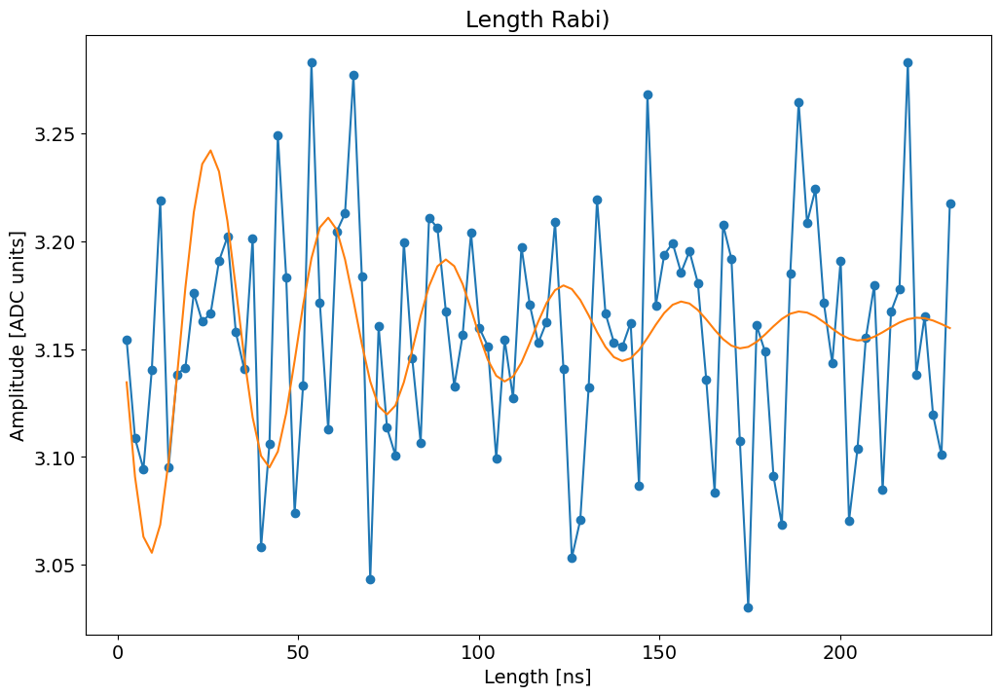

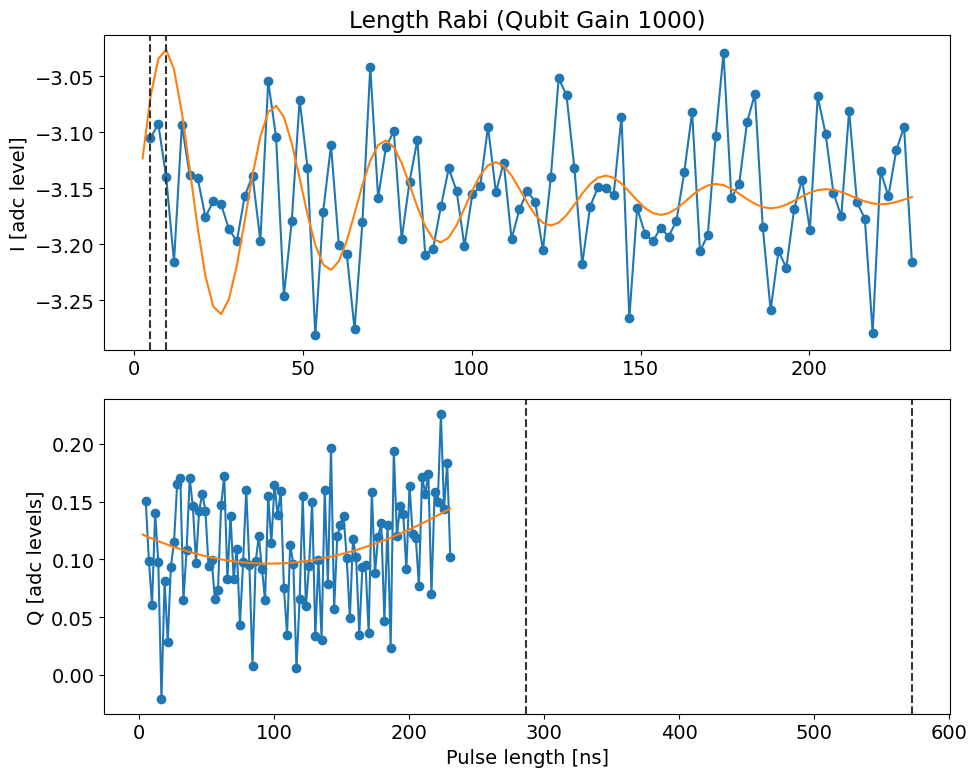

*Set cfg qubit 1 rabi length to 0.00940918884798137* us
qTest =  0.00940918884798137
gauss


  0%|          | 0/200000 [00:00<?, ?it/s]

Attempted to init fitparam 1 to 0.032160804020100506, which is out of bounds 3.3670033670033675e-05 to 0.003367003367003367. Instead init to 0.0017003367003367003
Attempted to init fitparam 1 to 0.006030150753768845, which is out of bounds 3.3670033670033675e-05 to 0.003367003367003367. Instead init to 0.0017003367003367003
Attempted to init fitparam 1 to 0.032160804020100506, which is out of bounds 3.3670033670033675e-05 to 0.003367003367003367. Instead init to 0.0017003367003367003
Pi gain from amps data [dac units]: 312
	Pi/2 gain from amps data [dac units]: 156
Pi gain from avgi data [dac units]: 284
	Pi/2 gain from avgi data [dac units]: 142
Pi gain from avgq data [dac units]: 345
	Pi/2 gain from avgq data [dac units]: 172


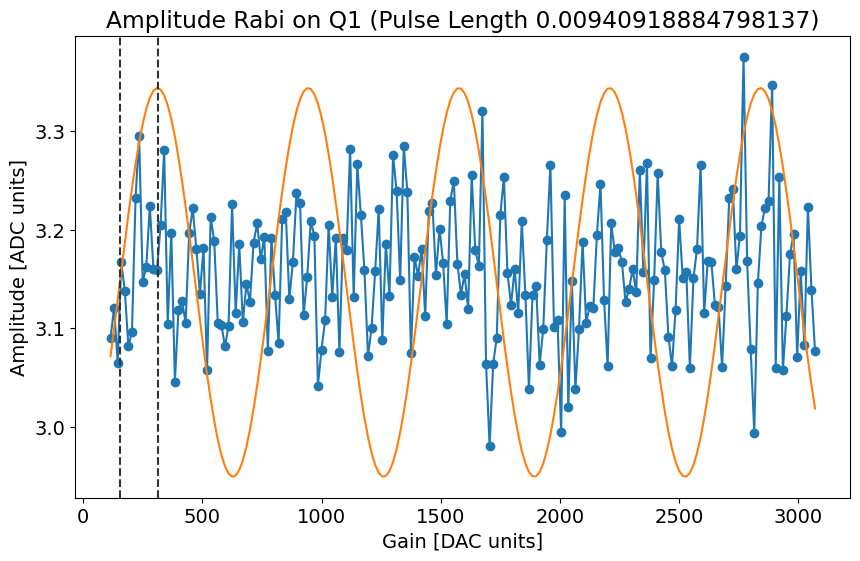

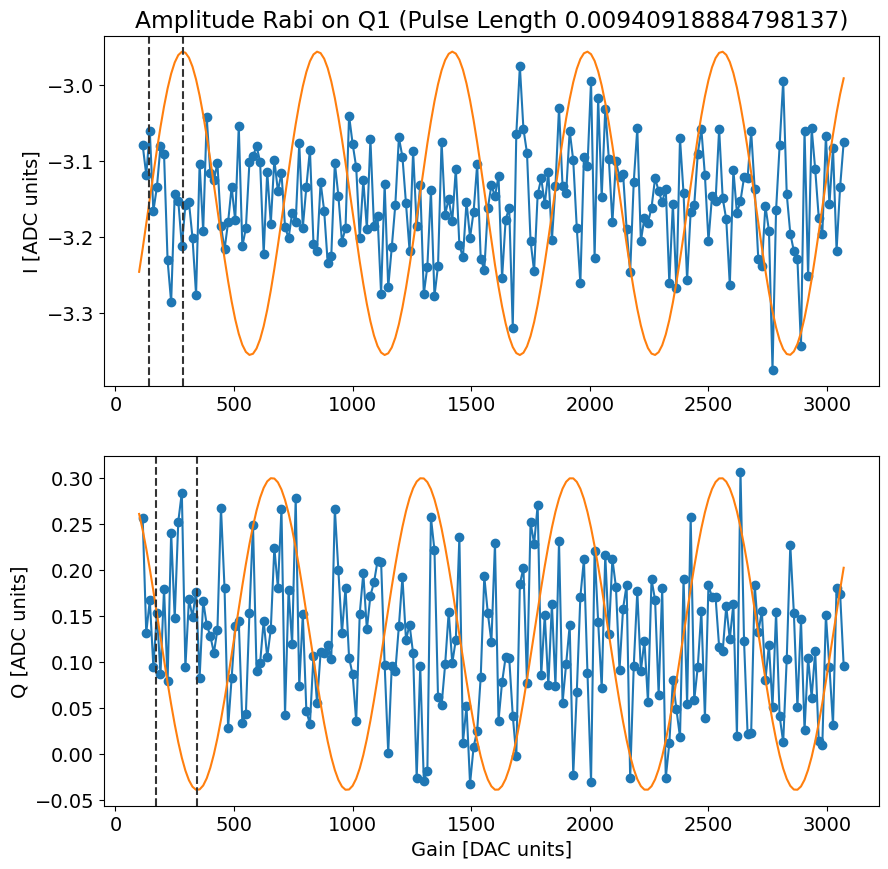

*Set cfg qubit 1 rabi amplitude to 284* DAC units


  0%|          | 0/60000 [00:00<?, ?it/s]

Attempted to init fitparam 1 to 0.24749163879598662, which is out of bounds 0.0006711409395973155 to 0.10067114093959731. Instead init to 0.05067114093959731
Attempted to init fitparam 1 to 0.13377926421404682, which is out of bounds 0.0006711409395973155 to 0.10067114093959731. Instead init to 0.05067114093959731
Current pi pulse frequency: 3001.7119158814457
Fit frequency from amps [MHz]: 0.014500324505711202 +/- 0.0034865736249678194
Suggested new pi pulse frequencies from fit amps [MHz]:
 	3003.69741555694
 	2999.69741555694
T2 Ramsey from fit amps [us]: 44.7
Current pi pulse frequency: 3001.7119158814457
Fit frequency from I [MHz]: 0.08600842203735282 +/- 0.0005856817379705213
Suggested new pi pulse frequency from fit I [MHz]:
 	3003.6259074594086
 	2999.6259074594086
T2 Ramsey from fit I [us]: 44.7
Fit frequency from Q [MHz]: 0.04757118833492114 +/- 0.0005762822050696129
Suggested new pi pulse frequencies from fit Q [MHz]:
 	3003.6643446931107
 	2999.6643446931107
T2 Ramsey from 

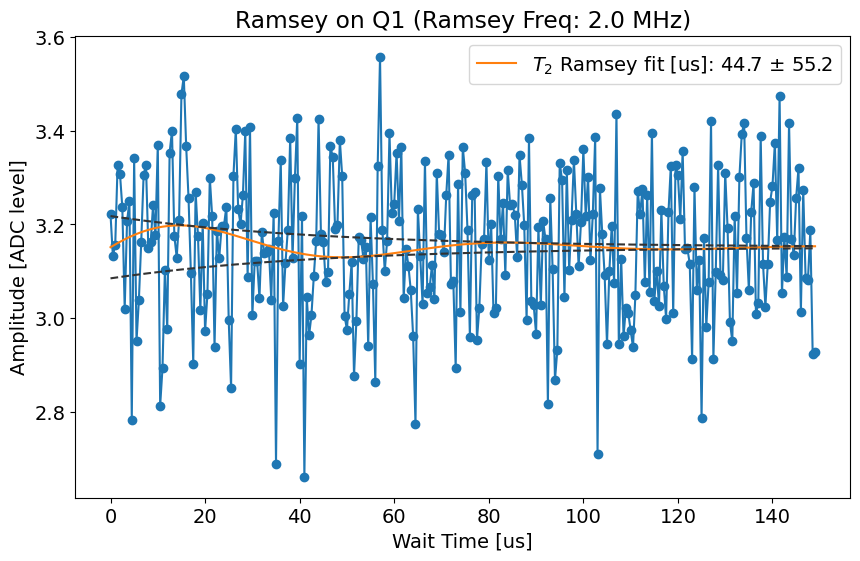

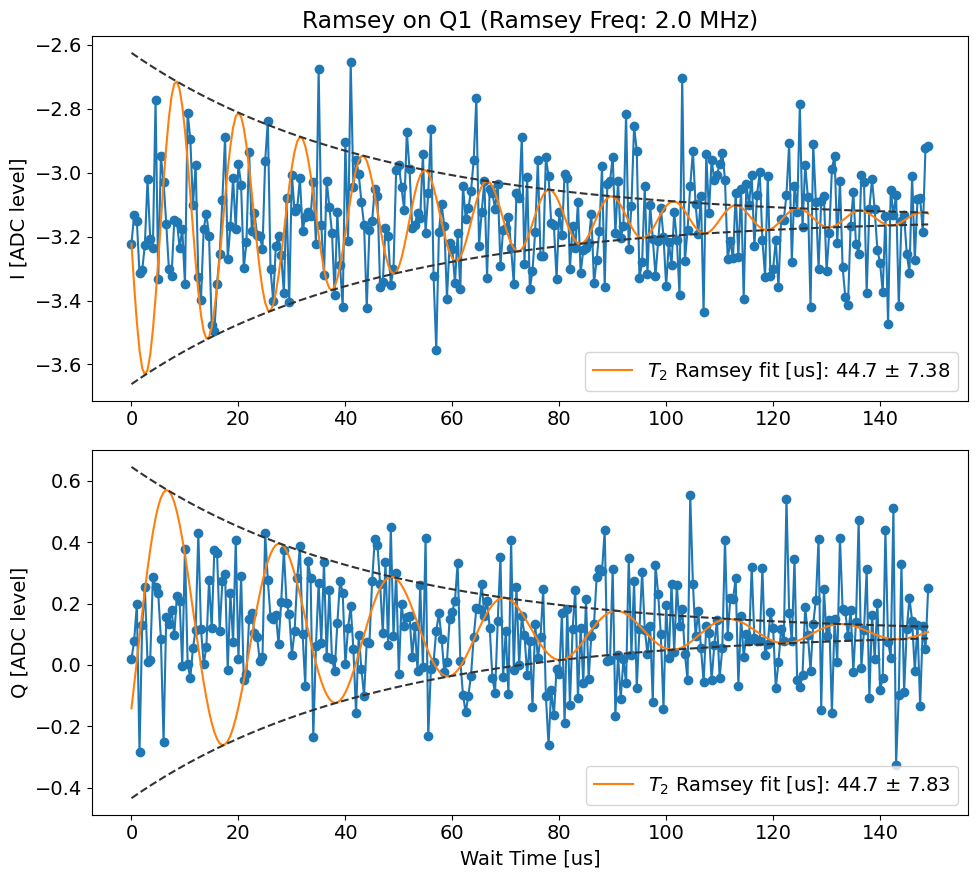

Replacing 3001.7119158814457 with 2999.6259074594086 in results cfg file
qTest =  0.00940918884798137
gauss


  0%|          | 0/200000 [00:00<?, ?it/s]

Pi gain from amps data [dac units]: 289
	Pi/2 gain from amps data [dac units]: 144
Pi gain from avgi data [dac units]: 289
	Pi/2 gain from avgi data [dac units]: 144
Pi gain from avgq data [dac units]: 361
	Pi/2 gain from avgq data [dac units]: 180


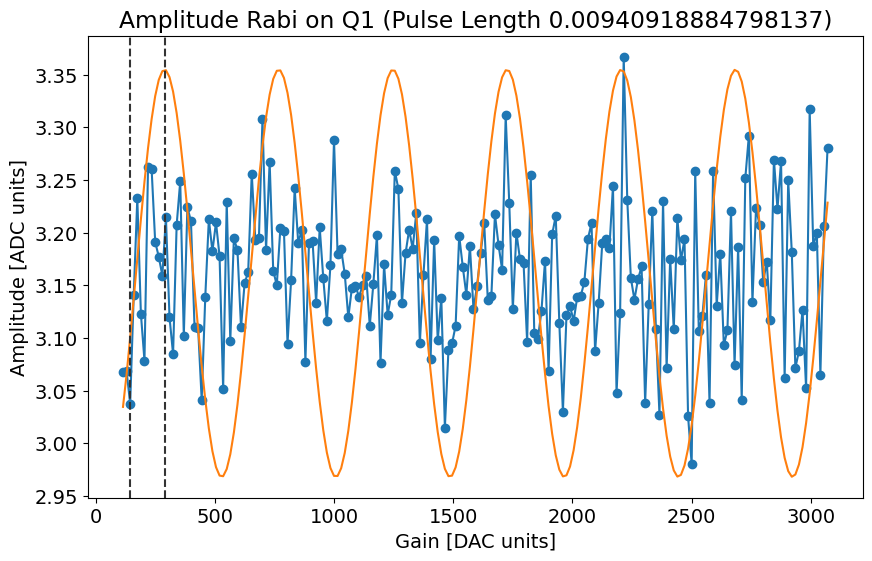

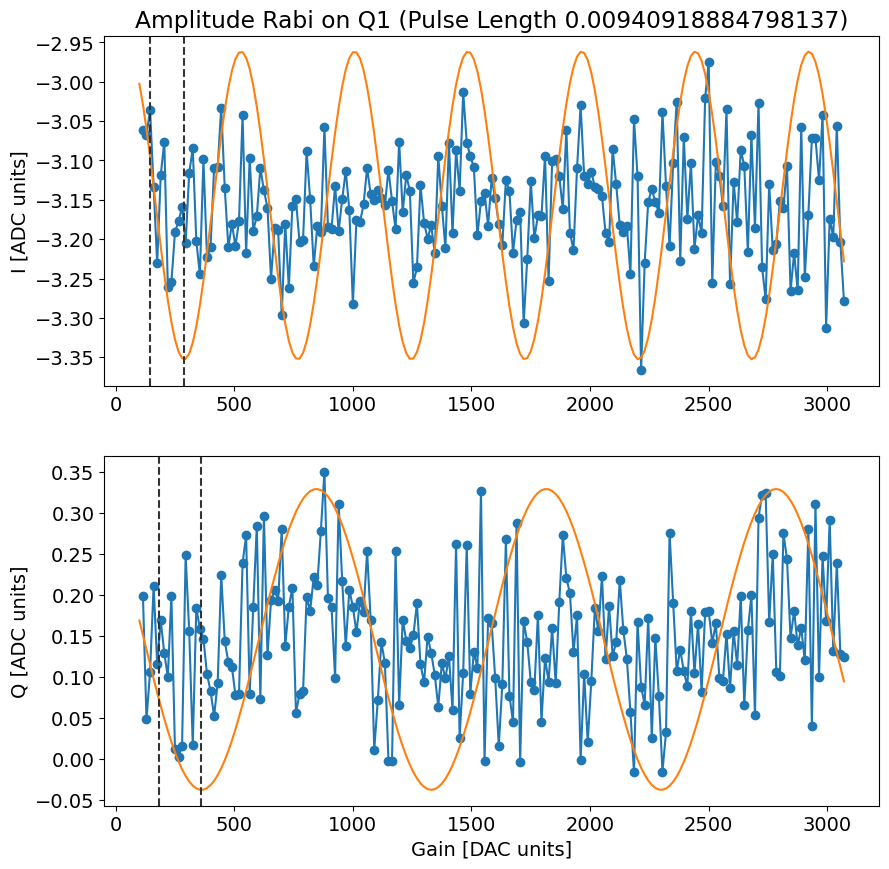

*Set cfg qubit 1 rabi amplitude to 289* DAC units


  0%|          | 0/200000 [00:00<?, ?it/s]

c:\Users\slab\anaconda3\envs\slab\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


Fit T1 avgi [us]: 15.207138442378566
Fit T1 avgq [us]: 96.3810433511827


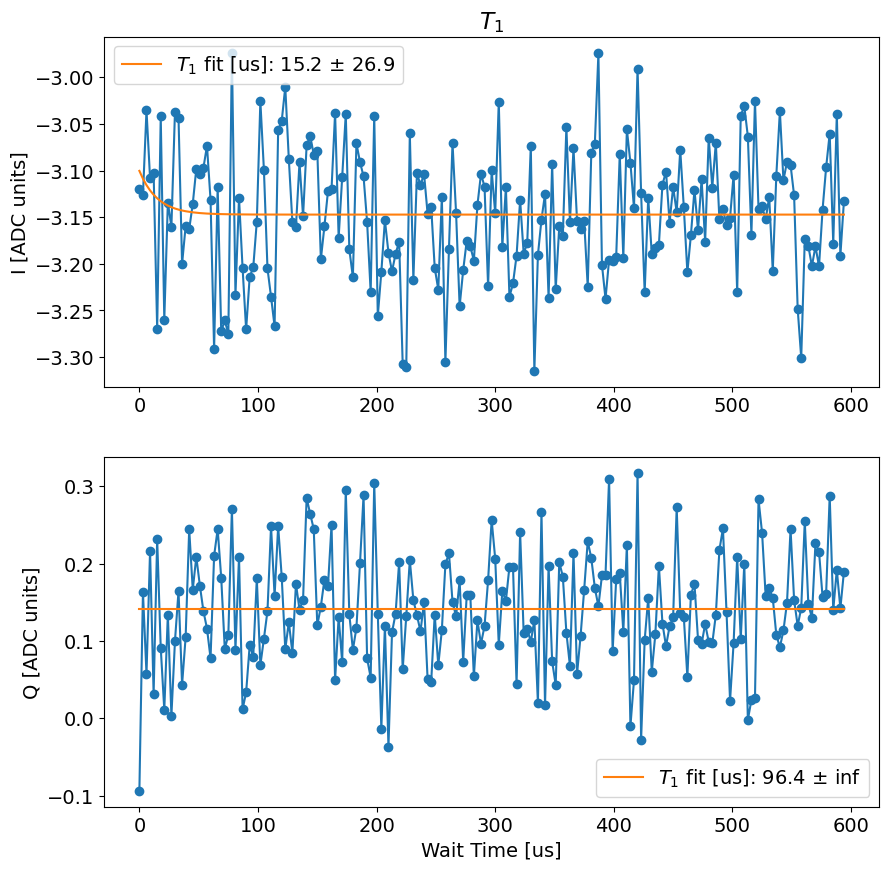

t1_i error:fit ratio= 1.7672438693535408
t1_q error:fit ratio= inf
t1_i is better, saving T1_i to results cfg file
*Set cfg qubit 1 T1 to 15.207138442378566* us
Running analysis for qubit:  2 ...


  0%|          | 0/500 [00:00<?, ?it/s]

From Fit:
	f0: 6993.114531518331
	kappa[MHz]: 26.536884870744515


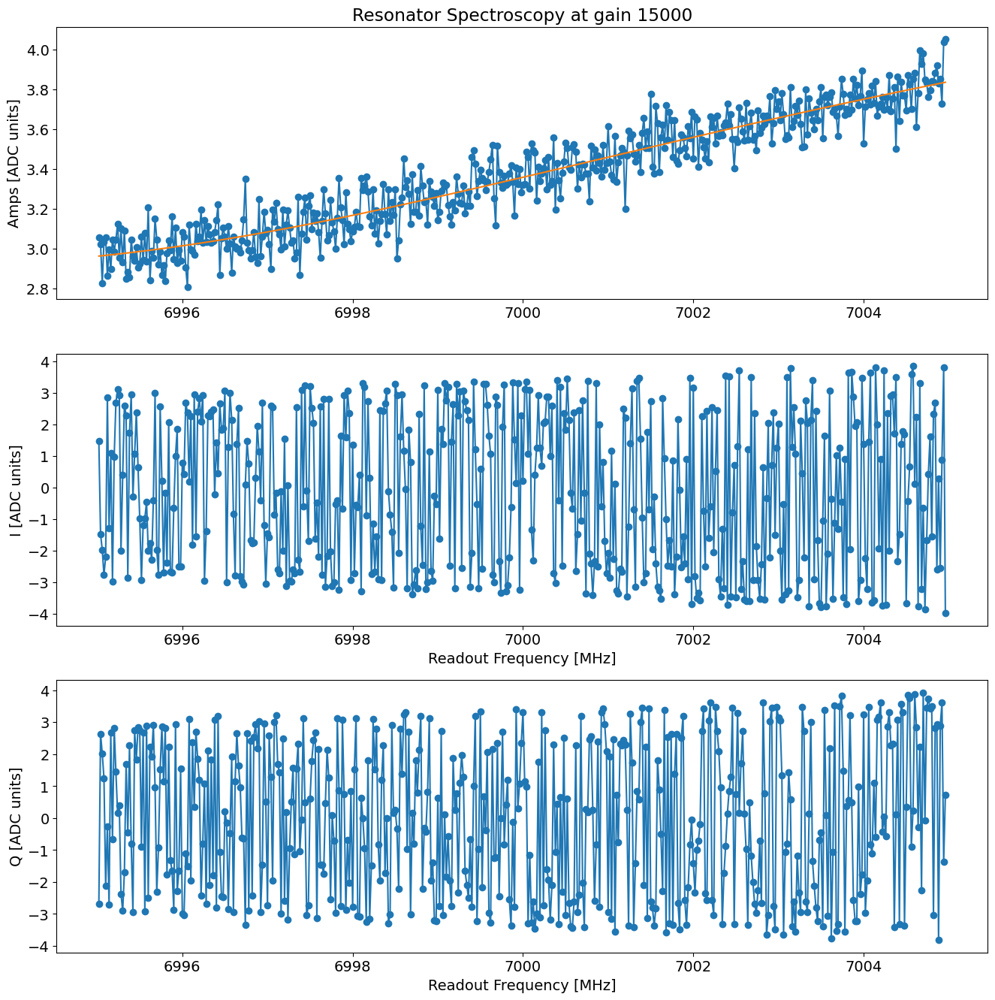

From Fit:
	f0: 6993.114531518331
	kappa[MHz]: 26.536884870744515
*Set cfg res 2 freq to 6993.114531518331*


  0%|          | 0/20 [00:00<?, ?it/s]

Found peak in amps at [MHz] 2995.74, HWHM 0.9940000000000054
Found peak in I at [MHz] 3001.143926294955, HWHM -0.06004761880026496
Found peak in Q at [MHz] 2998.898941807973, HWHM 0.013238789297263924


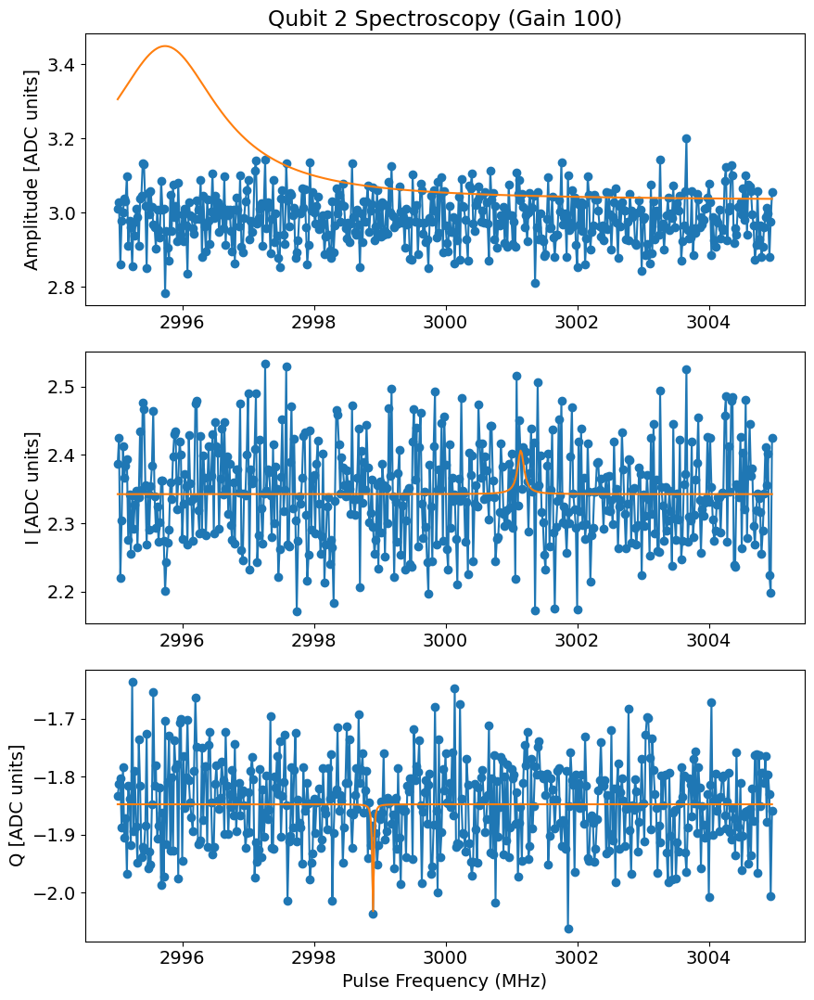

*Set cfg qubit 2 freq to 2995.74*


  0%|          | 0/100 [00:00<?, ?it/s]

Attempted to init fitparam 1 to 108.6060606060606, which is out of bounds 0.4388571428571429 to 65.82857142857142. Instead init to 33.133714285714284
Attempted to init fitparam 1 to 95.57333333333332, which is out of bounds 0.4388571428571429 to 65.82857142857142. Instead init to 33.133714285714284
Attempted to init fitparam 1 to 117.29454545454544, which is out of bounds 0.4388571428571429 to 65.82857142857142. Instead init to 33.133714285714284
Decay from avgi [us] 0.06835937500000001
Pi length from avgi data [us]: 0.016277568004732176
	Pi/2 length from avgi data [us]: 0.008138784002366088

Decay from avgq [us] 0.06835937500000001
Pi length from avgq data [us]: 0.013766971676777635
Pi/2 length from avgq data [us]: 0.0068834858383888175


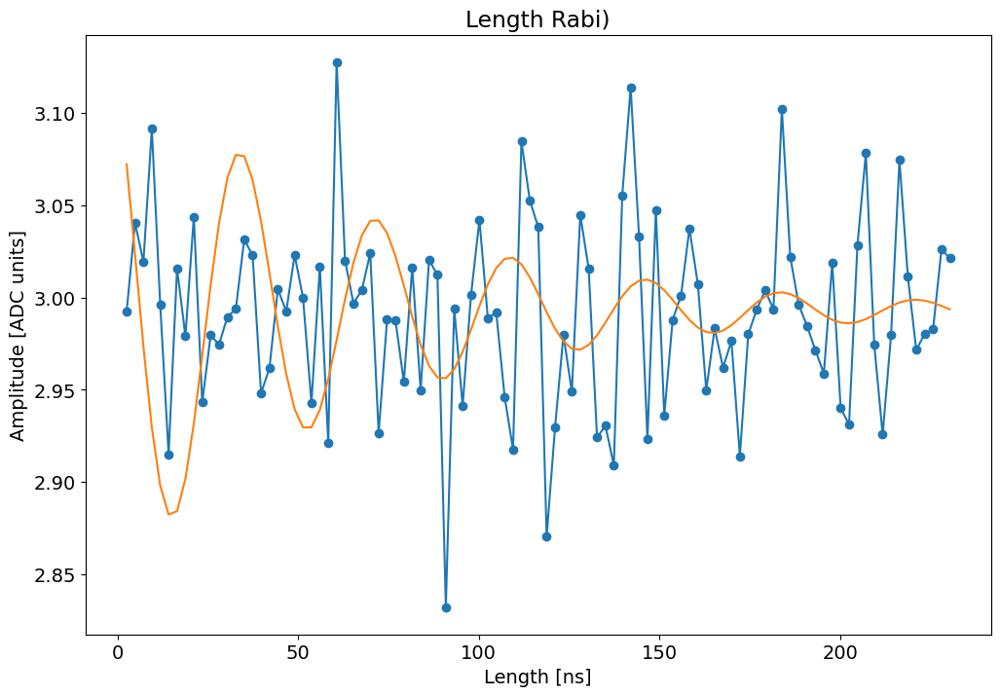

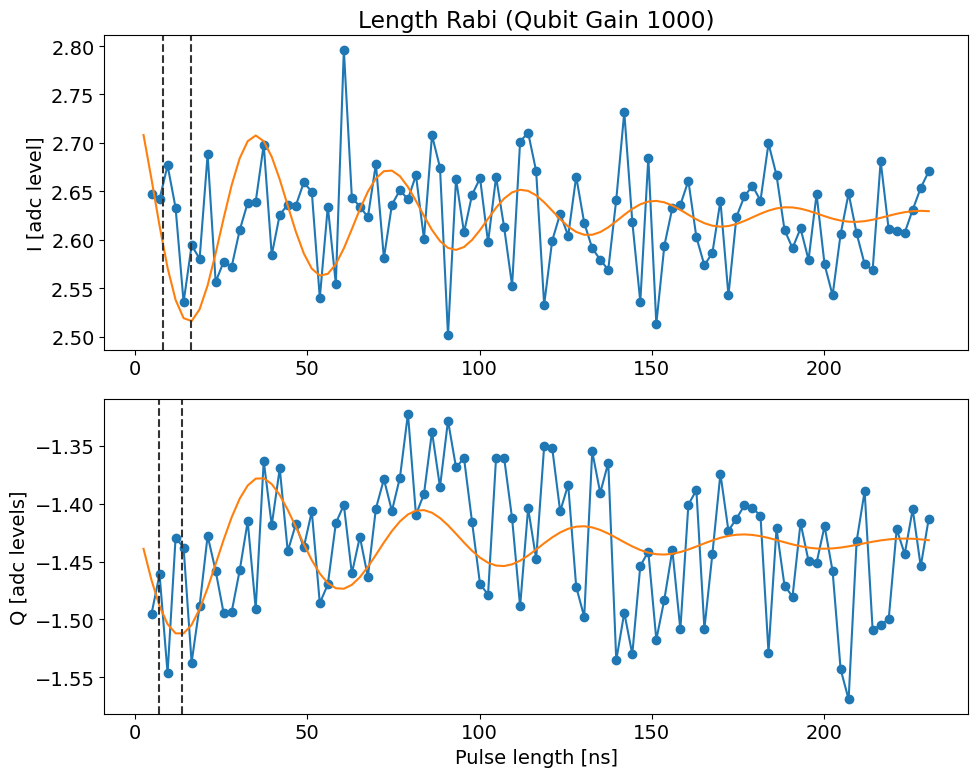

*Set cfg qubit 2 rabi length to 0.016277568004732176* us
qTest =  0.016277568004732176
gauss


  0%|          | 0/200000 [00:00<?, ?it/s]

Attempted to init fitparam 1 to 0.02747068676716918, which is out of bounds 3.3670033670033675e-05 to 0.003367003367003367. Instead init to 0.0017003367003367003
Attempted to init fitparam 1 to 0.02981574539363484, which is out of bounds 3.3670033670033675e-05 to 0.003367003367003367. Instead init to 0.0017003367003367003
Attempted to init fitparam 1 to 0.02747068676716918, which is out of bounds 3.3670033670033675e-05 to 0.003367003367003367. Instead init to 0.0017003367003367003
Pi gain from amps data [dac units]: 240
	Pi/2 gain from amps data [dac units]: 120
Pi gain from avgi data [dac units]: 388
	Pi/2 gain from avgi data [dac units]: 194
Pi gain from avgq data [dac units]: 290
	Pi/2 gain from avgq data [dac units]: 145


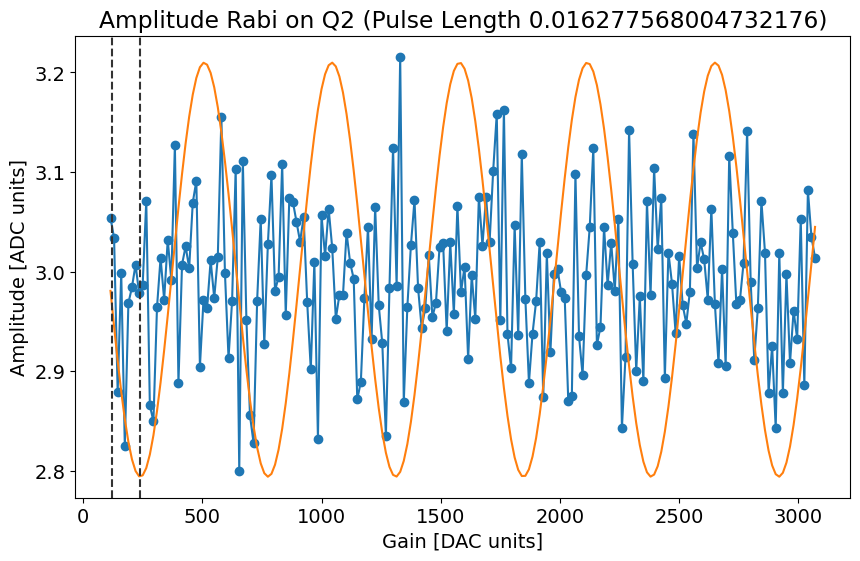

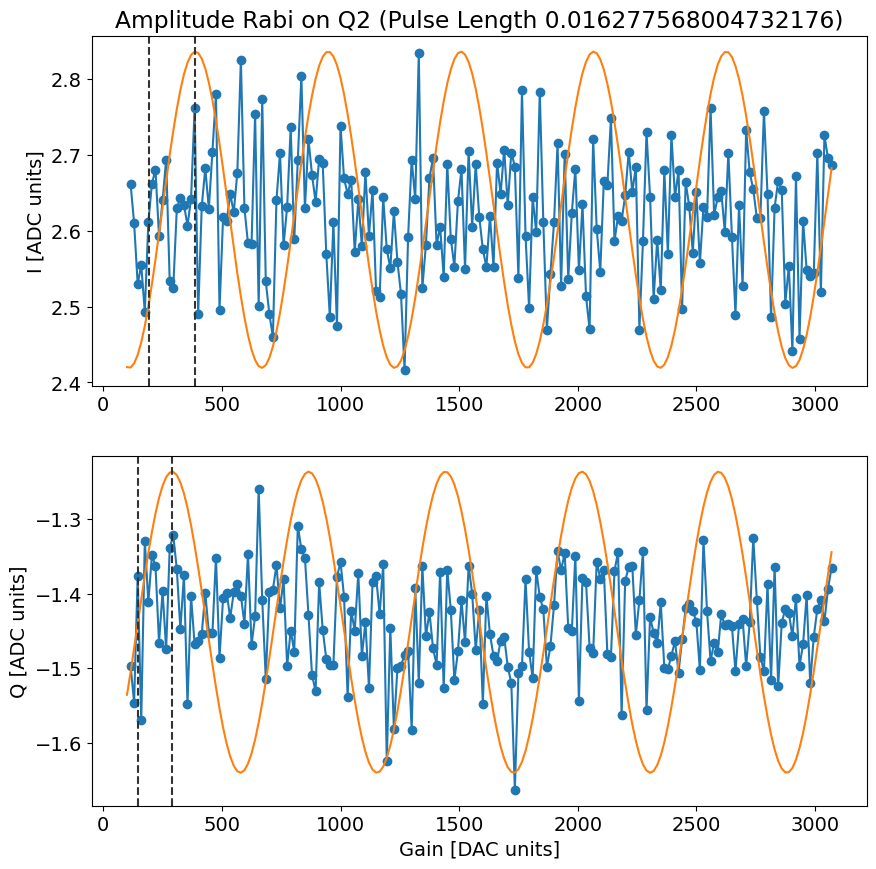

*Set cfg qubit 2 rabi amplitude to 388* DAC units


  0%|          | 0/60000 [00:00<?, ?it/s]

Attempted to init fitparam 1 to 0.6956521739130435, which is out of bounds 0.0006711409395973155 to 0.10067114093959731. Instead init to 0.05067114093959731
Attempted to init fitparam 1 to 0.5418060200668896, which is out of bounds 0.0006711409395973155 to 0.10067114093959731. Instead init to 0.05067114093959731
Attempted to init fitparam 1 to 0.27424749163879597, which is out of bounds 0.0006711409395973155 to 0.10067114093959731. Instead init to 0.05067114093959731
Current pi pulse frequency: 2995.74
Fit frequency from amps [MHz]: 0.026961602142163192 +/- 0.0008648016667749333
Suggested new pi pulse frequencies from fit amps [MHz]:
 	2997.7130383978574
 	2993.7130383978574
T2 Ramsey from fit amps [us]: 44.7
Current pi pulse frequency: 2995.74
Fit frequency from I [MHz]: 0.015763537797181686 +/- 0.0028673596915237934
Suggested new pi pulse frequency from fit I [MHz]:
 	2997.7242364622025
 	2993.7242364622025
T2 Ramsey from fit I [us]: 44.7
Fit frequency from Q [MHz]: 0.028865481956239

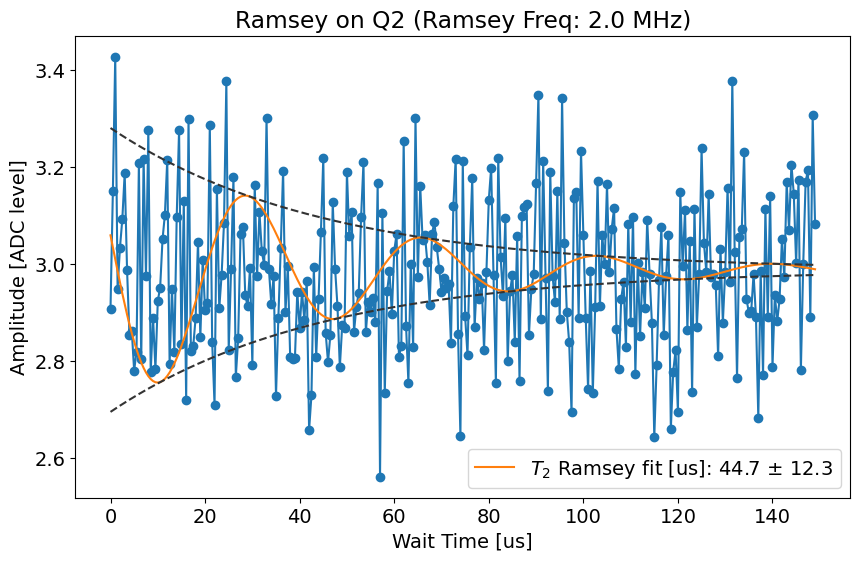

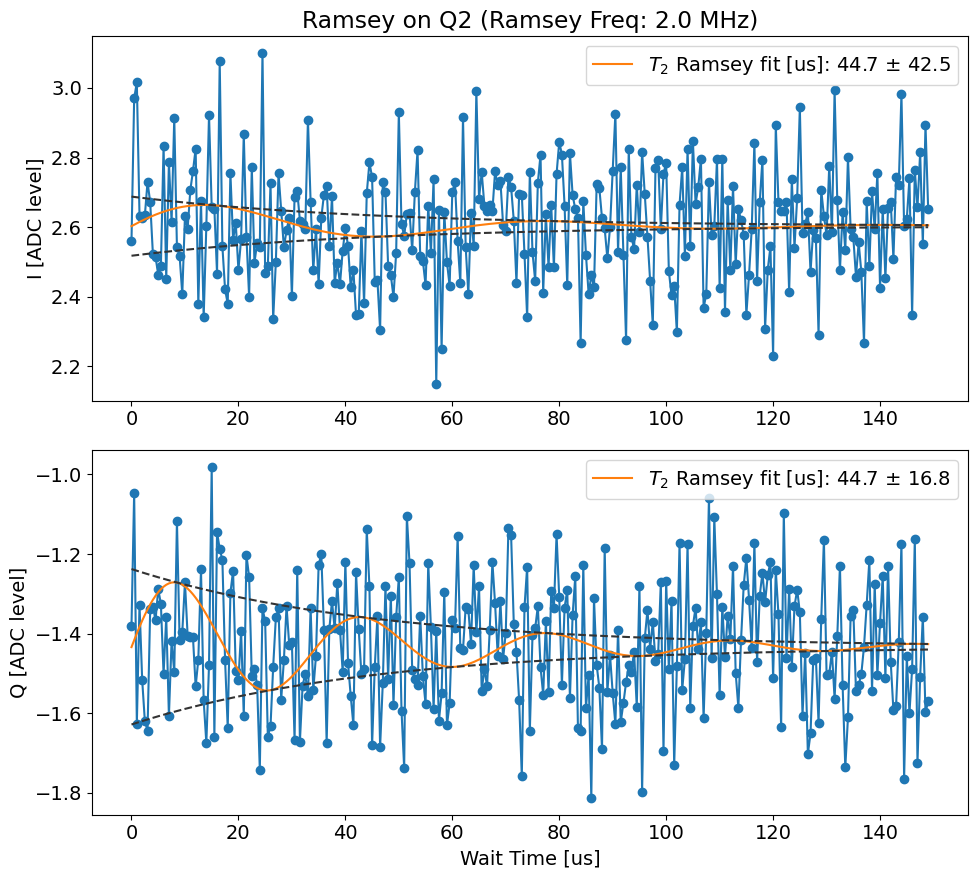

Replacing 2995.74 with 2993.7130383978574 in results cfg file
qTest =  0.016277568004732176
gauss


  0%|          | 0/200000 [00:00<?, ?it/s]

Attempted to init fitparam 1 to 0.020770519262981575, which is out of bounds 3.3670033670033675e-05 to 0.003367003367003367. Instead init to 0.0017003367003367003
Attempted to init fitparam 1 to 0.020770519262981575, which is out of bounds 3.3670033670033675e-05 to 0.003367003367003367. Instead init to 0.0017003367003367003
Pi gain from amps data [dac units]: 302
	Pi/2 gain from amps data [dac units]: 151
Pi gain from avgi data [dac units]: 275
	Pi/2 gain from avgi data [dac units]: 137
Pi gain from avgq data [dac units]: 698
	Pi/2 gain from avgq data [dac units]: 349


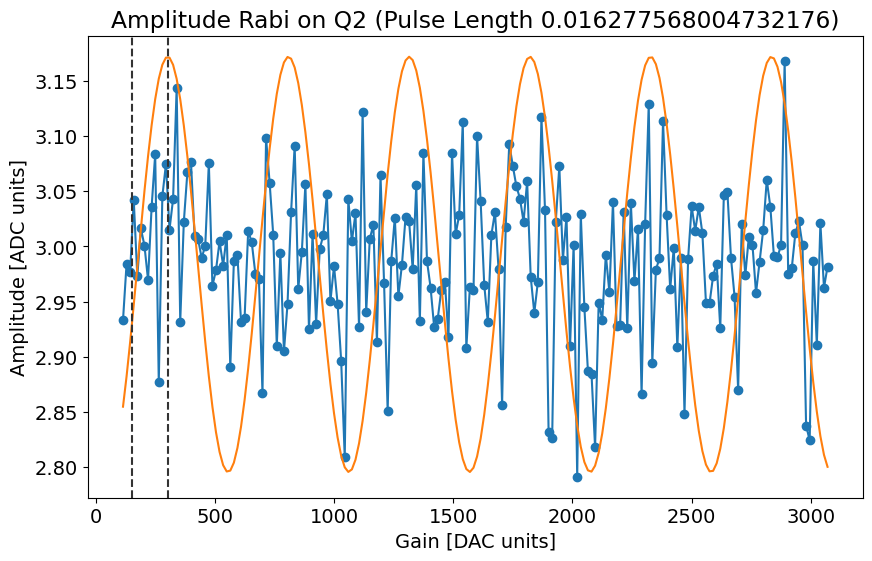

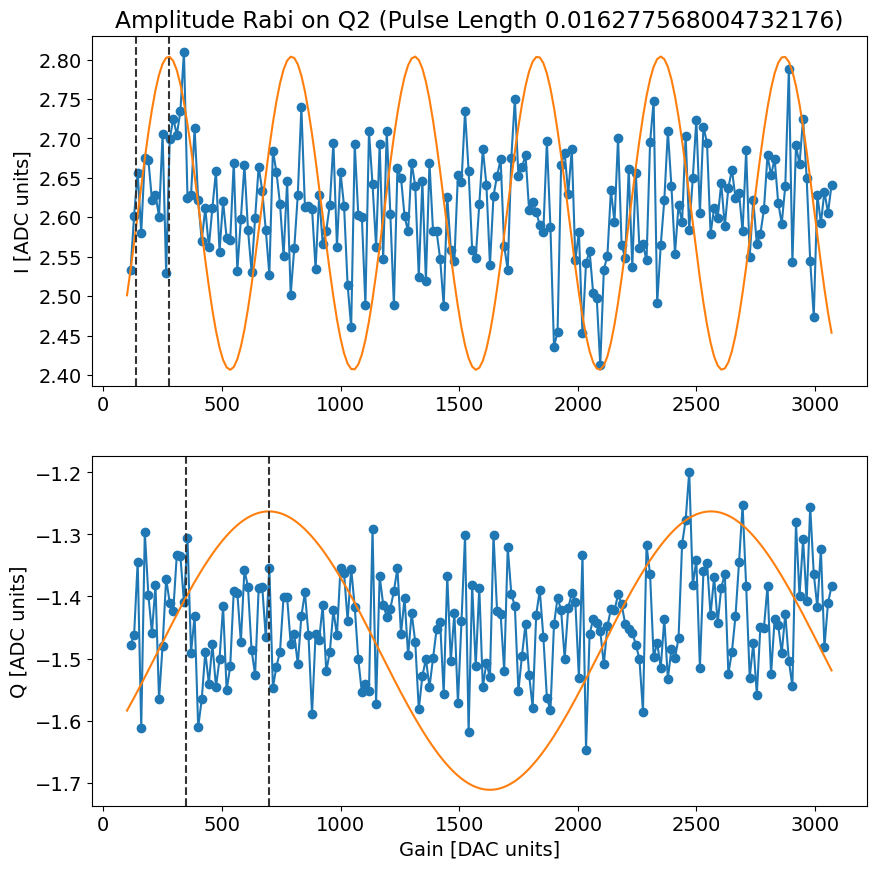

*Set cfg qubit 2 rabi amplitude to 275* DAC units


  0%|          | 0/200000 [00:00<?, ?it/s]

Fit T1 avgi [us]: 114.10444819614703
Fit T1 avgq [us]: -1154.5367139671562


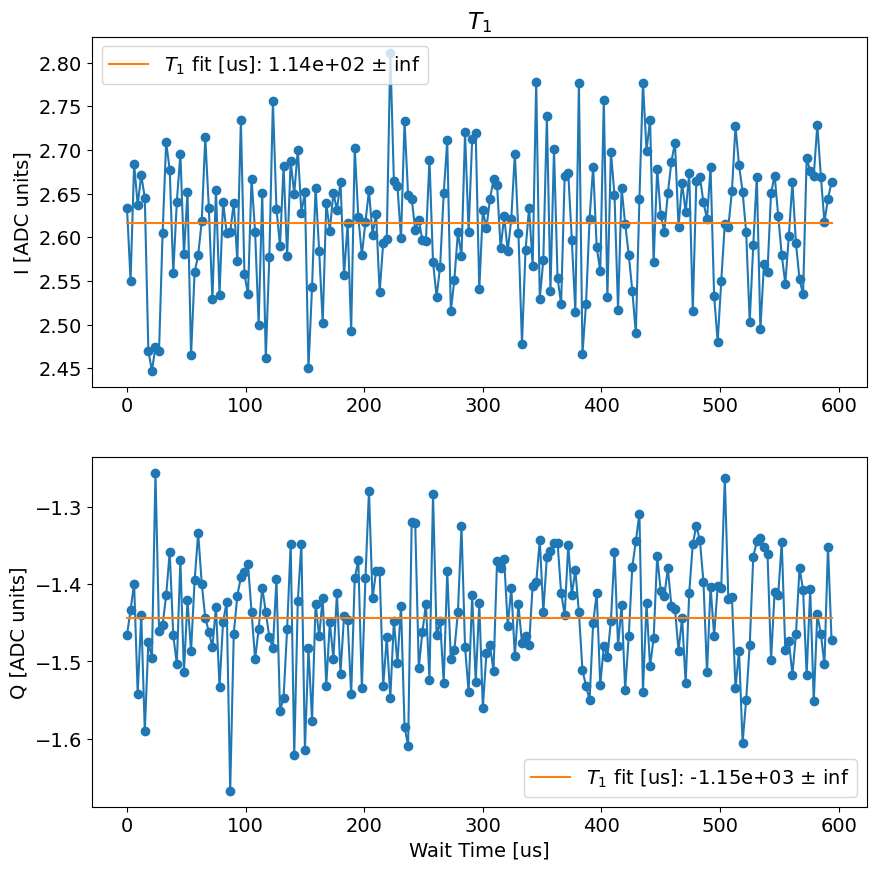

t1_i error:fit ratio= inf
t1_q error:fit ratio= -inf
t1_q is better, saving t1_q to results cfg file
*Set cfg qubit 2 T1 to -1154.5367139671562* us
Running analysis for qubit:  3 ...


  0%|          | 0/500 [00:00<?, ?it/s]

From Fit:
	f0: 6994.157924201247
	kappa[MHz]: 20.679115577765216


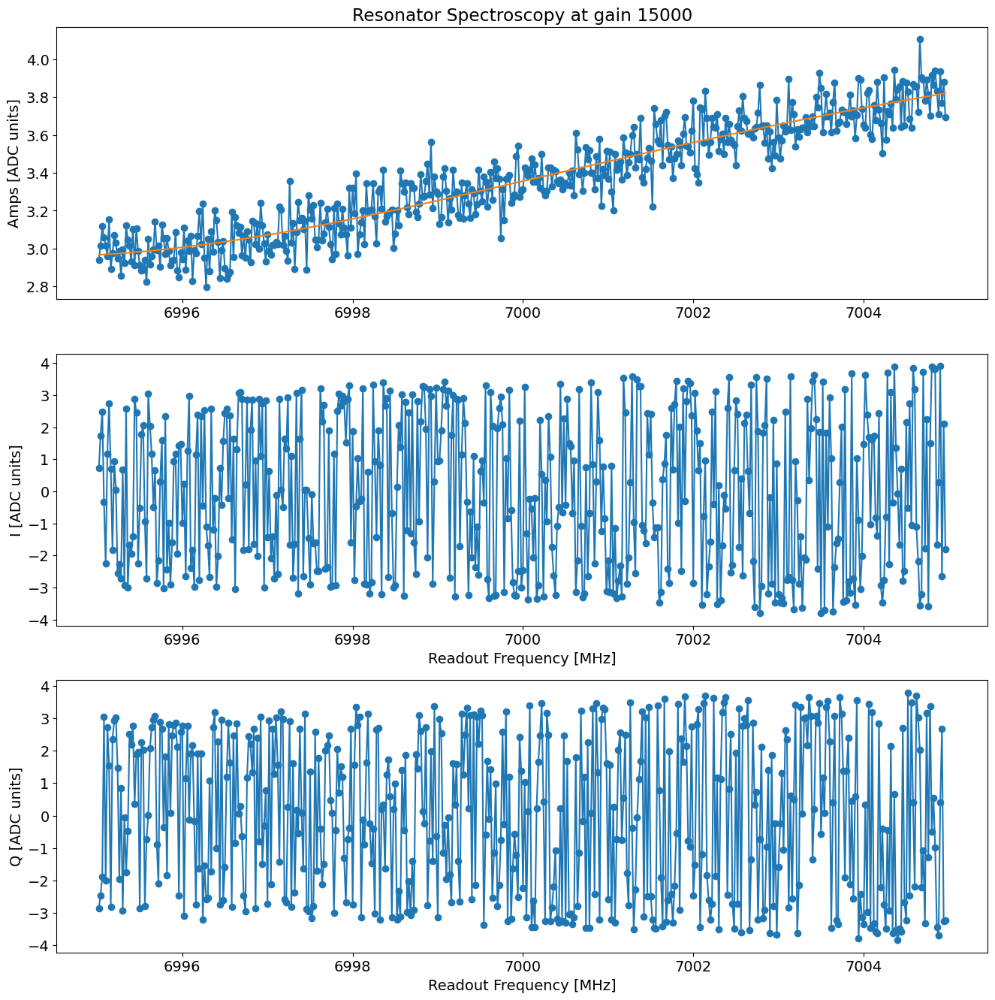

From Fit:
	f0: 6994.157924201247
	kappa[MHz]: 20.679115577765216
*Set cfg res 3 freq to 6994.157924201247*


  0%|          | 0/20 [00:00<?, ?it/s]

Found peak in amps at [MHz] 3002.670591036477, HWHM 372.7253831754787
Found peak in I at [MHz] 2997.599946855492, HWHM 0.004076932979593544
Found peak in Q at [MHz] 3001.6354316687743, HWHM -315.2038953418859


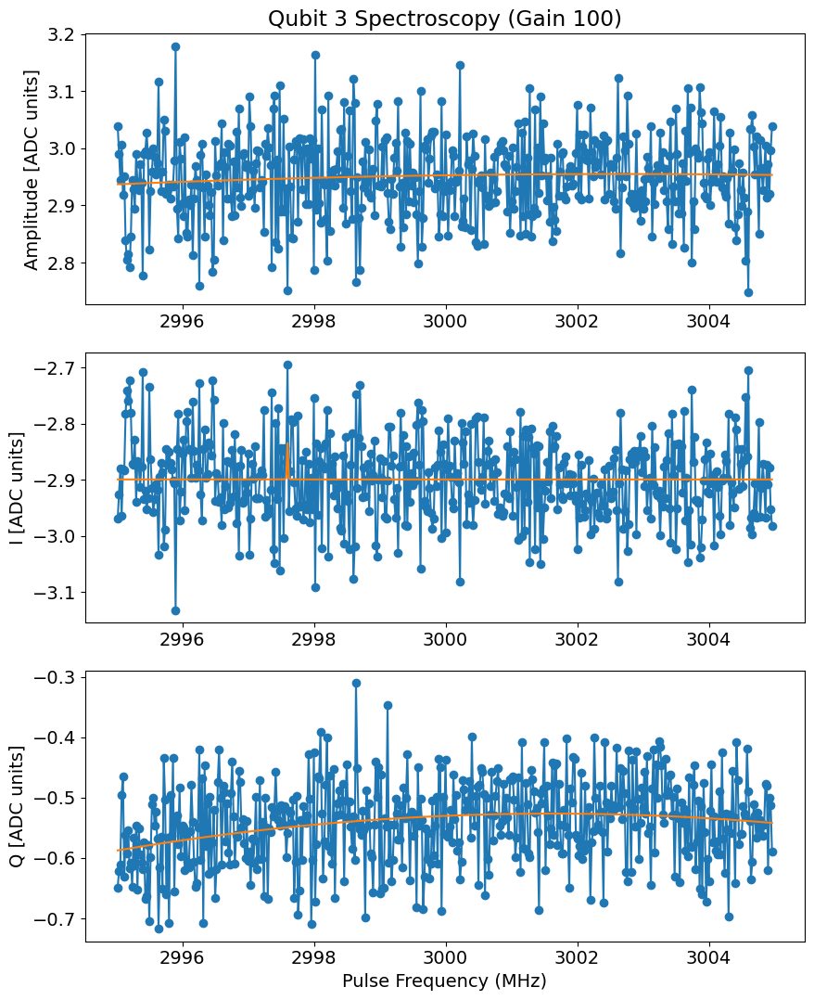

*Set cfg qubit 3 freq to 3002.670591036477*


  0%|          | 0/100 [00:00<?, ?it/s]

Attempted to init fitparam 1 to 112.95030303030302, which is out of bounds 0.4388571428571429 to 65.82857142857142. Instead init to 33.133714285714284
Attempted to init fitparam 1 to 104.26181818181817, which is out of bounds 0.4388571428571429 to 65.82857142857142. Instead init to 33.133714285714284
Attempted to init fitparam 1 to 95.57333333333332, which is out of bounds 0.4388571428571429 to 65.82857142857142. Instead init to 33.133714285714284
Decay from avgi [us] 0.06835937500000001
Pi length from avgi data [us]: 0.014917316790619618
	Pi/2 length from avgi data [us]: 0.007458658395309809

Decay from avgq [us] 0.06835937500000001
Pi length from avgq data [us]: 0.011877294746729826
Pi/2 length from avgq data [us]: 0.005938647373364913


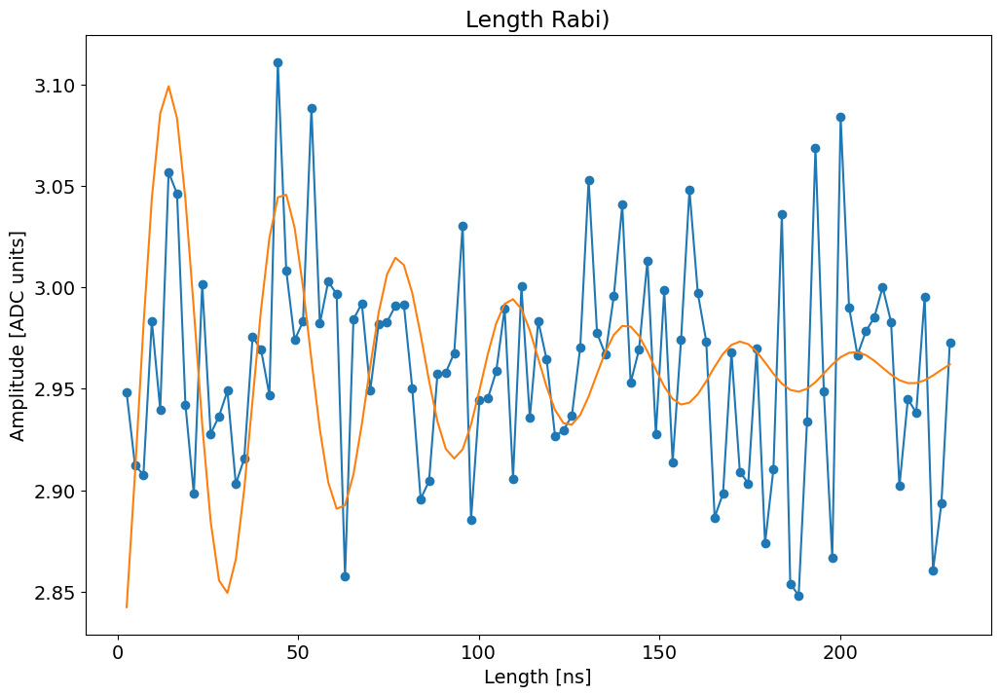

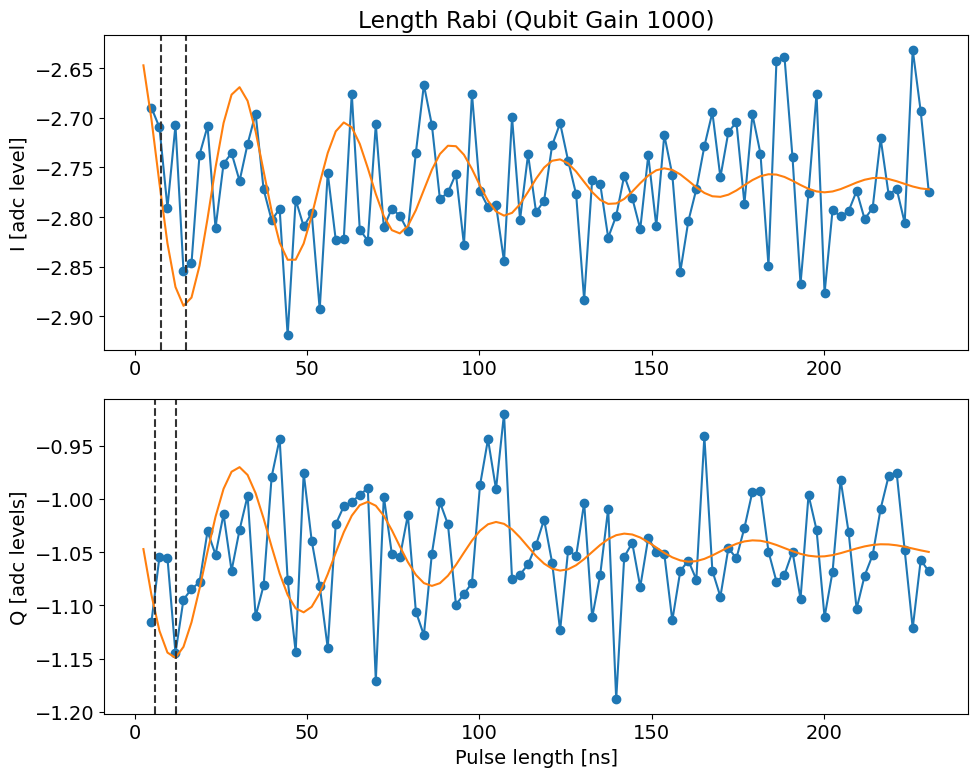

*Set cfg qubit 3 rabi length to 0.014917316790619618* us
qTest =  0.014917316790619618
gauss


  0%|          | 0/200000 [00:00<?, ?it/s]

Attempted to init fitparam 1 to 0.012730318257956449, which is out of bounds 3.3670033670033675e-05 to 0.003367003367003367. Instead init to 0.0017003367003367003
Attempted to init fitparam 1 to 0.004355108877721944, which is out of bounds 3.3670033670033675e-05 to 0.003367003367003367. Instead init to 0.0017003367003367003
Pi gain from amps data [dac units]: 325
	Pi/2 gain from amps data [dac units]: 162
Pi gain from avgi data [dac units]: 334
	Pi/2 gain from avgi data [dac units]: 167
Pi gain from avgq data [dac units]: 13025
	Pi/2 gain from avgq data [dac units]: 6512


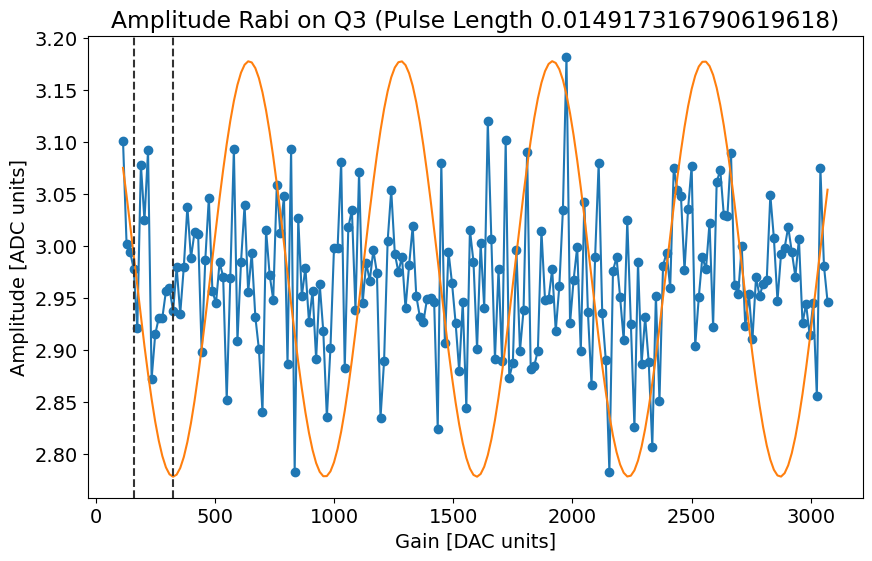

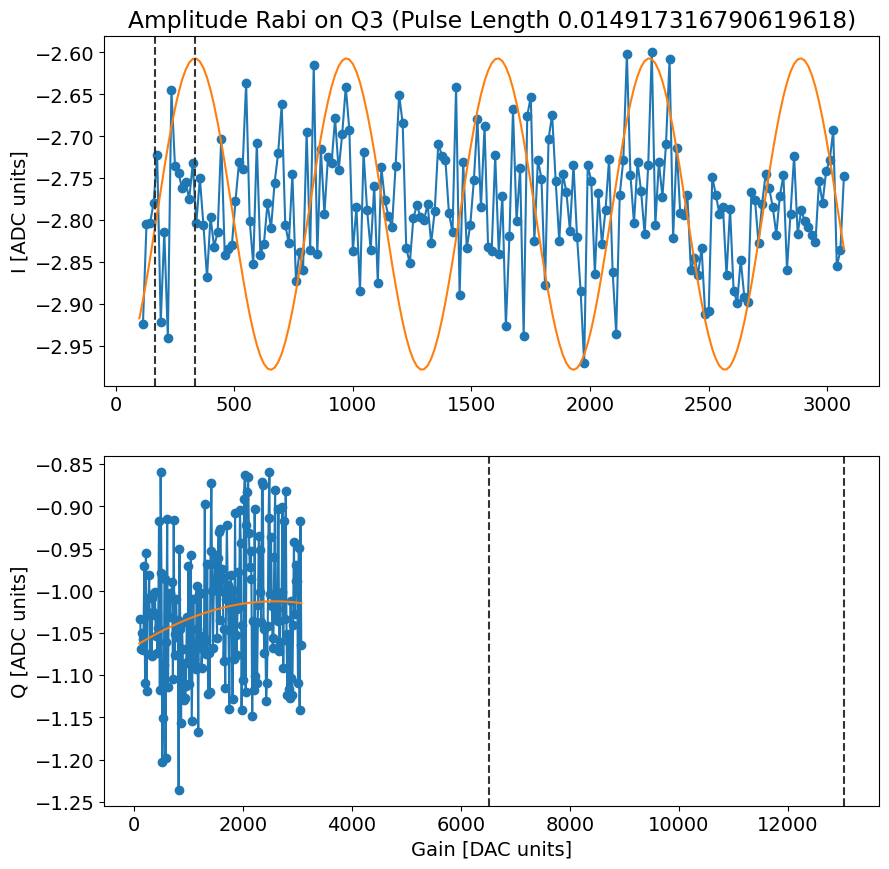

*Set cfg qubit 3 rabi amplitude to 334* DAC units


  0%|          | 0/60000 [00:00<?, ?it/s]

Attempted to init fitparam 1 to 0.8160535117056856, which is out of bounds 0.0006711409395973155 to 0.10067114093959731. Instead init to 0.05067114093959731
Attempted to init fitparam 1 to 0.5083612040133779, which is out of bounds 0.0006711409395973155 to 0.10067114093959731. Instead init to 0.05067114093959731
Current pi pulse frequency: 3002.670591036477
Fit frequency from amps [MHz]: 0.05257830175763153 +/- 0.0006354347101692611
Suggested new pi pulse frequencies from fit amps [MHz]:
 	3004.6180127347197
 	3000.6180127347197
T2 Ramsey from fit amps [us]: 44.7
Current pi pulse frequency: 3002.670591036477
Fit frequency from I [MHz]: 0.004699731015432242 +/- 0.007277162425193308
Suggested new pi pulse frequency from fit I [MHz]:
 	3004.6658913054616
 	3000.6658913054616
T2 Ramsey from fit I [us]: 78.91068764896431
Fit frequency from Q [MHz]: 0.005263448913436661 +/- 0.006498584308212781
Suggested new pi pulse frequencies from fit Q [MHz]:
 	3004.6653275875638
 	3000.6653275875638
T2 

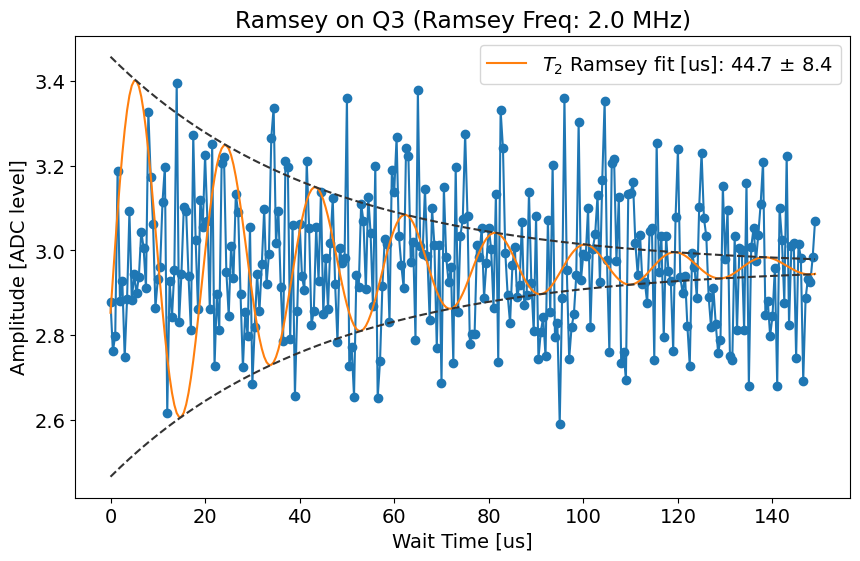

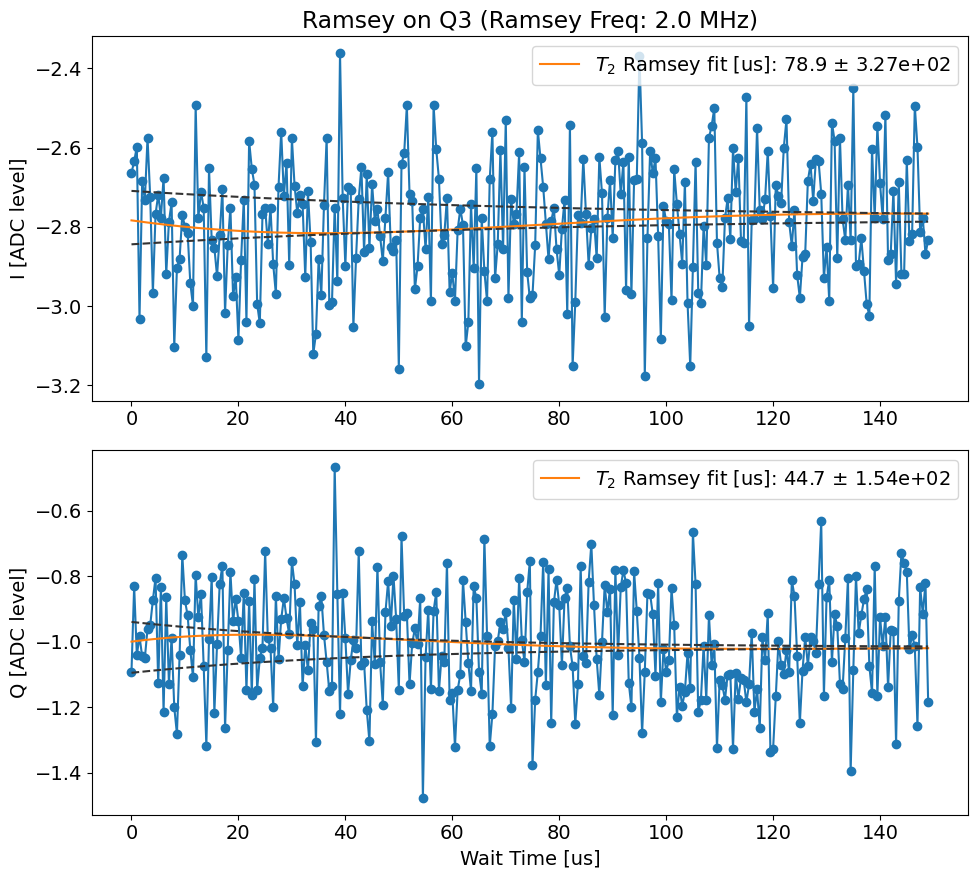

Replacing 3002.670591036477 with 3000.6180127347197 in results cfg file
qTest =  0.014917316790619618
gauss


  0%|          | 0/200000 [00:00<?, ?it/s]

Pi gain from amps data [dac units]: 392
	Pi/2 gain from amps data [dac units]: 196
Pi gain from avgi data [dac units]: 19122
	Pi/2 gain from avgi data [dac units]: 9561
Pi gain from avgq data [dac units]: 258
	Pi/2 gain from avgq data [dac units]: 129


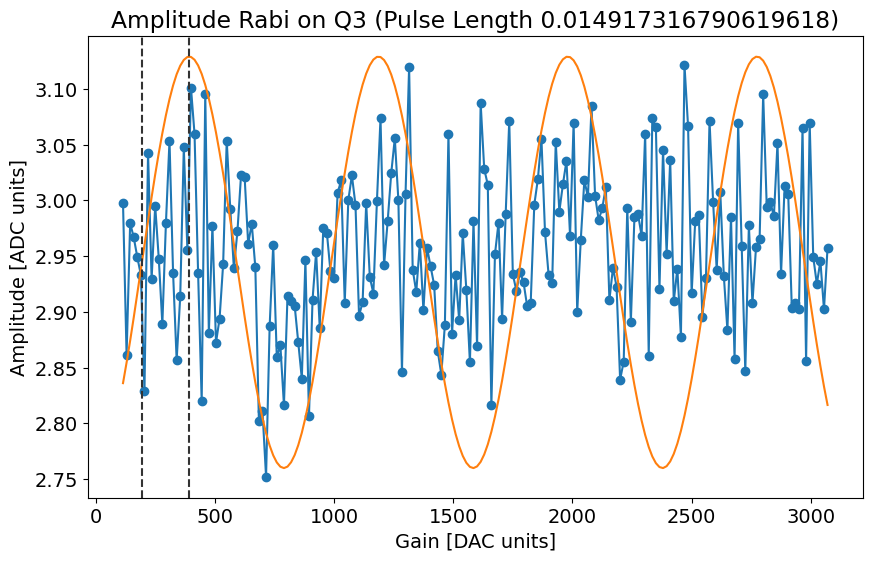

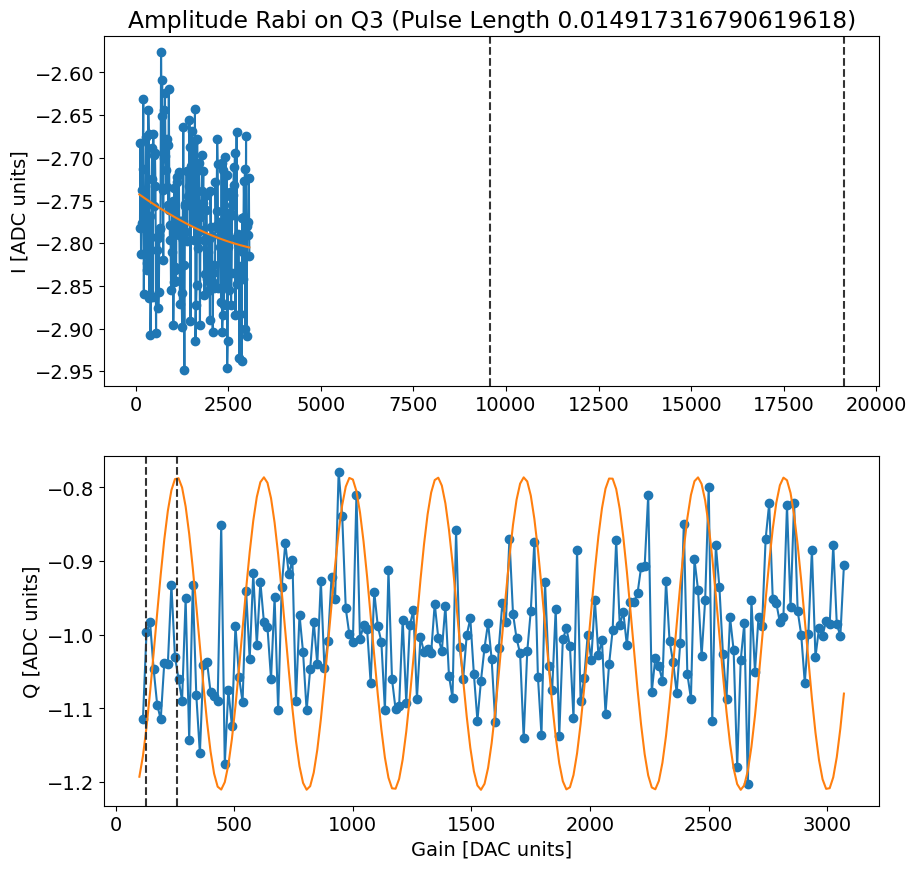

*Set cfg qubit 3 rabi amplitude to 19122* DAC units


  0%|          | 0/200000 [00:00<?, ?it/s]

Fit T1 avgi [us]: 46.8673119428872
Fit T1 avgq [us]: 284.6240876040123


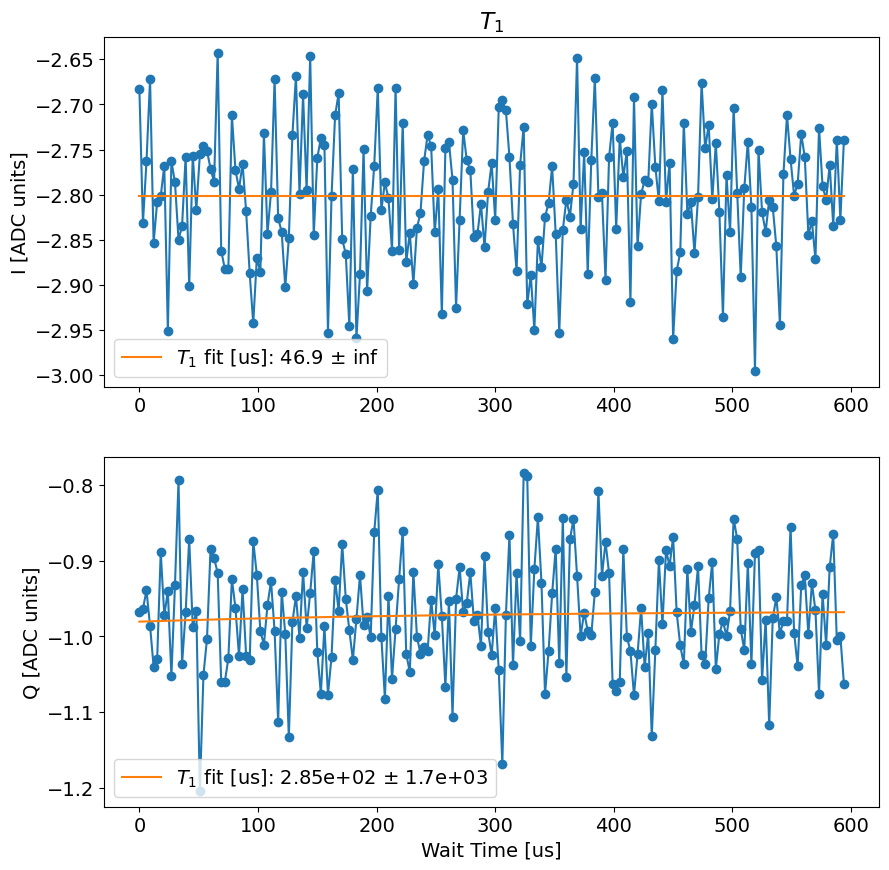

t1_i error:fit ratio= inf
t1_q error:fit ratio= 5.9563822151394685
t1_q is better, saving t1_q to results cfg file
*Set cfg qubit 3 T1 to 284.6240876040123* us
Running analysis for qubit:  4 ...


  0%|          | 0/500 [00:00<?, ?it/s]

From Fit:
	f0: 6992.913620474835
	kappa[MHz]: 24.61652936934151


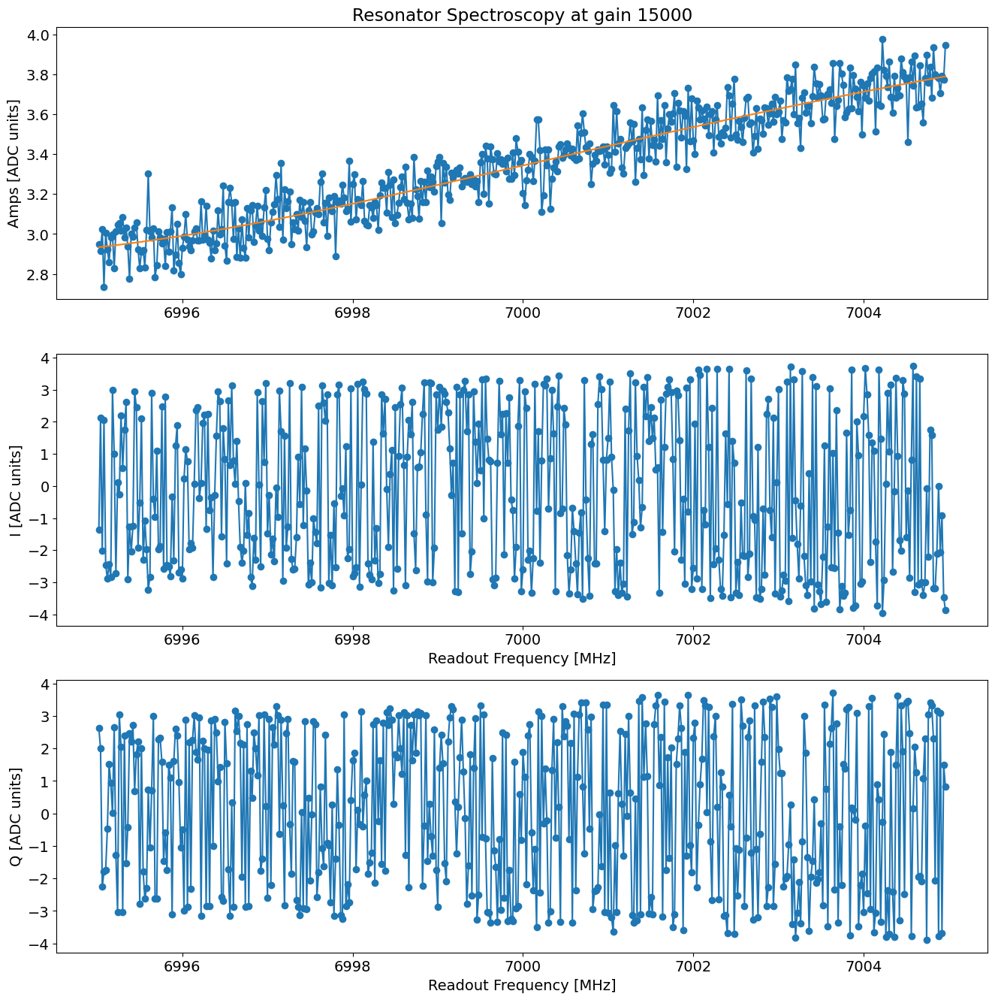

From Fit:
	f0: 6992.913620474835
	kappa[MHz]: 24.61652936934151
*Set cfg res 4 freq to 6992.913620474835*


  0%|          | 0/20 [00:00<?, ?it/s]

Found peak in amps at [MHz] 3001.6200220255378, HWHM 0.5041128238286439
Found peak in I at [MHz] 3003.8, HWHM 0.9940000000000054
Found peak in Q at [MHz] 3001.644207060271, HWHM 0.49976101805766854


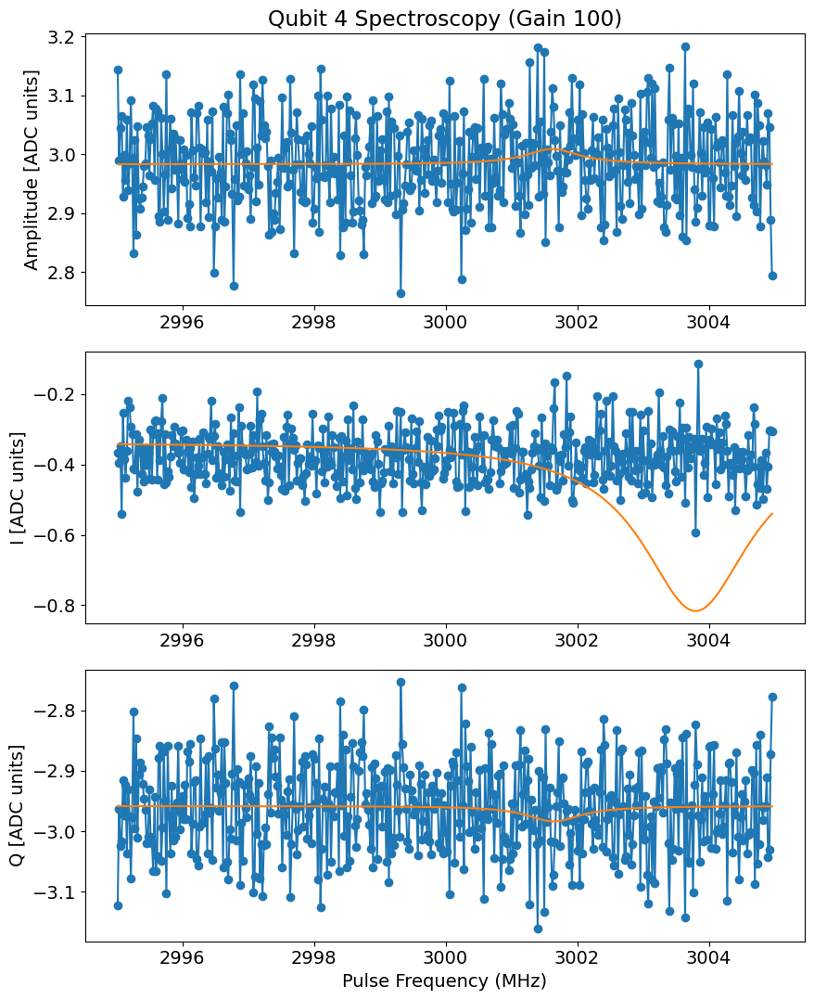

*Set cfg qubit 4 freq to 3001.6200220255378*


  0%|          | 0/100 [00:00<?, ?it/s]

Attempted to init fitparam 1 to 204.17939393939392, which is out of bounds 0.4388571428571429 to 65.82857142857142. Instead init to 33.133714285714284
Attempted to init fitparam 1 to 130.3272727272727, which is out of bounds 0.4388571428571429 to 65.82857142857142. Instead init to 33.133714285714284
Decay from avgi [us] 0.06835937500000001
Pi length from avgi data [us]: 0.012090964057146759
	Pi/2 length from avgi data [us]: 0.006045482028573379

Decay from avgq [us] 0.06835937500000001
Pi length from avgq data [us]: 0.018590369819223455
Pi/2 length from avgq data [us]: 0.009295184909611728


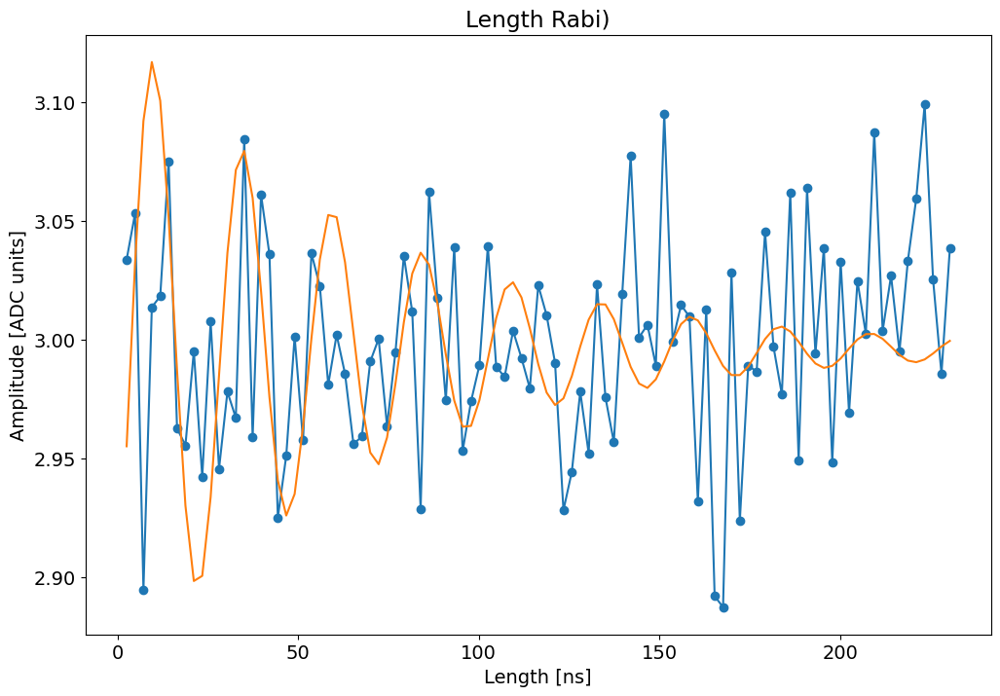

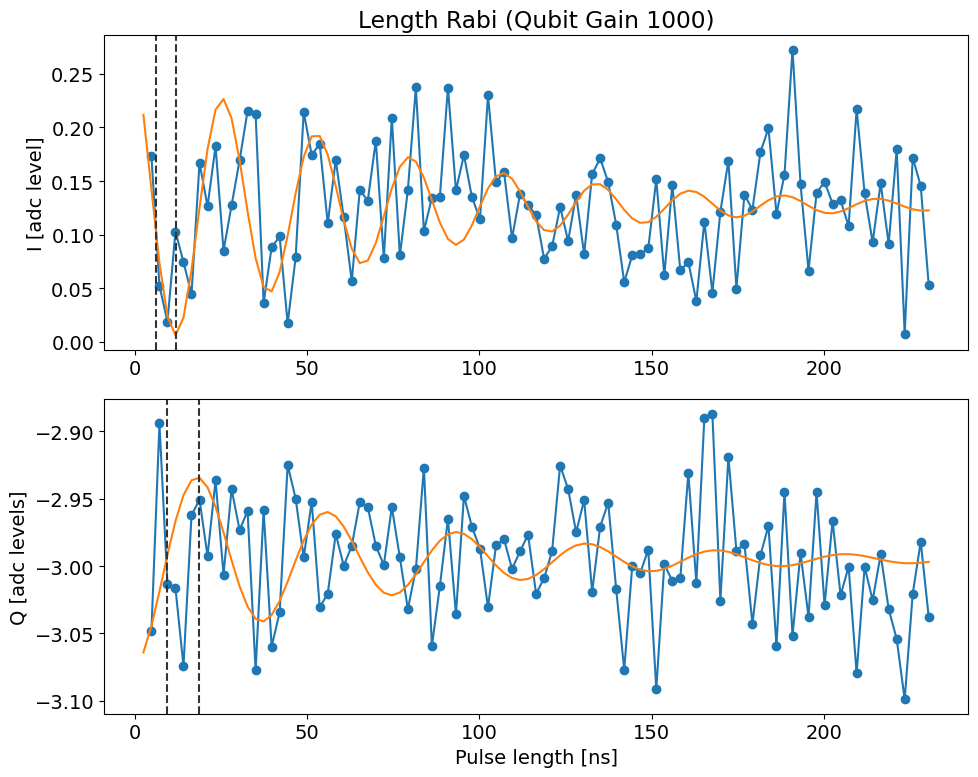

*Set cfg qubit 4 rabi length to 0.012090964057146759* us
qTest =  0.012090964057146759
gauss


  0%|          | 0/200000 [00:00<?, ?it/s]

Attempted to init fitparam 1 to 0.01306532663316583, which is out of bounds 3.3670033670033675e-05 to 0.003367003367003367. Instead init to 0.0017003367003367003
Attempted to init fitparam 1 to 0.01306532663316583, which is out of bounds 3.3670033670033675e-05 to 0.003367003367003367. Instead init to 0.0017003367003367003
Pi gain from amps data [dac units]: 232
	Pi/2 gain from amps data [dac units]: 116
Pi gain from avgi data [dac units]: 19106
	Pi/2 gain from avgi data [dac units]: 9553
Pi gain from avgq data [dac units]: 374
	Pi/2 gain from avgq data [dac units]: 187


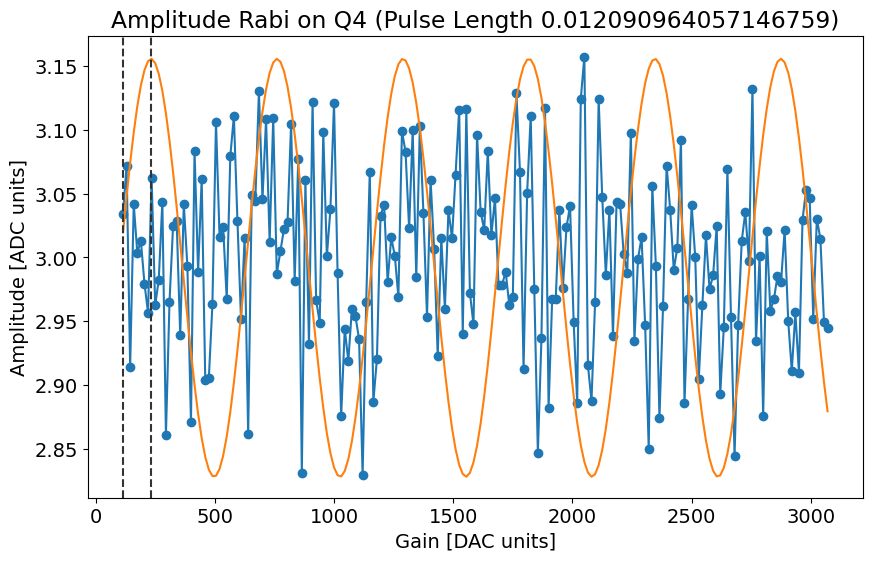

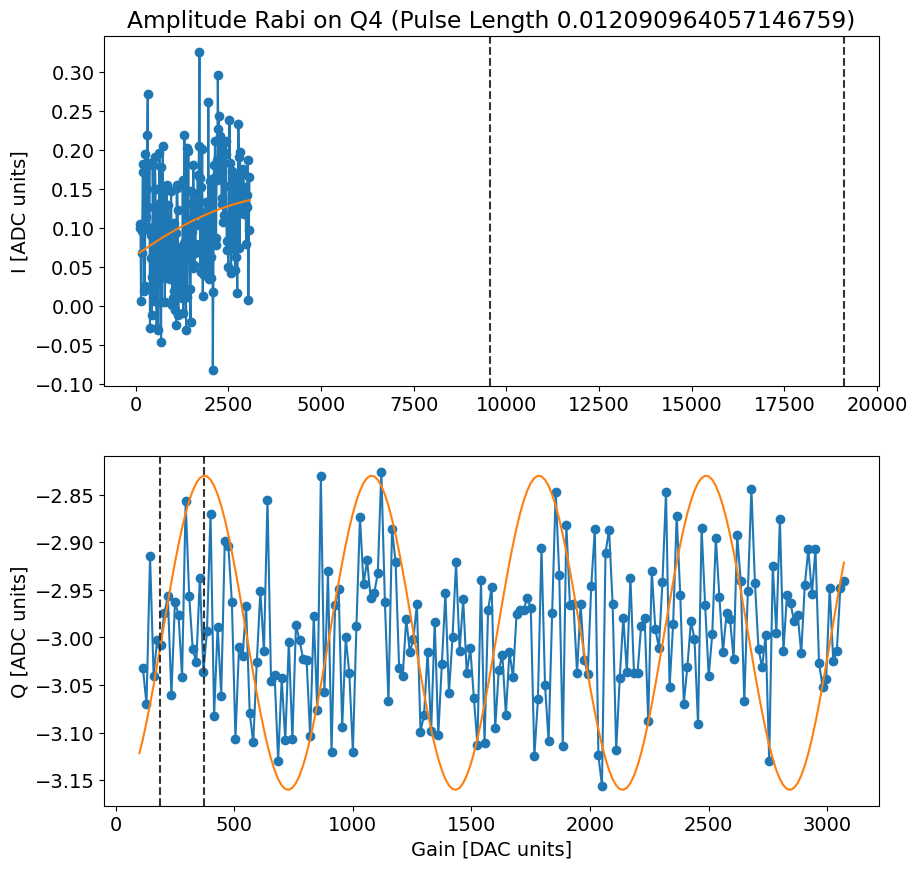

*Set cfg qubit 4 rabi amplitude to 19106* DAC units


  0%|          | 0/60000 [00:00<?, ?it/s]

Attempted to init fitparam 1 to 0.7290969899665551, which is out of bounds 0.0006711409395973155 to 0.10067114093959731. Instead init to 0.05067114093959731
Attempted to init fitparam 1 to 0.2140468227424749, which is out of bounds 0.0006711409395973155 to 0.10067114093959731. Instead init to 0.05067114093959731
Attempted to init fitparam 1 to 0.9096989966555183, which is out of bounds 0.0006711409395973155 to 0.10067114093959731. Instead init to 0.05067114093959731
Current pi pulse frequency: 3001.6200220255378
Fit frequency from amps [MHz]: 0.023624681680247252 +/- 0.0014929387376779286
Suggested new pi pulse frequencies from fit amps [MHz]:
 	3003.5963973438575
 	2999.5963973438575
T2 Ramsey from fit amps [us]: 44.7
Current pi pulse frequency: 3001.6200220255378
Fit frequency from I [MHz]: 0.006306912431784666 +/- 0.0034445704112012364
Suggested new pi pulse frequency from fit I [MHz]:
 	3003.613715113106
 	2999.613715113106
T2 Ramsey from fit I [us]: 76.06139353906615
Fit frequency

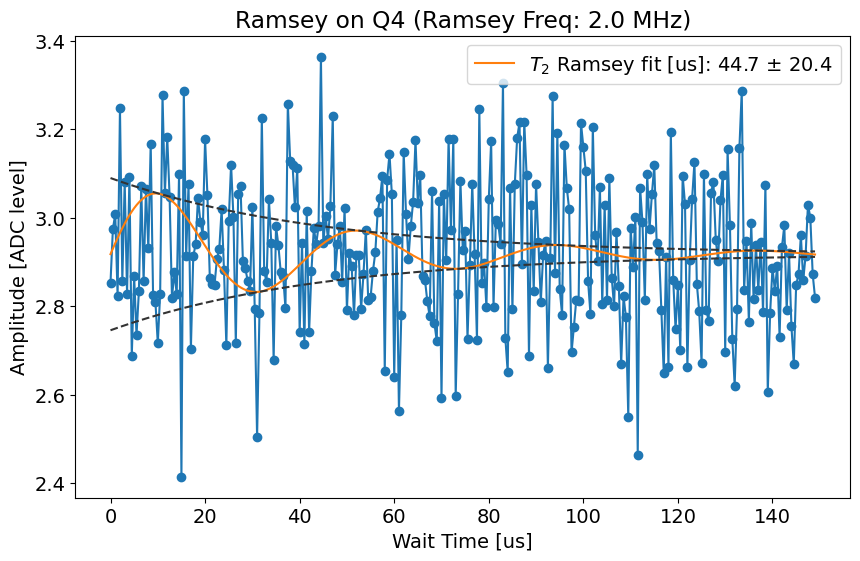

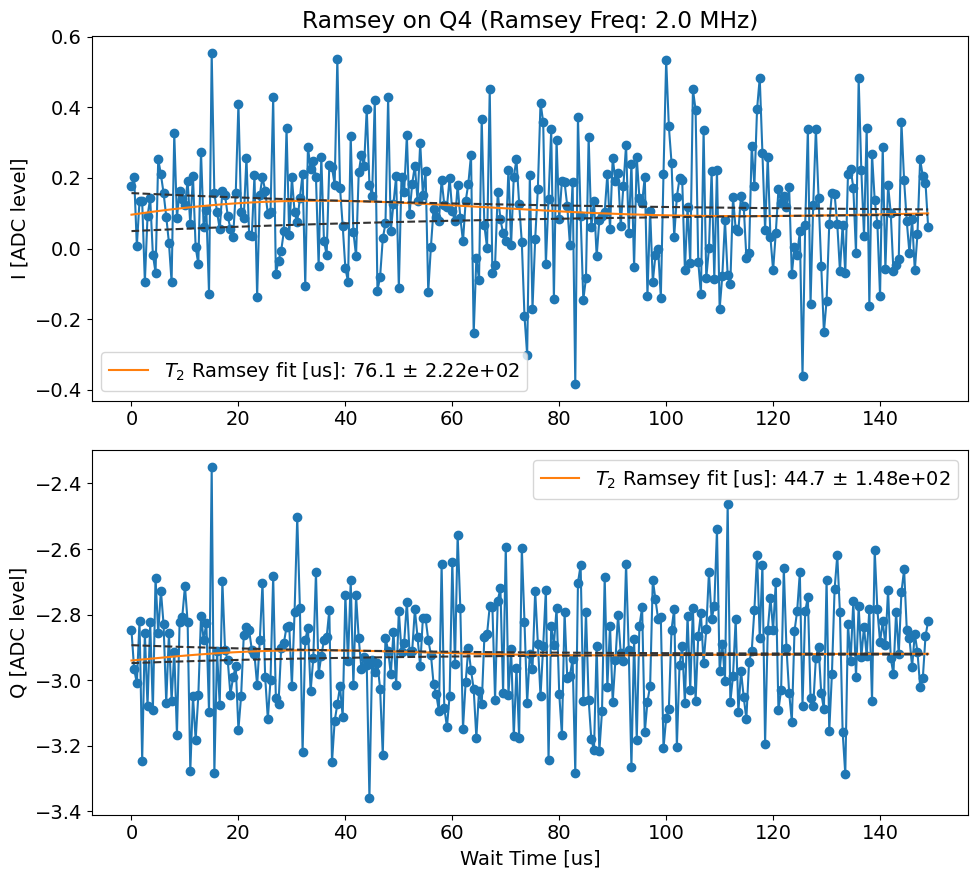

Replacing 3001.6200220255378 with 2999.5963973438575 in results cfg file
qTest =  0.012090964057146759
gauss


  0%|          | 0/200000 [00:00<?, ?it/s]

Attempted to init fitparam 1 to 0.02613065326633166, which is out of bounds 3.3670033670033675e-05 to 0.003367003367003367. Instead init to 0.0017003367003367003
Attempted to init fitparam 1 to 0.02613065326633166, which is out of bounds 3.3670033670033675e-05 to 0.003367003367003367. Instead init to 0.0017003367003367003
Pi gain from amps data [dac units]: 260
	Pi/2 gain from amps data [dac units]: 130
Pi gain from avgi data [dac units]: 276
	Pi/2 gain from avgi data [dac units]: 138
Pi gain from avgq data [dac units]: 275
	Pi/2 gain from avgq data [dac units]: 137


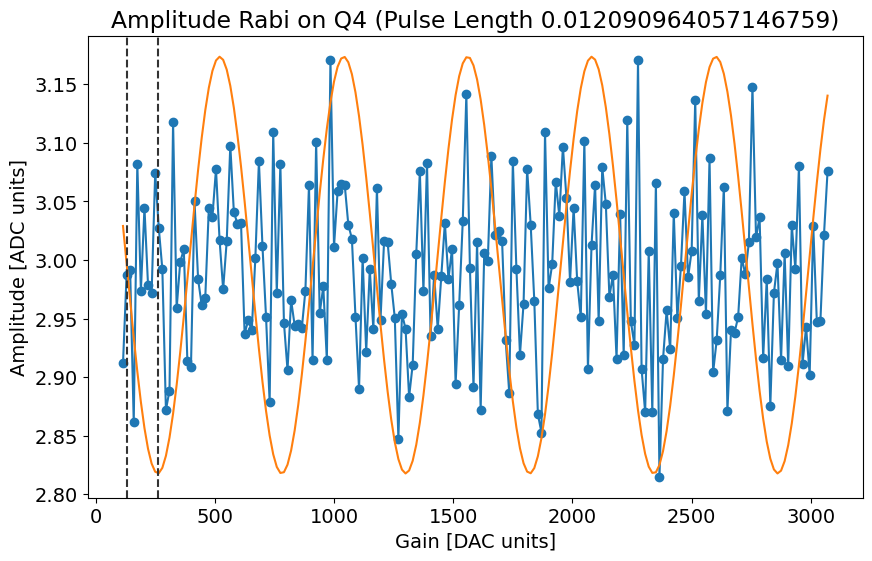

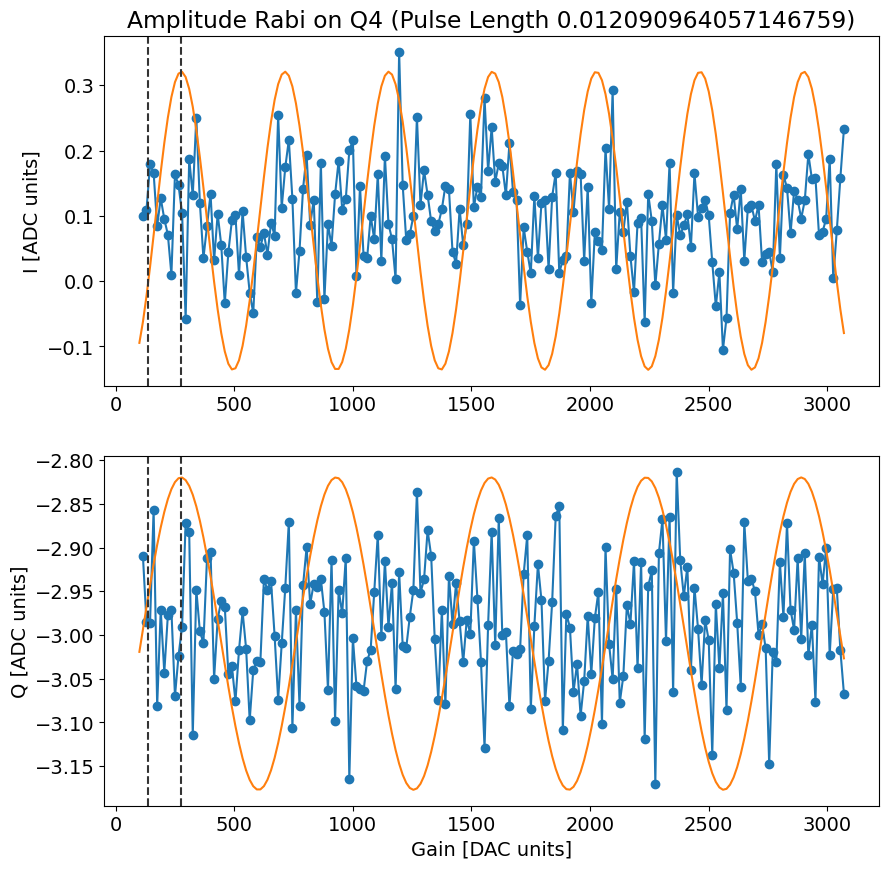

*Set cfg qubit 4 rabi amplitude to 276* DAC units


  0%|          | 0/200000 [00:00<?, ?it/s]

Fit T1 avgi [us]: 57.94747384841041
Fit T1 avgq [us]: 76.8672975668225


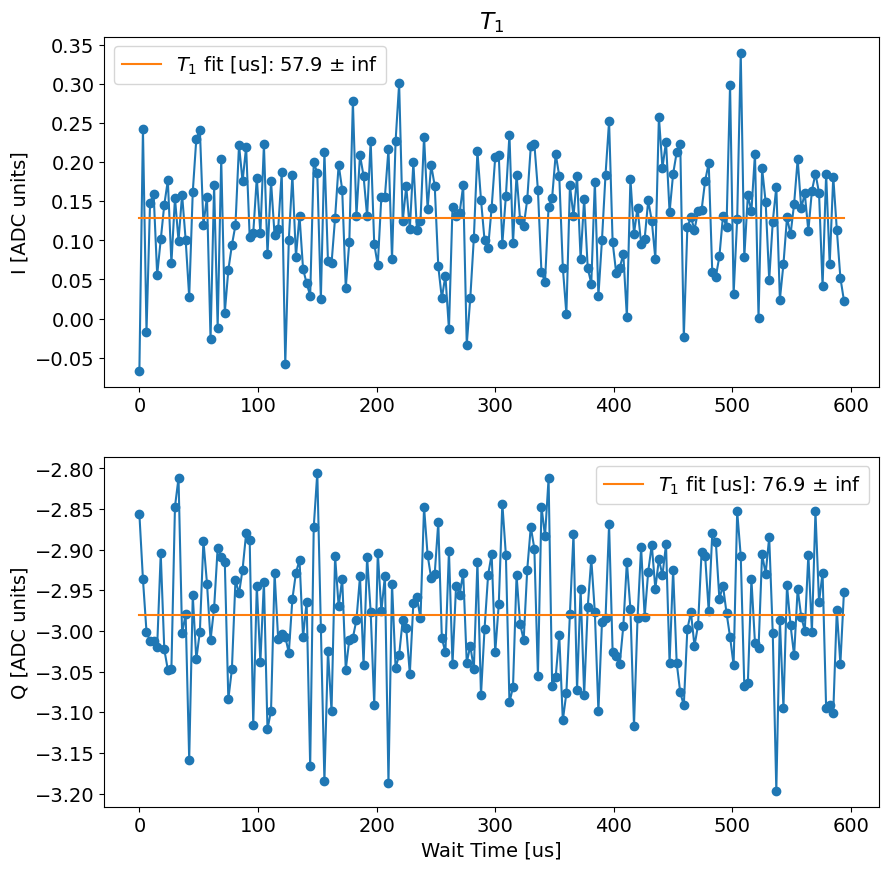

t1_i error:fit ratio= inf
t1_q error:fit ratio= inf
t1_q is better, saving t1_q to results cfg file
*Set cfg qubit 4 T1 to 76.8672975668225* us
Running analysis for qubit:  5 ...


  0%|          | 0/500 [00:00<?, ?it/s]

From Fit:
	f0: 6993.204705041493
	kappa[MHz]: 25.008403509508273


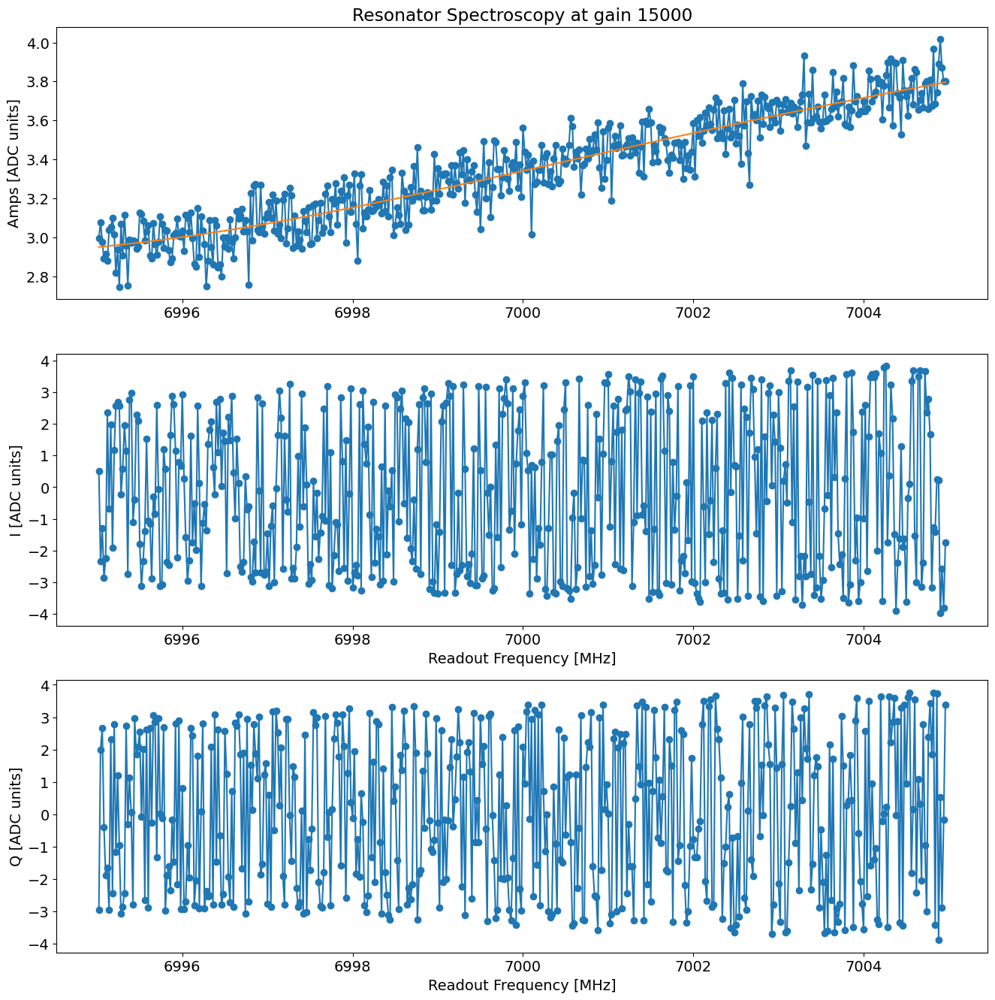

From Fit:
	f0: 6993.204705041493
	kappa[MHz]: 25.008403509508273
*Set cfg res 5 freq to 6993.204705041493*


  0%|          | 0/20 [00:00<?, ?it/s]

Found peak in amps at [MHz] 3004.054892713812, HWHM 0.1499978045555026
Found peak in I at [MHz] 3004.059194325977, HWHM 0.14243347574637658
Found peak in Q at [MHz] 3002.1044774987236, HWHM 6.042700553326665


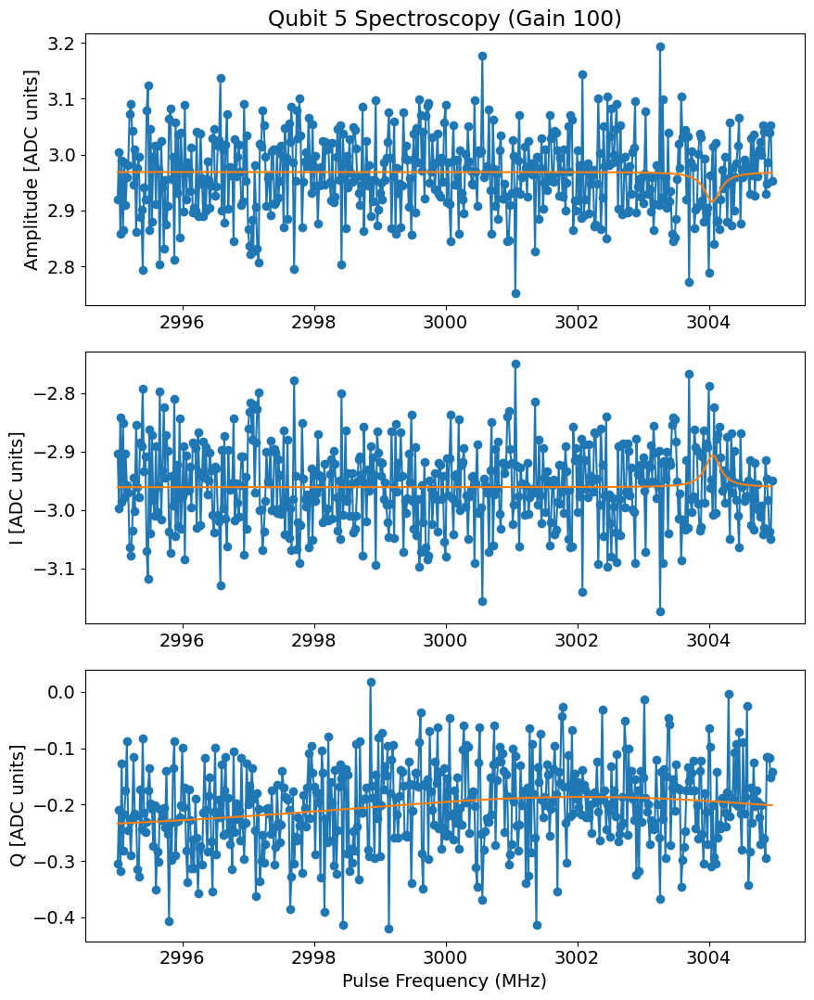

*Set cfg qubit 5 freq to 3004.054892713812*


  0%|          | 0/100 [00:00<?, ?it/s]

Attempted to init fitparam 1 to 73.8521212121212, which is out of bounds 0.4388571428571429 to 65.82857142857142. Instead init to 33.133714285714284
Attempted to init fitparam 1 to 99.91757575757575, which is out of bounds 0.4388571428571429 to 65.82857142857142. Instead init to 33.133714285714284
Decay from avgi [us] 0.06835937500000001
Pi length from avgi data [us]: 0.012829433462322595
	Pi/2 length from avgi data [us]: 0.006414716731161297

Decay from avgq [us] 0.06835937500000001
Pi length from avgq data [us]: 0.008136936747866258
Pi/2 length from avgq data [us]: 0.004068468373933129


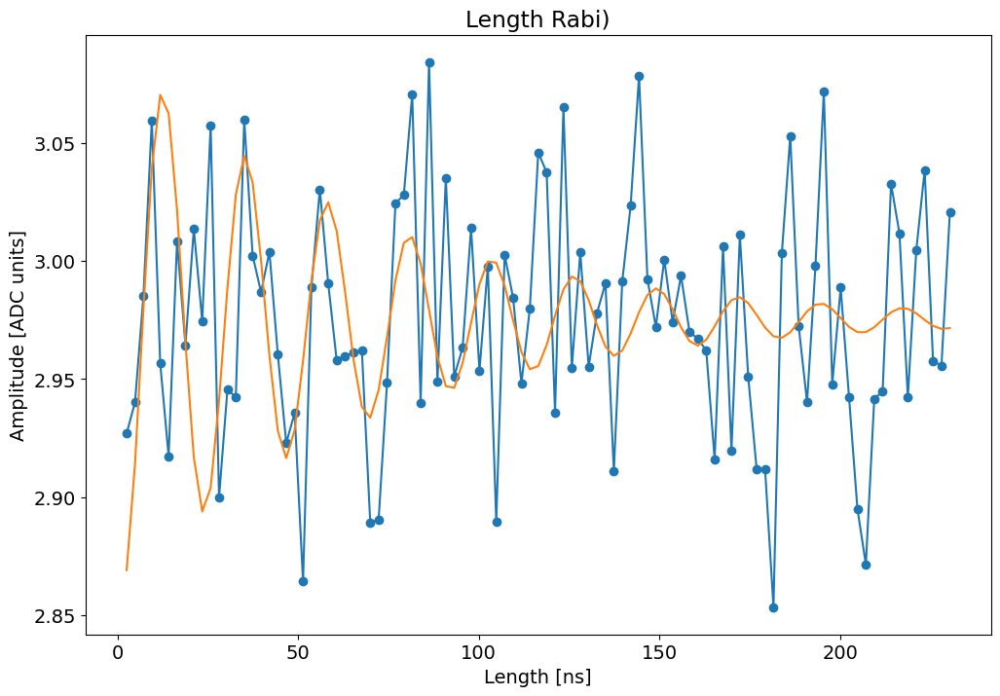

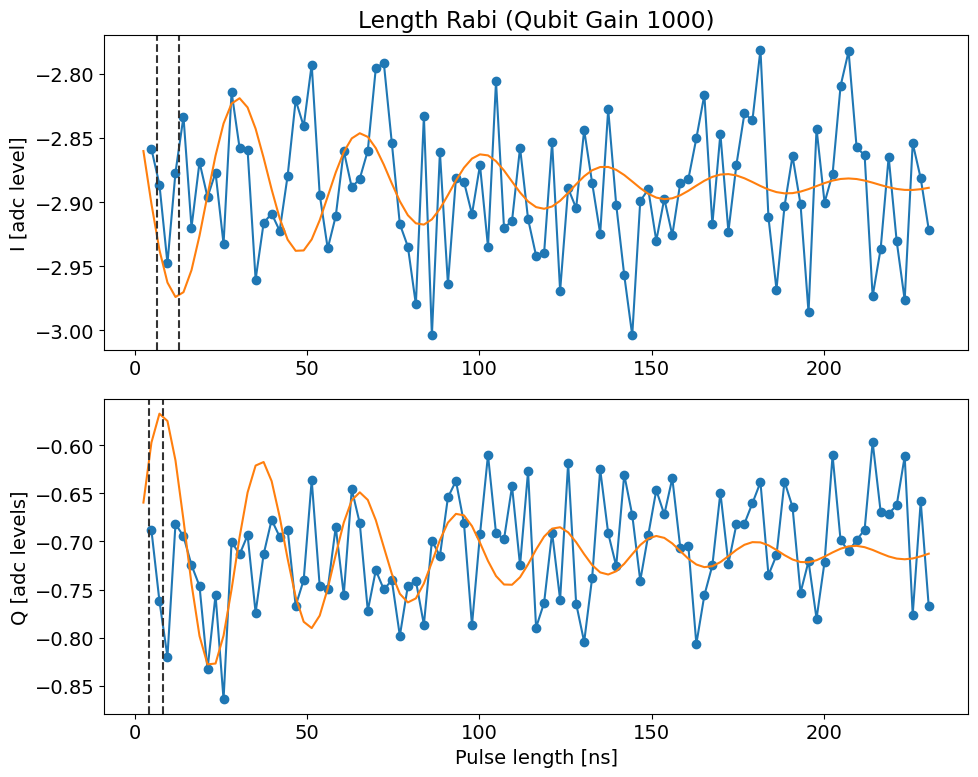

*Set cfg qubit 5 rabi length to 0.012829433462322595* us
qTest =  0.012829433462322595
gauss


  0%|          | 0/200000 [00:00<?, ?it/s]

Attempted to init fitparam 1 to 0.0288107202680067, which is out of bounds 3.3670033670033675e-05 to 0.003367003367003367. Instead init to 0.0017003367003367003
Pi gain from amps data [dac units]: 284
	Pi/2 gain from amps data [dac units]: 142
Pi gain from avgi data [dac units]: 212
	Pi/2 gain from avgi data [dac units]: 106
Pi gain from avgq data [dac units]: 18684
	Pi/2 gain from avgq data [dac units]: 9342


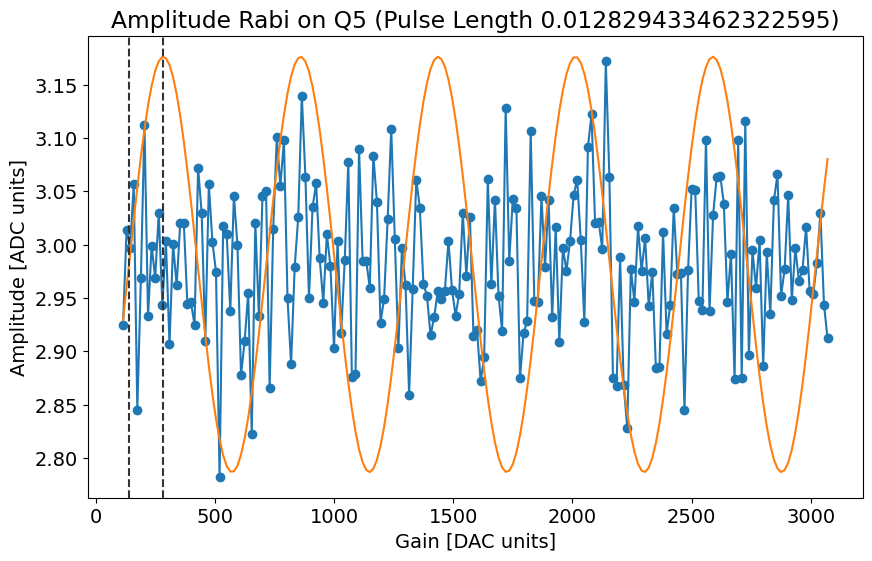

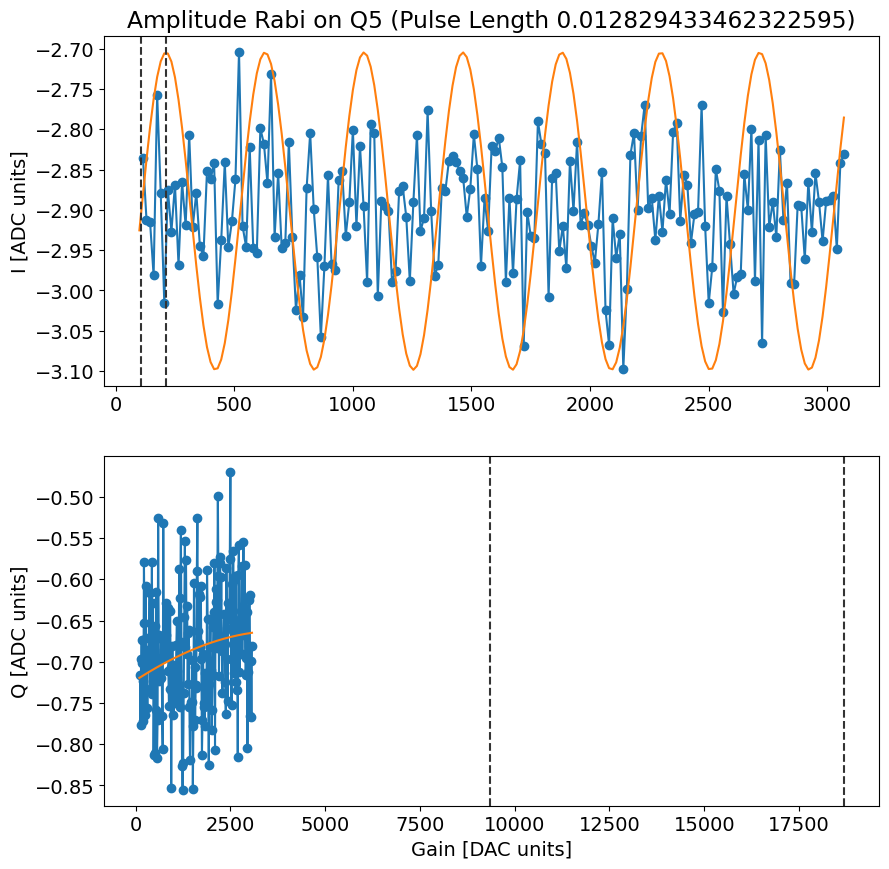

*Set cfg qubit 5 rabi amplitude to 212* DAC units


  0%|          | 0/60000 [00:00<?, ?it/s]

Attempted to init fitparam 1 to 0.5150501672240803, which is out of bounds 0.0006711409395973155 to 0.10067114093959731. Instead init to 0.05067114093959731
Attempted to init fitparam 1 to 0.8093645484949833, which is out of bounds 0.0006711409395973155 to 0.10067114093959731. Instead init to 0.05067114093959731
Current pi pulse frequency: 3004.054892713812
Fit frequency from amps [MHz]: 0.0901795235288309 +/- 0.0005600260857187032
Suggested new pi pulse frequencies from fit amps [MHz]:
 	3005.9647131902834
 	3001.9647131902834
T2 Ramsey from fit amps [us]: 44.7
Current pi pulse frequency: 3004.054892713812
Fit frequency from I [MHz]: 0.026053936355565 +/- 0.0011647907164692858
Suggested new pi pulse frequency from fit I [MHz]:
 	3006.0288387774563
 	3002.0288387774563
T2 Ramsey from fit I [us]: 44.7
Fit frequency from Q [MHz]: 0.04747955248716112 +/- 0.0006830057876967444
Suggested new pi pulse frequencies from fit Q [MHz]:
 	3006.007413161325
 	3002.007413161325
T2 Ramsey from fit Q 

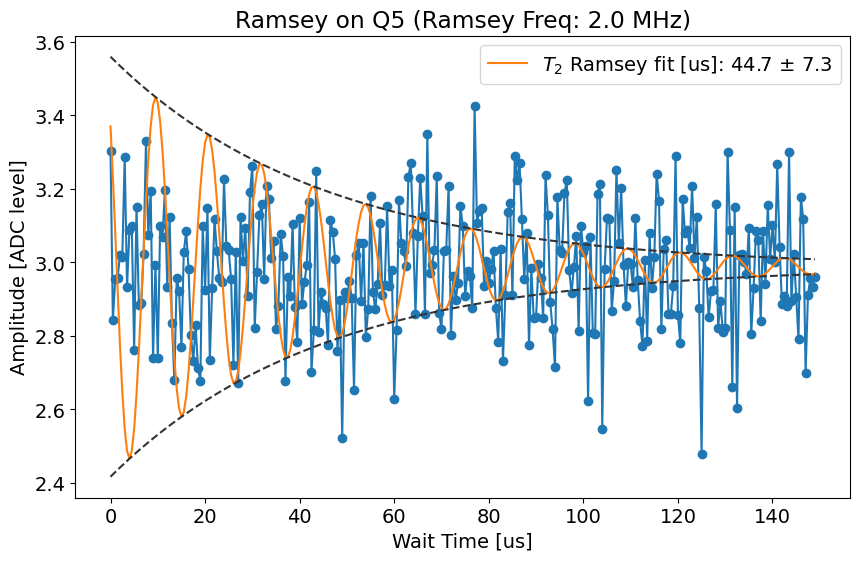

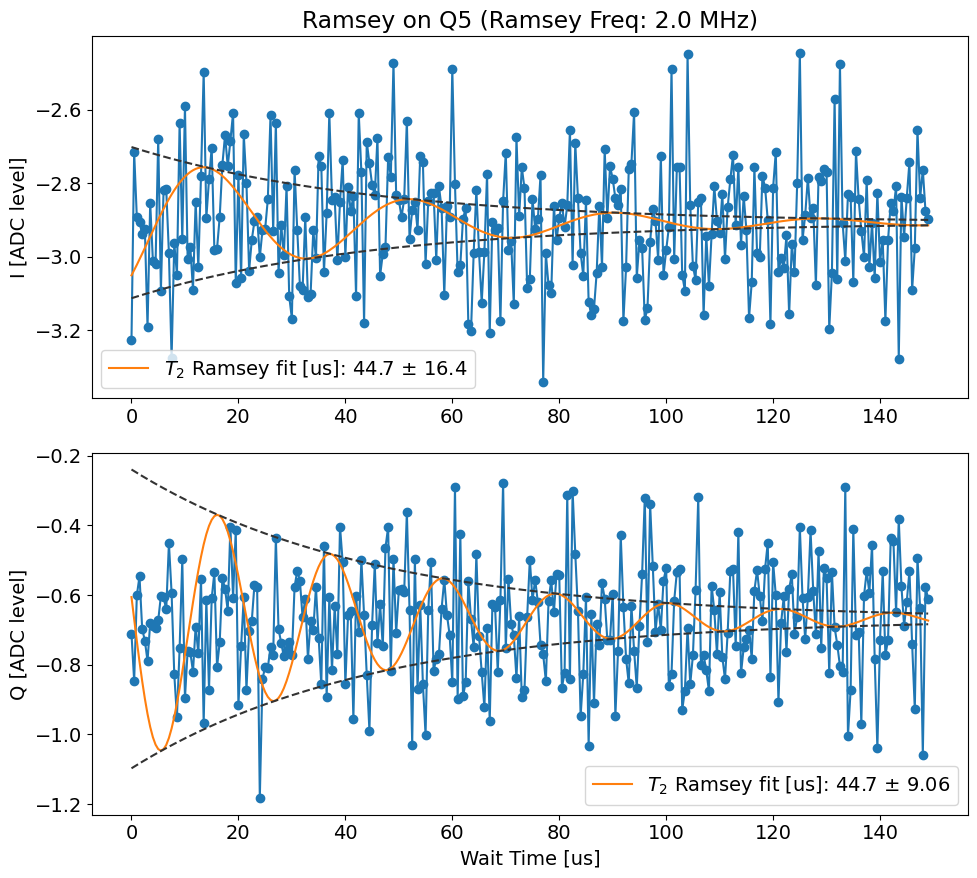

Replacing 3004.054892713812 with 3001.9647131902834 in results cfg file
qTest =  0.012829433462322595
gauss


  0%|          | 0/200000 [00:00<?, ?it/s]

Attempted to init fitparam 1 to 0.014740368509212731, which is out of bounds 3.3670033670033675e-05 to 0.003367003367003367. Instead init to 0.0017003367003367003
Attempted to init fitparam 1 to 0.007705192629815746, which is out of bounds 3.3670033670033675e-05 to 0.003367003367003367. Instead init to 0.0017003367003367003
Attempted to init fitparam 1 to 0.02579564489112228, which is out of bounds 3.3670033670033675e-05 to 0.003367003367003367. Instead init to 0.0017003367003367003
Pi gain from amps data [dac units]: 361
	Pi/2 gain from amps data [dac units]: 180
Pi gain from avgi data [dac units]: 389
	Pi/2 gain from avgi data [dac units]: 194
Pi gain from avgq data [dac units]: 313
	Pi/2 gain from avgq data [dac units]: 156


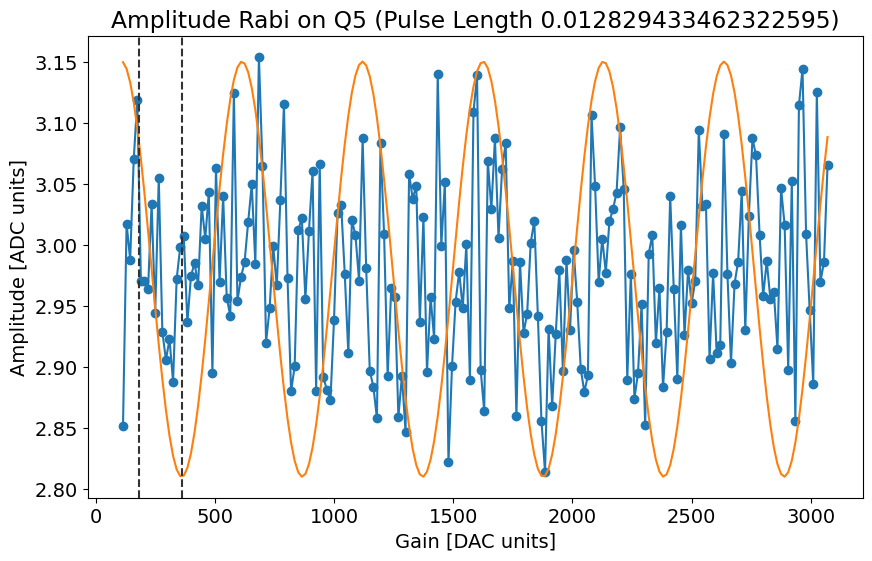

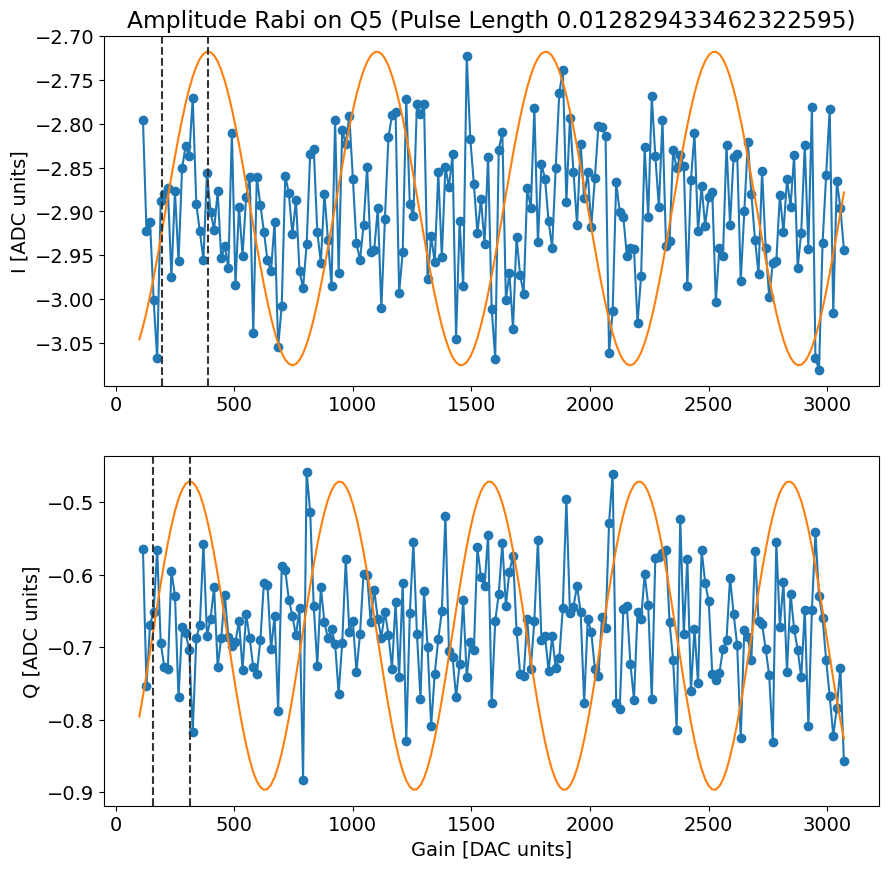

*Set cfg qubit 5 rabi amplitude to 389* DAC units


  0%|          | 0/200000 [00:00<?, ?it/s]

Fit T1 avgi [us]: 84.20298989757491
Fit T1 avgq [us]: 156.99288190661792


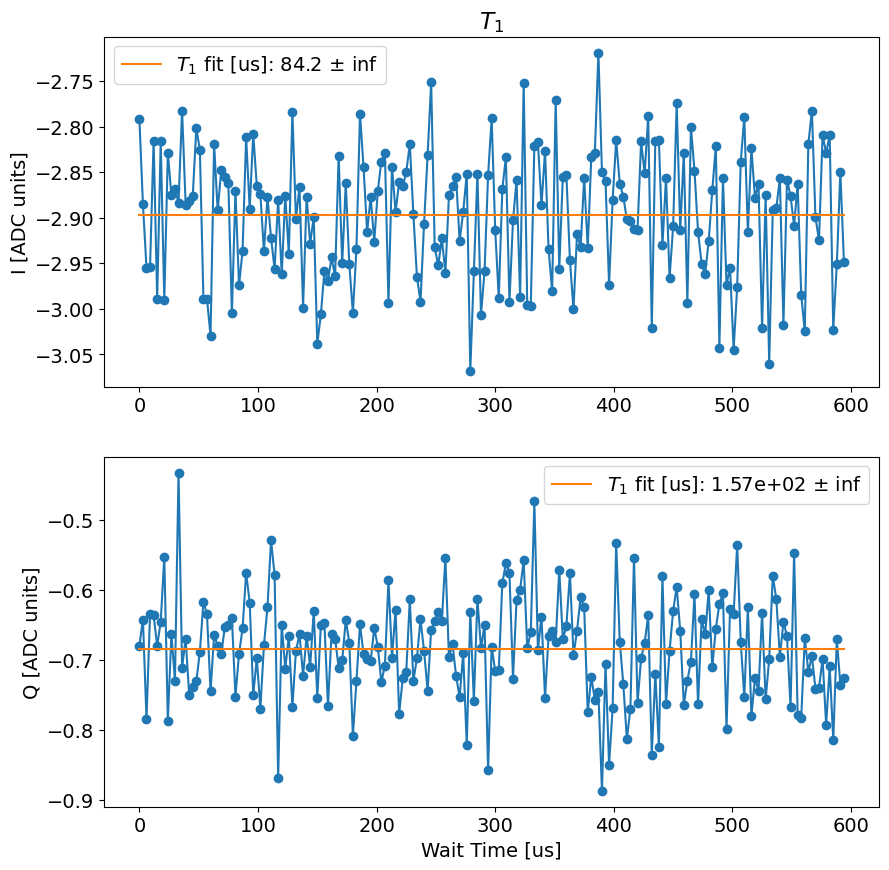

t1_i error:fit ratio= inf
t1_q error:fit ratio= inf
t1_q is better, saving t1_q to results cfg file
*Set cfg qubit 5 T1 to 156.99288190661792* us


  0%|          | 0/10000 [00:00<?, ?it/s]

Fit T1 avgi [us]: 269.7286448282265
Fit T1 avgq [us]: 226518.5754800715


  0%|          | 0/10000 [00:00<?, ?it/s]

Fit T1 avgi [us]: 109.13651179736091
Fit T1 avgq [us]: 81.78839507929999


  0%|          | 0/10000 [00:00<?, ?it/s]

Fit T1 avgi [us]: 96.0
Fit T1 avgq [us]: 73.38450095424535


  0%|          | 0/10000 [00:00<?, ?it/s]

Fit T1 avgi [us]: 2.51802583854772
Fit T1 avgq [us]: 344321.99492579873


  0%|          | 0/10000 [00:00<?, ?it/s]

Fit T1 avgi [us]: 554090.1480375236
Fit T1 avgq [us]: 96.0


  0%|          | 0/10000 [00:00<?, ?it/s]

Fit T1 avgi [us]: 86.11359128690766
Fit T1 avgq [us]: 31.404217603781987


  0%|          | 0/10000 [00:00<?, ?it/s]

Fit T1 avgi [us]: 3.5215492737132954
Fit T1 avgq [us]: 30.620453754752116


  0%|          | 0/10000 [00:00<?, ?it/s]

Fit T1 avgi [us]: 96.0
Fit T1 avgq [us]: 96.0


  0%|          | 0/10000 [00:00<?, ?it/s]

Fit T1 avgi [us]: 42.04797120123803
Fit T1 avgq [us]: 0.10850683304581968


  0%|          | 0/10000 [00:00<?, ?it/s]

Fit T1 avgi [us]: -100.2186018434839
Fit T1 avgq [us]: 3986.743121022114


c:\Users\slab\anaconda3\envs\slab\lib\site-packages\numpy\core\_methods.py:118: RuntimeWarning: invalid value encountered in reduce
  ret = umr_sum(arr, axis, dtype, out, keepdims, where=where)


  0%|          | 0/10000 [00:00<?, ?it/s]

Fit T1 avgi [us]: 472834.9797935842
Fit T1 avgq [us]: 56.25222724628685


  0%|          | 0/10000 [00:00<?, ?it/s]

Fit T1 avgi [us]: 24.178656139198445
Fit T1 avgq [us]: -40.90139729610817


  0%|          | 0/10000 [00:00<?, ?it/s]

Fit T1 avgi [us]: 4.008047270124267
Fit T1 avgq [us]: 1.4261801653926092


  0%|          | 0/10000 [00:00<?, ?it/s]

Fit T1 avgi [us]: 45.97854789852042
Fit T1 avgq [us]: 96.0


  0%|          | 0/10000 [00:00<?, ?it/s]

Fit T1 avgi [us]: 96.0
Fit T1 avgq [us]: 46.75743192965158


  0%|          | 0/10000 [00:00<?, ?it/s]

Fit T1 avgi [us]: 3297.7669929832887
Fit T1 avgq [us]: 16.591826931720192


  0%|          | 0/10000 [00:00<?, ?it/s]

Fit T1 avgi [us]: 0.8506411383090926
Fit T1 avgq [us]: 26.86299556880675


  0%|          | 0/10000 [00:00<?, ?it/s]

Fit T1 avgi [us]: 16.587664259701697
Fit T1 avgq [us]: 160.19567392696132


  0%|          | 0/10000 [00:00<?, ?it/s]

Fit T1 avgi [us]: 315.8188039334504
Fit T1 avgq [us]: 586890.4667586798


  0%|          | 0/10000 [00:00<?, ?it/s]

c:\_Lib\python\rfsoc\elaine_rfsoc\slab_rfsoc_expts\experiments\single_qubit\t1.py:261: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  plt.figure(figsize=(10,10))


Fit T1 avgi [us]: 3.060436176290055
Fit T1 avgq [us]: 51.238369327419846


  0%|          | 0/10000 [00:00<?, ?it/s]

c:\_Lib\python\rfsoc\elaine_rfsoc\slab_rfsoc_expts\experiments\fitting.py:65: RuntimeWarning: overflow encountered in multiply
  return y0 + yscale*np.exp(-(x-x0)/decay)


Fit T1 avgi [us]: 67.7779110442374
Fit T1 avgq [us]: 96.0


  0%|          | 0/10000 [00:00<?, ?it/s]

Fit T1 avgi [us]: 2.1516975839185446
Fit T1 avgq [us]: 3.3827507594406505


  0%|          | 0/10000 [00:00<?, ?it/s]

Fit T1 avgi [us]: 13.058464706166816
Fit T1 avgq [us]: -222.82941867954185


  0%|          | 0/10000 [00:00<?, ?it/s]

Fit T1 avgi [us]: -24.44693275567792
Fit T1 avgq [us]: 3.1400987006955927


  0%|          | 0/10000 [00:00<?, ?it/s]

Fit T1 avgi [us]: 62.1871640398733
Fit T1 avgq [us]: 434672.9246479506


  0%|          | 0/10000 [00:00<?, ?it/s]

Fit T1 avgi [us]: 4.011001193266722
Fit T1 avgq [us]: 252164.69921150096


  0%|          | 0/10000 [00:00<?, ?it/s]

Fit T1 avgi [us]: 87.79134823737752
Fit T1 avgq [us]: 178.60989269687596


  0%|          | 0/10000 [00:00<?, ?it/s]

Fit T1 avgi [us]: 265.64060601516945
Fit T1 avgq [us]: 57.29627334468581


  0%|          | 0/10000 [00:00<?, ?it/s]

Fit T1 avgi [us]: 25.61642034320003
Fit T1 avgq [us]: 8.79706633794214


  0%|          | 0/10000 [00:00<?, ?it/s]

Fit T1 avgi [us]: 20.965202183375414
Fit T1 avgq [us]: 1.432531279874421


  0%|          | 0/10000 [00:00<?, ?it/s]

Fit T1 avgi [us]: 42.92783082205644
Fit T1 avgq [us]: 41.92276031265051


  0%|          | 0/10000 [00:00<?, ?it/s]

Fit T1 avgi [us]: 6.745746890930235
Fit T1 avgq [us]: 3.0497226132366015


  0%|          | 0/10000 [00:00<?, ?it/s]

Fit T1 avgi [us]: 183333.11605789032
Fit T1 avgq [us]: 3.1659088277361356


  0%|          | 0/10000 [00:00<?, ?it/s]

Fit T1 avgi [us]: 39.57413677416913
Fit T1 avgq [us]: 108.72112508470765


  0%|          | 0/10000 [00:00<?, ?it/s]

Fit T1 avgi [us]: 118.44769075777018
Fit T1 avgq [us]: 507087.1345103707


  0%|          | 0/10000 [00:00<?, ?it/s]

Fit T1 avgi [us]: 3.326623877913781
Fit T1 avgq [us]: 50.53136383699206


  0%|          | 0/10000 [00:00<?, ?it/s]

Fit T1 avgi [us]: 164.0173953784414
Fit T1 avgq [us]: 472447.7491594151


  0%|          | 0/10000 [00:00<?, ?it/s]

Fit T1 avgi [us]: 437.8413134754485
Fit T1 avgq [us]: 3.7161995475300484


  0%|          | 0/10000 [00:00<?, ?it/s]

Fit T1 avgi [us]: 26.701890959154085
Fit T1 avgq [us]: 2.5288588139410018


  0%|          | 0/10000 [00:00<?, ?it/s]

Fit T1 avgi [us]: -1357.6689375157694
Fit T1 avgq [us]: 617432.3844065951


c:\_Lib\python\rfsoc\elaine_rfsoc\slab_rfsoc_expts\experiments\single_qubit\t1.py:280: RuntimeWarning: invalid value encountered in sqrt
  captionStr = f'$T_1$ fit [us]: {p[3]:.3} $\pm$ {np.sqrt(pCov[3][3]):.3}'
c:\_Lib\python\rfsoc\elaine_rfsoc\slab_rfsoc_expts\experiments\single_qubit\t1.py:284: RuntimeWarning: invalid value encountered in sqrt
  data["err_ratio_q"] = np.sqrt(data['fit_err_avgq'][3][3])/data['fit_avgq'][3]


  0%|          | 0/10000 [00:00<?, ?it/s]

c:\_Lib\python\rfsoc\elaine_rfsoc\slab_rfsoc_expts\experiments\single_qubit\t1.py:268: RuntimeWarning: invalid value encountered in sqrt
  captionStr = f'$T_1$ fit [us]: {p[3]:.3} $\pm$ {np.sqrt(pCov[3][3]):.3}'
c:\_Lib\python\rfsoc\elaine_rfsoc\slab_rfsoc_expts\experiments\single_qubit\t1.py:272: RuntimeWarning: invalid value encountered in sqrt
  data["err_ratio_i"] = np.sqrt(data['fit_err_avgi'][3][3])/data['fit_avgi'][3]


Fit T1 avgi [us]: 724494.7805842893
Fit T1 avgq [us]: 56.67207235635972


  0%|          | 0/10000 [00:00<?, ?it/s]

Fit T1 avgi [us]: 150.55398246532667
Fit T1 avgq [us]: 82.89884211736846


  0%|          | 0/10000 [00:00<?, ?it/s]

Fit T1 avgi [us]: 87.51091070255957
Fit T1 avgq [us]: -1820.3079062431832


  0%|          | 0/10000 [00:00<?, ?it/s]

Fit T1 avgi [us]: 3.2045277725207346
Fit T1 avgq [us]: 27.427900870151802


  0%|          | 0/10000 [00:00<?, ?it/s]

Fit T1 avgi [us]: -1797.4667686689636
Fit T1 avgq [us]: 3.0115603233746295


  0%|          | 0/10000 [00:00<?, ?it/s]

Fit T1 avgi [us]: 96.0
Fit T1 avgq [us]: -492.70481405202247


  0%|          | 0/10000 [00:00<?, ?it/s]

Fit T1 avgi [us]: 118758.11906911952
Fit T1 avgq [us]: 48.22744965673015


  0%|          | 0/10000 [00:00<?, ?it/s]

Fit T1 avgi [us]: -44.873237966914644
Fit T1 avgq [us]: 29.847376902319624


  0%|          | 0/10000 [00:00<?, ?it/s]

Fit T1 avgi [us]: 1.860500759920879
Fit T1 avgq [us]: 33.941374813133805


  0%|          | 0/10000 [00:00<?, ?it/s]

Fit T1 avgi [us]: 3.6421998977244554
Fit T1 avgq [us]: 3.230108802520525


  0%|          | 0/10000 [00:00<?, ?it/s]

Fit T1 avgi [us]: 111.52217198789157
Fit T1 avgq [us]: 124.03590911327429


  0%|          | 0/10000 [00:00<?, ?it/s]

Fit T1 avgi [us]: -985.6863009011399
Fit T1 avgq [us]: 226.437925849741


  0%|          | 0/10000 [00:00<?, ?it/s]

Fit T1 avgi [us]: 96.0
Fit T1 avgq [us]: 28.640809640526637


  0%|          | 0/10000 [00:00<?, ?it/s]

Fit T1 avgi [us]: 541900.0681616241
Fit T1 avgq [us]: 46.71420975186375


  0%|          | 0/10000 [00:00<?, ?it/s]

Fit T1 avgi [us]: 3.2166600070159905
Fit T1 avgq [us]: 46.05292465354087


  0%|          | 0/10000 [00:00<?, ?it/s]

Fit T1 avgi [us]: 96.0
Fit T1 avgq [us]: 96.0


  0%|          | 0/10000 [00:00<?, ?it/s]

Fit T1 avgi [us]: 96.0
Fit T1 avgq [us]: -37.64711187173961


  0%|          | 0/10000 [00:00<?, ?it/s]

Fit T1 avgi [us]: 33.46954157707459
Fit T1 avgq [us]: 3.2302827161318226


  0%|          | 0/10000 [00:00<?, ?it/s]

Fit T1 avgi [us]: 96.0
Fit T1 avgq [us]: 3.4635552160054637


  0%|          | 0/10000 [00:00<?, ?it/s]

Fit T1 avgi [us]: -247.27615418809125
Fit T1 avgq [us]: 89.7351511655393


  0%|          | 0/10000 [00:00<?, ?it/s]

Fit T1 avgi [us]: 174275.91349754602
Fit T1 avgq [us]: 221.84981108172428


  0%|          | 0/10000 [00:00<?, ?it/s]

Fit T1 avgi [us]: 3.707522809168339
Fit T1 avgq [us]: -102.68727696795511


  0%|          | 0/10000 [00:00<?, ?it/s]

Fit T1 avgi [us]: 51.437146141675356
Fit T1 avgq [us]: 471875.1616476777


  0%|          | 0/10000 [00:00<?, ?it/s]

Fit T1 avgi [us]: 3.202358289909795
Fit T1 avgq [us]: -534260.5003698119


  0%|          | 0/10000 [00:00<?, ?it/s]

Fit T1 avgi [us]: 87.81957463718992
Fit T1 avgq [us]: 102.05356693208127


  0%|          | 0/10000 [00:00<?, ?it/s]

Fit T1 avgi [us]: 605393.4291759674
Fit T1 avgq [us]: -48.06826649304435


  0%|          | 0/10000 [00:00<?, ?it/s]

Fit T1 avgi [us]: -155.33659093965832
Fit T1 avgq [us]: 2.9273903856488133


  0%|          | 0/10000 [00:00<?, ?it/s]

Fit T1 avgi [us]: 96.0
Fit T1 avgq [us]: 389728.0124839058


  0%|          | 0/10000 [00:00<?, ?it/s]

Fit T1 avgi [us]: -23.185447627167093
Fit T1 avgq [us]: 111810.80318760352


  0%|          | 0/10000 [00:00<?, ?it/s]

Fit T1 avgi [us]: 150.39337165609186
Fit T1 avgq [us]: 50.084992224045855


  0%|          | 0/10000 [00:00<?, ?it/s]

Fit T1 avgi [us]: 2.444811739018636
Fit T1 avgq [us]: -252.74303399331978


  0%|          | 0/10000 [00:00<?, ?it/s]

Fit T1 avgi [us]: 96.0
Fit T1 avgq [us]: -465719.87673269404


  0%|          | 0/10000 [00:00<?, ?it/s]

Fit T1 avgi [us]: 223829.79124038655
Fit T1 avgq [us]: 236217.4676027304


  0%|          | 0/10000 [00:00<?, ?it/s]

Fit T1 avgi [us]: -111.88154890516833
Fit T1 avgq [us]: -464.07994357616303


  0%|          | 0/10000 [00:00<?, ?it/s]

Fit T1 avgi [us]: 281372.6943956162
Fit T1 avgq [us]: 44.47131652841534


  0%|          | 0/10000 [00:00<?, ?it/s]

Fit T1 avgi [us]: 2.9709984260383604
Fit T1 avgq [us]: 67.73694284505872


  0%|          | 0/10000 [00:00<?, ?it/s]

Fit T1 avgi [us]: 18.510797724797865
Fit T1 avgq [us]: 532.447754477215


  0%|          | 0/10000 [00:00<?, ?it/s]

Fit T1 avgi [us]: 96.0
Fit T1 avgq [us]: 25.36650254796004


  0%|          | 0/10000 [00:00<?, ?it/s]

Fit T1 avgi [us]: 3.651642782515697
Fit T1 avgq [us]: 105.30798921111725


  0%|          | 0/10000 [00:00<?, ?it/s]

Fit T1 avgi [us]: -178.94164311835948
Fit T1 avgq [us]: 366957.54429447


  0%|          | 0/10000 [00:00<?, ?it/s]

Fit T1 avgi [us]: 420761.25085009076
Fit T1 avgq [us]: -2933.8285273232746


  0%|          | 0/10000 [00:00<?, ?it/s]

Fit T1 avgi [us]: 442.69708180509883
Fit T1 avgq [us]: 890.1600317571674


  0%|          | 0/10000 [00:00<?, ?it/s]

Fit T1 avgi [us]: 426896.3105946319
Fit T1 avgq [us]: 249.34403568373807


  0%|          | 0/10000 [00:00<?, ?it/s]

Fit T1 avgi [us]: 2.495797821759584
Fit T1 avgq [us]: 31.000122935456076


  0%|          | 0/10000 [00:00<?, ?it/s]

Fit T1 avgi [us]: 91.07983610199797
Fit T1 avgq [us]: 62.34476484816991


  0%|          | 0/10000 [00:00<?, ?it/s]

Fit T1 avgi [us]: 3.2107073270865434
Fit T1 avgq [us]: -114.91249989706958


  0%|          | 0/10000 [00:00<?, ?it/s]

Fit T1 avgi [us]: 175.72779199301544
Fit T1 avgq [us]: 516.8618292073111


  0%|          | 0/10000 [00:00<?, ?it/s]

Fit T1 avgi [us]: 2866.893957048978
Fit T1 avgq [us]: 1.9298930721393464


  0%|          | 0/10000 [00:00<?, ?it/s]

Fit T1 avgi [us]: 3.460301381881643
Fit T1 avgq [us]: 77.54712432905454


  0%|          | 0/10000 [00:00<?, ?it/s]

Fit T1 avgi [us]: 96.0
Fit T1 avgq [us]: -1549.5202351914654


  0%|          | 0/10000 [00:00<?, ?it/s]

Fit T1 avgi [us]: 3.6208201348516
Fit T1 avgq [us]: -47.3729024646326


  0%|          | 0/10000 [00:00<?, ?it/s]

Fit T1 avgi [us]: 3.165140759560065
Fit T1 avgq [us]: 48.64722961574915


  0%|          | 0/10000 [00:00<?, ?it/s]

Fit T1 avgi [us]: 37.85498814419953
Fit T1 avgq [us]: 238166.07076882196


  0%|          | 0/10000 [00:00<?, ?it/s]

Fit T1 avgi [us]: 136.1735630087902
Fit T1 avgq [us]: 1027.579397470789


  0%|          | 0/10000 [00:00<?, ?it/s]

Fit T1 avgi [us]: 185.13161023670187
Fit T1 avgq [us]: 88850.5883233993


  0%|          | 0/10000 [00:00<?, ?it/s]

Fit T1 avgi [us]: 329.4788919603068
Fit T1 avgq [us]: 122.74331937032903


  0%|          | 0/10000 [00:00<?, ?it/s]

Fit T1 avgi [us]: 44.4353529524416
Fit T1 avgq [us]: 41.45954745091461


  0%|          | 0/10000 [00:00<?, ?it/s]

Fit T1 avgi [us]: 3.338977277822151
Fit T1 avgq [us]: 112.99938408073862


  0%|          | 0/10000 [00:00<?, ?it/s]

Fit T1 avgi [us]: 3.5379352274132003
Fit T1 avgq [us]: 2007.626106764435


  0%|          | 0/10000 [00:00<?, ?it/s]

Fit T1 avgi [us]: 63.95971596398917
Fit T1 avgq [us]: 239.29862257706438


  0%|          | 0/10000 [00:00<?, ?it/s]

Fit T1 avgi [us]: 18.410487740639837
Fit T1 avgq [us]: 96.0


  0%|          | 0/10000 [00:00<?, ?it/s]

Fit T1 avgi [us]: 207.91534178367633
Fit T1 avgq [us]: 90.165141827965


  0%|          | 0/10000 [00:00<?, ?it/s]

Fit T1 avgi [us]: 315.1959355416184
Fit T1 avgq [us]: 58.78195651027535


  0%|          | 0/10000 [00:00<?, ?it/s]

Fit T1 avgi [us]: 3.3343641258861454
Fit T1 avgq [us]: 3.725086101280088


  0%|          | 0/10000 [00:00<?, ?it/s]

Fit T1 avgi [us]: 30.10671592876147
Fit T1 avgq [us]: 669.3150764453035


  0%|          | 0/10000 [00:00<?, ?it/s]

Fit T1 avgi [us]: 768.6687686214865
Fit T1 avgq [us]: 11.597642380975415


  0%|          | 0/10000 [00:00<?, ?it/s]

Fit T1 avgi [us]: 96.0
Fit T1 avgq [us]: -4.73399275479363


  0%|          | 0/10000 [00:00<?, ?it/s]

Fit T1 avgi [us]: 94.80120668906126
Fit T1 avgq [us]: 2905.7606111985037


  0%|          | 0/10000 [00:00<?, ?it/s]

Fit T1 avgi [us]: 319261.86202614533
Fit T1 avgq [us]: 3.043215261980952


  0%|          | 0/10000 [00:00<?, ?it/s]

Fit T1 avgi [us]: -160.94427591203623
Fit T1 avgq [us]: 96.0


  0%|          | 0/10000 [00:00<?, ?it/s]

Fit T1 avgi [us]: 97.29884644807899
Fit T1 avgq [us]: -672.2147649591013


  0%|          | 0/10000 [00:00<?, ?it/s]

Fit T1 avgi [us]: -418.5533345255927
Fit T1 avgq [us]: -88.60329352347966


  0%|          | 0/10000 [00:00<?, ?it/s]

Fit T1 avgi [us]: -1078.0432862568478
Fit T1 avgq [us]: 73.28304110720343


  0%|          | 0/10000 [00:00<?, ?it/s]

Fit T1 avgi [us]: 96.0
Fit T1 avgq [us]: -57.028592882178856


  0%|          | 0/10000 [00:00<?, ?it/s]

Fit T1 avgi [us]: 21.945660067883253
Fit T1 avgq [us]: 29.15096167030776


  0%|          | 0/10000 [00:00<?, ?it/s]

Fit T1 avgi [us]: 82.02558200194505
Fit T1 avgq [us]: 952.3752600620069


  0%|          | 0/10000 [00:00<?, ?it/s]

Fit T1 avgi [us]: 123.57956954351502
Fit T1 avgq [us]: 396391.81092425226


  0%|          | 0/10000 [00:00<?, ?it/s]

Fit T1 avgi [us]: 31.600329945166987
Fit T1 avgq [us]: -107.26381462610368


  0%|          | 0/10000 [00:00<?, ?it/s]

Fit T1 avgi [us]: -349.4819215577085
Fit T1 avgq [us]: 324310.6054769412


  0%|          | 0/10000 [00:00<?, ?it/s]

Fit T1 avgi [us]: 161.99346365153315
Fit T1 avgq [us]: 111.02499736954066


  0%|          | 0/10000 [00:00<?, ?it/s]

Fit T1 avgi [us]: 66.12772327270467
Fit T1 avgq [us]: 29.937580988281397


  0%|          | 0/10000 [00:00<?, ?it/s]

Fit T1 avgi [us]: 1.8283314972535527
Fit T1 avgq [us]: 368.13978773981205


  0%|          | 0/10000 [00:00<?, ?it/s]

Fit T1 avgi [us]: 120990.96206605126
Fit T1 avgq [us]: 711040.4361583161


  0%|          | 0/10000 [00:00<?, ?it/s]

Fit T1 avgi [us]: 129.47563410914947
Fit T1 avgq [us]: 3.459817540977769


  0%|          | 0/10000 [00:00<?, ?it/s]

Fit T1 avgi [us]: 14.750495290467596
Fit T1 avgq [us]: 173.39075067194645


  0%|          | 0/10000 [00:00<?, ?it/s]

Fit T1 avgi [us]: 145.22842239477887
Fit T1 avgq [us]: 471199.3389904717


  0%|          | 0/10000 [00:00<?, ?it/s]

Fit T1 avgi [us]: -95.21142746453259
Fit T1 avgq [us]: 71.2103372350715


  0%|          | 0/10000 [00:00<?, ?it/s]

Fit T1 avgi [us]: 234.17316793786878
Fit T1 avgq [us]: 145.91517333601467


  0%|          | 0/10000 [00:00<?, ?it/s]

Fit T1 avgi [us]: 198.39210253005595
Fit T1 avgq [us]: 3.570390615027425


  0%|          | 0/10000 [00:00<?, ?it/s]

Fit T1 avgi [us]: 241.25468722199986
Fit T1 avgq [us]: 71.30281422695298


  0%|          | 0/10000 [00:00<?, ?it/s]

Fit T1 avgi [us]: 93.95348137312679
Fit T1 avgq [us]: 36.499800352975946


  0%|          | 0/10000 [00:00<?, ?it/s]

Fit T1 avgi [us]: 72.78261083080785
Fit T1 avgq [us]: 131397.73138347332


  0%|          | 0/10000 [00:00<?, ?it/s]

Fit T1 avgi [us]: 529.2869636909536
Fit T1 avgq [us]: 320865.34148818953


  0%|          | 0/10000 [00:00<?, ?it/s]

Fit T1 avgi [us]: 392657.8480779258
Fit T1 avgq [us]: 3.2880399881607105


  0%|          | 0/10000 [00:00<?, ?it/s]

Fit T1 avgi [us]: -129.91844625130742
Fit T1 avgq [us]: 96.0


  0%|          | 0/10000 [00:00<?, ?it/s]

Fit T1 avgi [us]: 3.7186034502188794
Fit T1 avgq [us]: 476.5301931529121


  0%|          | 0/10000 [00:00<?, ?it/s]

Fit T1 avgi [us]: 325.31693077048743
Fit T1 avgq [us]: -74.66622194619364


  0%|          | 0/10000 [00:00<?, ?it/s]

Fit T1 avgi [us]: 297.4966046384727
Fit T1 avgq [us]: 65.55126026051892


  0%|          | 0/10000 [00:00<?, ?it/s]

Fit T1 avgi [us]: 0.7451556659609483
Fit T1 avgq [us]: 37.11925858480088


  0%|          | 0/10000 [00:00<?, ?it/s]

Fit T1 avgi [us]: 124.33800181217057
Fit T1 avgq [us]: -188.48816092598594


  0%|          | 0/10000 [00:00<?, ?it/s]

Fit T1 avgi [us]: 2149.5118291898552
Fit T1 avgq [us]: 150.737460917662


  0%|          | 0/10000 [00:00<?, ?it/s]

Fit T1 avgi [us]: 176.81438838641606
Fit T1 avgq [us]: 17.399497981332026


  0%|          | 0/10000 [00:00<?, ?it/s]

Fit T1 avgi [us]: 113.14983674568951
Fit T1 avgq [us]: 96.0


  0%|          | 0/10000 [00:00<?, ?it/s]

Fit T1 avgi [us]: 204.27396743119854
Fit T1 avgq [us]: 173.21061295834826


  0%|          | 0/10000 [00:00<?, ?it/s]

Fit T1 avgi [us]: 78.43739528029592
Fit T1 avgq [us]: -4834.115261215746


  0%|          | 0/10000 [00:00<?, ?it/s]

Fit T1 avgi [us]: 45.713740384637376
Fit T1 avgq [us]: 23.603967107354638


  0%|          | 0/10000 [00:00<?, ?it/s]

Fit T1 avgi [us]: 96.0
Fit T1 avgq [us]: 266.0579993913009


  0%|          | 0/10000 [00:00<?, ?it/s]

Fit T1 avgi [us]: 2.667128712061377
Fit T1 avgq [us]: 3.400968917732558


  0%|          | 0/10000 [00:00<?, ?it/s]

Fit T1 avgi [us]: 86.56874678122578
Fit T1 avgq [us]: 175.44476772585531


  0%|          | 0/10000 [00:00<?, ?it/s]

Fit T1 avgi [us]: 164.86742807562615
Fit T1 avgq [us]: 101.05216965456134


  0%|          | 0/10000 [00:00<?, ?it/s]

Fit T1 avgi [us]: -439.30980487772354
Fit T1 avgq [us]: 226.6952888856318


  0%|          | 0/10000 [00:00<?, ?it/s]

Fit T1 avgi [us]: 96.0
Fit T1 avgq [us]: 3.3400799218326136


  0%|          | 0/10000 [00:00<?, ?it/s]

Fit T1 avgi [us]: 1789.8550050267252
Fit T1 avgq [us]: 120.85718293278477


  0%|          | 0/10000 [00:00<?, ?it/s]

Fit T1 avgi [us]: 3.576204189193646
Fit T1 avgq [us]: 327.7765596662512


  0%|          | 0/10000 [00:00<?, ?it/s]

Fit T1 avgi [us]: 112.41562493034787
Fit T1 avgq [us]: -189.8260693443737


  0%|          | 0/10000 [00:00<?, ?it/s]

Fit T1 avgi [us]: 95.45637244747368
Fit T1 avgq [us]: 150.31796867533848


  0%|          | 0/10000 [00:00<?, ?it/s]

Fit T1 avgi [us]: 0.05238631149567041
Fit T1 avgq [us]: 166465.66513876265


  0%|          | 0/10000 [00:00<?, ?it/s]

Fit T1 avgi [us]: 32.7719680418868
Fit T1 avgq [us]: 288994.5253557772


  0%|          | 0/10000 [00:00<?, ?it/s]

Fit T1 avgi [us]: 128.65069057896966
Fit T1 avgq [us]: 3.106413314541864


  0%|          | 0/10000 [00:00<?, ?it/s]

Fit T1 avgi [us]: 54.4450984237929
Fit T1 avgq [us]: 443.3894391743487


  0%|          | 0/10000 [00:00<?, ?it/s]

Fit T1 avgi [us]: 91.62689893801226
Fit T1 avgq [us]: 3.242673585444785


  0%|          | 0/10000 [00:00<?, ?it/s]

Fit T1 avgi [us]: 108.67553869079875
Fit T1 avgq [us]: 3.1245966992592127


  0%|          | 0/10000 [00:00<?, ?it/s]

Fit T1 avgi [us]: 149.0395376132583
Fit T1 avgq [us]: 92.00597208135348


  0%|          | 0/10000 [00:00<?, ?it/s]

Fit T1 avgi [us]: 586057.272041226
Fit T1 avgq [us]: 3.1733076037115766


  0%|          | 0/10000 [00:00<?, ?it/s]

Fit T1 avgi [us]: 103.48130298064682
Fit T1 avgq [us]: 1987.606859611432


  0%|          | 0/10000 [00:00<?, ?it/s]

Fit T1 avgi [us]: 2.800964161187737
Fit T1 avgq [us]: 154.5813864659133


  0%|          | 0/10000 [00:00<?, ?it/s]

Fit T1 avgi [us]: 2.428970576508821
Fit T1 avgq [us]: 3.9802541274991246


  0%|          | 0/10000 [00:00<?, ?it/s]

Fit T1 avgi [us]: 2.8217423236326153
Fit T1 avgq [us]: 137450.63843660115


  0%|          | 0/10000 [00:00<?, ?it/s]

Fit T1 avgi [us]: 243829.16978049726
Fit T1 avgq [us]: 909.265739370952


  0%|          | 0/10000 [00:00<?, ?it/s]

Fit T1 avgi [us]: 904.2021255523549
Fit T1 avgq [us]: 96.0


  0%|          | 0/10000 [00:00<?, ?it/s]

Fit T1 avgi [us]: 161.49772563895
Fit T1 avgq [us]: 2.834031826316839


  0%|          | 0/10000 [00:00<?, ?it/s]

Fit T1 avgi [us]: 251.57459734508697
Fit T1 avgq [us]: 2.979249582784593


  0%|          | 0/10000 [00:00<?, ?it/s]

Fit T1 avgi [us]: -1034.7504354651537
Fit T1 avgq [us]: 27.394821615173882


  0%|          | 0/10000 [00:00<?, ?it/s]

Fit T1 avgi [us]: 681.5771290934276
Fit T1 avgq [us]: 3.4242142699761007


  0%|          | 0/10000 [00:00<?, ?it/s]

Fit T1 avgi [us]: 109.28844728616525
Fit T1 avgq [us]: 361800.7888747807


  0%|          | 0/10000 [00:00<?, ?it/s]

Fit T1 avgi [us]: 296084.2046557604
Fit T1 avgq [us]: -253.99509736333079


  0%|          | 0/10000 [00:00<?, ?it/s]

Fit T1 avgi [us]: 72.64243398716208
Fit T1 avgq [us]: 148.83624291439912


  0%|          | 0/10000 [00:00<?, ?it/s]

Fit T1 avgi [us]: 1901.5634612676183
Fit T1 avgq [us]: 61.76472133522392


  0%|          | 0/10000 [00:00<?, ?it/s]

Fit T1 avgi [us]: 74.20231374281089
Fit T1 avgq [us]: 64.71549787765595


  0%|          | 0/10000 [00:00<?, ?it/s]

Fit T1 avgi [us]: -45.558881132590535
Fit T1 avgq [us]: 96.0


  0%|          | 0/10000 [00:00<?, ?it/s]

Fit T1 avgi [us]: 148.8884742320083
Fit T1 avgq [us]: 3.8558272500508872


  0%|          | 0/10000 [00:00<?, ?it/s]

Fit T1 avgi [us]: 96.0
Fit T1 avgq [us]: 81.57592504306426


  0%|          | 0/10000 [00:00<?, ?it/s]

Fit T1 avgi [us]: 96.0
Fit T1 avgq [us]: -419724.1229108043


  0%|          | 0/10000 [00:00<?, ?it/s]

Fit T1 avgi [us]: 59.55390173775942
Fit T1 avgq [us]: 90182.44184747065


  0%|          | 0/10000 [00:00<?, ?it/s]

Fit T1 avgi [us]: 26.520249175009944
Fit T1 avgq [us]: 46.82663723816161


  0%|          | 0/10000 [00:00<?, ?it/s]

Fit T1 avgi [us]: 259.579892285424
Fit T1 avgq [us]: 96.0


  0%|          | 0/10000 [00:00<?, ?it/s]

Fit T1 avgi [us]: 2.0782648324408455
Fit T1 avgq [us]: 3.1968238046233277


  0%|          | 0/10000 [00:00<?, ?it/s]

Fit T1 avgi [us]: 315738.30449043907
Fit T1 avgq [us]: 0.4289517731306785


  0%|          | 0/10000 [00:00<?, ?it/s]

Fit T1 avgi [us]: 210.74474983163557
Fit T1 avgq [us]: 182.61604742308614


  0%|          | 0/10000 [00:00<?, ?it/s]

Fit T1 avgi [us]: 48.491693557970294
Fit T1 avgq [us]: 221134.77733498867


  0%|          | 0/10000 [00:00<?, ?it/s]

Fit T1 avgi [us]: 26.003037401726953
Fit T1 avgq [us]: 23.571621899978464


  0%|          | 0/10000 [00:00<?, ?it/s]

Fit T1 avgi [us]: 96.0
Fit T1 avgq [us]: 96.0


  0%|          | 0/10000 [00:00<?, ?it/s]

Fit T1 avgi [us]: 77.20263824841997
Fit T1 avgq [us]: 96.0


  0%|          | 0/10000 [00:00<?, ?it/s]

Fit T1 avgi [us]: 68.83971117500799
Fit T1 avgq [us]: 347175.6363311147


  0%|          | 0/10000 [00:00<?, ?it/s]

Fit T1 avgi [us]: 196.5795933469816
Fit T1 avgq [us]: 240478.33841417232


  0%|          | 0/10000 [00:00<?, ?it/s]

Fit T1 avgi [us]: 123.16552040614008
Fit T1 avgq [us]: 35.393739609067005


  0%|          | 0/10000 [00:00<?, ?it/s]

Fit T1 avgi [us]: -9.983627803677024
Fit T1 avgq [us]: 48.277292693911726


  0%|          | 0/10000 [00:00<?, ?it/s]

Fit T1 avgi [us]: 85.20007704600636
Fit T1 avgq [us]: -255.0909814206244


  0%|          | 0/10000 [00:00<?, ?it/s]

Fit T1 avgi [us]: 514.3663517664072
Fit T1 avgq [us]: 573698.9836720602


  0%|          | 0/10000 [00:00<?, ?it/s]

Fit T1 avgi [us]: 164510.77213323954
Fit T1 avgq [us]: 2.8782355535439264


  0%|          | 0/10000 [00:00<?, ?it/s]

Fit T1 avgi [us]: 421022.91976848146
Fit T1 avgq [us]: 96.0


  0%|          | 0/10000 [00:00<?, ?it/s]

Fit T1 avgi [us]: 125.2928005609761
Fit T1 avgq [us]: 27.978025493088765


  0%|          | 0/10000 [00:00<?, ?it/s]

Fit T1 avgi [us]: 1.8211777444074366
Fit T1 avgq [us]: 23.461367436879055


  0%|          | 0/10000 [00:00<?, ?it/s]

Fit T1 avgi [us]: 294.1885964836984
Fit T1 avgq [us]: 495.4178386347063


  0%|          | 0/10000 [00:00<?, ?it/s]

Fit T1 avgi [us]: 542.355840133167
Fit T1 avgq [us]: 120.0347527675704


  0%|          | 0/10000 [00:00<?, ?it/s]

Fit T1 avgi [us]: 96.0
Fit T1 avgq [us]: 69.17309900961736


  0%|          | 0/10000 [00:00<?, ?it/s]

Fit T1 avgi [us]: 270.47273855482615
Fit T1 avgq [us]: 150616.46619259112


  0%|          | 0/10000 [00:00<?, ?it/s]

Fit T1 avgi [us]: 87.43625937028212
Fit T1 avgq [us]: 96.0


  0%|          | 0/10000 [00:00<?, ?it/s]

Fit T1 avgi [us]: 2.6257510621300586
Fit T1 avgq [us]: 313794.3176998472


  0%|          | 0/10000 [00:00<?, ?it/s]

Fit T1 avgi [us]: 77.75638954032154
Fit T1 avgq [us]: 55.0964107466908


  0%|          | 0/10000 [00:00<?, ?it/s]

Fit T1 avgi [us]: 509.8116108578458
Fit T1 avgq [us]: 28.24497207504315


KeyboardInterrupt: 

In [9]:
for k in range(len(auto_cfg.device.readout.frequency)): # define how many resonators you have (and thus how many qubits)
  print('Running analysis for qubit: ', k, '...')
  # ---------------------------------------------------------------------------- #
  # Resonator Spectroscopy
  qubit_i = k 
  rspec = meas.ResonatorSpectroscopyExperiment(
      soccfg=soc,
      path=expt_path,
      prefix=f"resonator_spectroscopy_qubit{qubit_i}",
      config_file=results_config_path,   
  )
  span = 10 # MHz
  npts = 500 

  rspec.cfg.expt = dict(
      start=rspec.cfg.device.readout.frequency[qubit_i]-span/2, # resonator 
      step=span/npts, # min step ~1 Hz
      expts=npts, # Number experiments stepping from start
      reps= 500, # Number averages per point 500
      pulse_e=False, # add ge pi pulse prior to measurement
      pulse_f=False, # add ef pi pulse prior to measurement
      qubit=qubit_i,
  )

  rspec.cfg.device.readout.relax_delay = 5 # Wait time between experiments [us]
  rspec.go(analyze=False, display=False, progress=True, save=False)

  rspec.analyze(fit=True, findpeaks=False)
  rspec.display(fit=True, findpeaks=False)


  # open the results config file 
  with open(results_config_file,'r') as file:
    auto_cfg=AttrDict(yaml.safe_load(file)) # turn it into an attribute dictionary 

  # assign the resonator frequency to the results config file
  auto_cfg.device.readout.frequency[qubit_i] = float(rspec.data['lorentz_fit'][2])
  auto_cfg.device.readout.kappa[qubit_i] = float(2*rspec.data['lorentz_fit'][3])  

  auto_cfg= yaml.safe_dump(auto_cfg.to_dict(), default_flow_style=  True)

  # write it: 
  with open('autocalibration_cfg.yml', 'w') as modified_file:
    modified_file.write(auto_cfg)
  # now, open the modified file again 
  with open('autocalibration_cfg.yml','r') as file:
    auto_cfg=AttrDict(yaml.safe_load(file)) # turn it into an attribute dictionary 

  print(f'*Set cfg res {qubit_i} freq to {auto_cfg.device.readout.frequency[qubit_i]} Mhz*')
  print(f'*Set cfg res {qubit_i} kappa to {auto_cfg.device.readout.kappa[qubit_i]} MHz*')
  # ---------------------------------------------------------------------------- #
  # Qubit Spectroscopy
  qspec = meas.PulseProbeSpectroscopyExperiment(
      soccfg=soc,
      path = expt_path, 
      prefix = f"qubit_spectroscopy_qubit{qubit_i}",
      config_file=results_config_path,
      )

  span = 10 
  npts = 500

  qspec.cfg.expt = dict(
      start= qspec.cfg.device.qubit.f_ge[qubit_i]-span/2, # qubit frequency to be mixed up [MHz]
      step = span/npts, # min step ~1 Hz
      expts = npts, # Number experiments stepping from start
      reps = 50, # Number averages per point
      rounds = 20, #Number of start to finish sweeps to average over 
      length = 50, # qubit probe constant pulse length [us]
      gain = 100, #qubit pulse gain  
      pulse_type = 'const', 
      #pulse_type = 'gauss',  
      qubit = qubit_i,
  ) 

  qspec.cfg.device.readout.relax_delay = 10 # Wait time between experiments [us]
  qspec.go(analyze=False, display=False, progress=True, save=False)

  qspec.analyze(fit=True, signs = [1,-1,1])
  qspec.display(fit=True, signs= [1, -1, 1])

  # open the results config file 
  with open(results_config_file,'r') as file:
    auto_cfg=AttrDict(yaml.safe_load(file)) # turn it into an attribute dictionary 

  # assign the qubit frequency to the results config file
  auto_cfg.device.qubit.f_ge[qubit_i] = float(qspec.data["fit_amps"][2])
  auto_cfg.device.qubit.kappa[qubit_i] = float(2*qspec.data["fit_amps"][3])
  auto_cfg= yaml.safe_dump(auto_cfg.to_dict(), default_flow_style=  True) # dump it 

  # write it: 
  with open('autocalibration_cfg.yml', 'w') as modified_file:
    modified_file.write(auto_cfg)
  # now, open the modified file again 
  with open('autocalibration_cfg.yml','r') as file:
    auto_cfg=AttrDict(yaml.safe_load(file)) # turn it into an attribute dictionary 


  print(f'*Set cfg qubit {qubit_i} freq to {auto_cfg.device.qubit.f_ge[qubit_i]} MHz*')
  print(f'*Set cfg qubit {qubit_i} kappa to {auto_cfg.device.qubit.kappa[qubit_i]} MHz*')
  # ---------------------------------------------------------------------------- #
  # Length Rabi

  lengthrabi = meas.LengthRabiExperiment(
      soccfg=soc,
      path=expt_path,
      prefix=f"length_rabi_qubit{qubit_i}",
      config_file=results_config_path,
  )

  lengthrabi.cfg.expt = dict(
      start =  0.0025, 
      step=  soc.cycles2us(1), # [us] this is the samllest possible step size (size of clock cycle)
      expts= 100, #51 
      reps= 2000, #2000
      #gain= 1500, # qubit gain [DAC units],
      gain =  1000, #qubit gain [DAC units]
      #gain=lengthrabi.cfg.device.qubit.pulses.pi_ge.gain[qubit_i],
      pulse_type='gauss',
      # pulse_type='const',
      checkZZ=False,
      checkEF=False, 
      qubits=[qubit_i],
      num_pulses = 1, #number of pulses to play, must be an odd number 
  )

  import Pyro4.util
  try:
      lengthrabi.go(analyze=False, display=False, progress=True, save=False)
  except Exception:
      print("Pyro traceback:")
      print("".join(Pyro4.util.getPyroTraceback()))

  lengthrabi.analyze(fit=True)
  lengthrabi.display(fit=True)


  # save the pi pulse length to the results config file
  p = lengthrabi.data['fit_avgi']     
  if p[2] > 180: p[2] = p[2] - 360
  elif p[2] < -180: p[2] = p[2] + 360
  if p[2] < 0: pi_length = (1/2 - p[2]/180)/2/p[1]
  else: pi_length= (3/2 - p[2]/180)/2/p[1]

  # open the results config file 
  with open(results_config_file,'r') as file:
    auto_cfg=AttrDict(yaml.safe_load(file)) # turn it into an attribute dictionary

  auto_cfg.device.qubit.pulses.pi_ge.sigma[qubit_i] = float(pi_length)


  auto_cfg= yaml.safe_dump(auto_cfg.to_dict(), default_flow_style=  True) # dump it 

  # write it: 
  with open('autocalibration_cfg.yml', 'w') as modified_file:
    modified_file.write(auto_cfg)
  # now, open the modified file again 
  with open('autocalibration_cfg.yml','r') as file:
    auto_cfg=AttrDict(yaml.safe_load(file)) # turn it into an attribute dictionary 

  print(f'*Set cfg qubit {qubit_i} rabi length to {auto_cfg.device.qubit.pulses.pi_ge.sigma[qubit_i]}* us')


  # ---------------------------------------------------------------------------- #
  # Amplitude Rabi
  amprabi = meas.AmplitudeRabiExperiment(
      soccfg=soc,
      path=expt_path,
      prefix=f"amp_rabi_qubit{qubit_i}",
      config_file=results_config_path,
  )

  span = 2*auto_cfg.device.qubit.pulses.pi_ge.gain[qubit_i]
  npts = 200
  amprabi.cfg.expt = dict(
      # start=0, # qubit gain [dac level]
      # start=2047,
      start=0,
      step=int(span/npts), # [dac level]
      expts=npts,
      reps=100 * 10 ,
      rounds=1,
      sigma_test= auto_cfg.device.qubit.pulses.pi_ge.sigma[qubit_i], # gaussian sigma for pulse length - overrides config [us]
      checkZZ=False,
      checkEF=False, 
      qubits=[qubit_i],
      pulse_type='gauss',
      # pulse_type='const',
      num_pulses = 1, #number of pulses to play, must be an odd number in order to achieve a pi rotation at pi length/ num_pulses 
  )

  import Pyro4.util
  try:
      amprabi.go(analyze=False, display=False, progress=True, save=False)
  except Exception:
      print("Pyro traceback:")
      print("".join(Pyro4.util.getPyroTraceback()))

  amprabi.analyze(fit=True)
  amprabi.display(fit=True)

  p = amprabi.data['fit_avgi']
  if p[2] > 180: p[2] = p[2] - 360
  elif p[2] < -180: p[2] = p[2] + 360
  if p[2] < 0: pi_gain = (1/2 - p[2]/180)/2/p[1]
  else: pi_gain= (3/2 - p[2]/180)/2/p[1]

  # open the results config file 
  with open(results_config_file,'r') as file:
    auto_cfg=AttrDict(yaml.safe_load(file)) # turn it into an attribute dictionary

  auto_cfg.device.qubit.pulses.pi_ge.gain[qubit_i] = int(pi_gain)  # [DAC units]  

  auto_cfg= yaml.safe_dump(auto_cfg.to_dict(), default_flow_style=  True) # dump it 

  # write it: 
  with open('autocalibration_cfg.yml', 'w') as modified_file:
    modified_file.write(auto_cfg)
  # now, open the modified file again 
  with open('autocalibration_cfg.yml','r') as file:
    auto_cfg=AttrDict(yaml.safe_load(file)) # turn it into an attribute dictionary 

  print(f'*Set cfg qubit {qubit_i} rabi amplitude to {auto_cfg.device.qubit.pulses.pi_ge.gain[qubit_i]}* DAC units')



  # ---------------------------------------------------------------------------- #
  # T2R Rabi

  t2r = meas.RamseyExperiment(
      soccfg=soc,
      path=expt_path,
      prefix=f"ramsey_qubit{qubit_i}",
      config_file=results_config_path,
  )

  t2r.cfg.expt = dict(
      start=0, # wait time tau [us]
      #step=soc.cycles2us(10), # [us] make sure nyquist freq = 0.5 * (1/step) > ramsey (signal) freq!
      step= 0.5, # [us]
      expts=300,
      ramsey_freq=2.0, # [MHz]
      reps=10 * 20 , # 100 * 20 (on hardware --> on board itself) 
      rounds=1, # set this = 1 (computer asking for 20 rounds --> faster if I don't have to communicate between computer and board)
      qubits=[qubit_i],
      checkZZ=False,
      checkEF=False,
  )

  import Pyro4.util
  try:
      t2r.go(analyze=False, display=False, progress=True, save=False)
  except Exception:
      print("Pyro traceback:")
      print("".join(Pyro4.util.getPyroTraceback()))


  t2r.analyze(fit=True, fit_twofreq=False)
  t2r.display(fit=True, fit_twofreq=False)

  t2r_fit, t2r_fit_err, t2r_adjust = meas.fitting.get_best_fit(t2r.data, get_best_data_params=['f_adjust_ramsey'])

  old_qubit_freq = t2r.cfg.device.qubit.f_ge[qubit_i]

  # open the results config file 
  with open(results_config_file,'r') as file:
    auto_cfg=AttrDict(yaml.safe_load(file)) # turn it into an attribute dictionary


  if t2r_adjust[0] < t2r_adjust[1]:
      print(f'Replacing {old_qubit_freq} with {t2r_adjust[0]+ old_qubit_freq} in results cfg file') 
      auto_cfg.device.qubit.f_ge[qubit_i] = float(old_qubit_freq + t2r_adjust[0])  # [DAC units]
  else:       
      print(f'Replacing {old_qubit_freq} with {t2r_adjust[1] + old_qubit_freq} in results cfg file')
      auto_cfg.device.qubit.f_ge[qubit_i] = float(old_qubit_freq + t2r_adjust[1])  # [DAC units]

  auto_cfg= yaml.safe_dump(auto_cfg.to_dict(), default_flow_style=  True) # dump it 

  # write it: 
  with open('autocalibration_cfg.yml', 'w') as modified_file:
    modified_file.write(auto_cfg)
  # now, open the modified file again 
  with open('autocalibration_cfg.yml','r') as file:
    auto_cfg=AttrDict(yaml.safe_load(file)) # turn it into an attribute dictionary 



  # ---------------------------------------------------------------------------- #
  # Amplitude Rabi
  amprabi = meas.AmplitudeRabiExperiment(
      soccfg=soc,
      path=expt_path,
      prefix=f"amp_rabi_qubit{qubit_i}",
      config_file=results_config_path,
  )

  span = 3000
  npts = 200
  amprabi.cfg.expt = dict(
      start=100,
      step=int(span/npts), # [dac level]
      expts=npts,
      reps=100*10,
      rounds=1,
      sigma_test= auto_cfg.device.qubit.pulses.pi_ge.sigma[qubit_i], # gaussian sigma for pulse length - overrides config [us]
      checkZZ=False,
      checkEF=False, 
      qubits=[qubit_i],
      pulse_type='gauss',
      num_pulses = 1, 
  )

  import Pyro4.util
  try:
      amprabi.go(analyze=False, display=False, progress=True, save=False)
  except Exception:
      print("Pyro traceback:")
      print("".join(Pyro4.util.getPyroTraceback()))

  amprabi.analyze(fit=True)
  amprabi.display(fit=True)

  p = amprabi.data['fit_avgi']
  if p[2] > 180: p[2] = p[2] - 360
  elif p[2] < -180: p[2] = p[2] + 360
  if p[2] < 0: pi_gain = (1/2 - p[2]/180)/2/p[1]
  else: pi_gain= (3/2 - p[2]/180)/2/p[1]

  # open the results config file 
  with open(results_config_file,'r') as file:
    auto_cfg=AttrDict(yaml.safe_load(file)) # turn it into an attribute dictionary

  auto_cfg.device.qubit.pulses.pi_ge.gain[qubit_i] = int(pi_gain)  # [DAC units]  

  auto_cfg= yaml.safe_dump(auto_cfg.to_dict(), default_flow_style=  True) # dump it 

  # write it: 
  with open('autocalibration_cfg.yml', 'w') as modified_file:
    modified_file.write(auto_cfg)
  # now, open the modified file again 
  with open('autocalibration_cfg.yml','r') as file:
    auto_cfg=AttrDict(yaml.safe_load(file)) # turn it into an attribute dictionary 

  print(f'*Set cfg qubit {qubit_i} rabi amplitude to {auto_cfg.device.qubit.pulses.pi_ge.gain[qubit_i]}* DAC units')

  # ---------------------------------------------------------------------------- #
  # T1 
  t1 = meas.T1Experiment(
      soccfg=soc,
      path=expt_path,
      prefix=f"t1_qubit{qubit_i}",
      config_file= results_config_path,
  )

  span = 600 
  npts = 200

  t1.cfg.expt = dict(
    start=0, # wait time [us]
    step=int(span/npts), 
    expts=npts,
    reps=100*10, # number of times we repeat a time point 
    rounds=1, # number of start to finish sweeps to average over
    qubit=qubit_i,
    length_scan = span, # length of the scan in us
    num_saved_points = 10, # number of points to save for the T1 continuous scan 
  )

  t1.go(analyze=False, display=False, progress=True, save=False)
  t1.analyze(fit=True)
  t1.save_T1_Values()
  t1.display()

  t1_err_i = np.sqrt(t1.data['fit_err_avgi'][3][3])
  t1_fit_i =t1.data['fit_avgi'][3]
  err_ratio_i = t1_err_i/t1_fit_i
  print('t1_i error:fit ratio=', err_ratio_i)

  t1_err_q = np.sqrt(t1.data['fit_err_avgq'][3][3])
  t1_fit_q =t1.data['fit_avgq'][3]
  err_ratio_q = t1_err_q/t1_fit_q
  print('t1_q error:fit ratio=', err_ratio_q)

  # open the results config file 
  with open(results_config_file,'r') as file:
    auto_cfg=AttrDict(yaml.safe_load(file)) # turn it into an attribute dictionary

  if err_ratio_i< err_ratio_q:
      print('t1_i is better, saving T1_i to results cfg file') 
      auto_cfg.device.qubit.T1[qubit_i] = float(t1_fit_i)  # [DAC units]  

  else: 
      print('t1_q is better, saving t1_q to results cfg file')
      auto_cfg.device.qubit.T1[qubit_i] = float(t1_fit_q)  # [DAC units]  

  auto_cfg= yaml.safe_dump(auto_cfg.to_dict(), default_flow_style=  True) # dump it 

  # write it: 
  with open('autocalibration_cfg.yml', 'w') as modified_file:
    modified_file.write(auto_cfg)
  # now, open the modified file again 
  with open('autocalibration_cfg.yml','r') as file:
    auto_cfg=AttrDict(yaml.safe_load(file)) # turn it into an attribute dictionary 

  print(f'*Set cfg qubit {qubit_i} T1 to {auto_cfg.device.qubit.T1[qubit_i]}* us')

#-------------------------------------------------------------------------# Continuous T1  
# Run Continuous T1 on qubit 0
qubit_i = 0 
time_array = np.array([])
t1_i_array = np.array([])
t1_q_array = np.array([])   
t1_err_ratio_i = np.array([])
t1_err_ratio_q = np.array([]) 


time_array = np.append(time_array, t1.data['time'])
t1_i_array = np.append(t1_i_array, t1.data['fit_avgi'][3]) 
t1_q_array = np.append(t1_q_array, t1.data['fit_avgq'][3])  

plt.ion()
fig, ax = plt.subplots()
line, = ax.plot(time_array, t1_i_array, 'o', label = 't1_i')

while True:
    t1_cont = meas.T1Continuous(
        soccfg=soc,
        path=expt_path,
        prefix=f"t1_continuous_qubit{qubit_i}",
        config_file= results_config_path,
    )

    span = t1.cfg.expt.length_scan 
    npts = t1.cfg.expt.num_saved_points #eventually need to change this to t1.cfg.expt.num_saved_points

    t1_cont.cfg.expt = dict(
        start=0, # wait time [us]
        step=int(span/npts), 
        expts=npts,
        reps=100*10, # number of times we repeat a time point 
        rounds=1, # number of start to finish sweeps to average over
        qubit=qubit_i,
        prev_data_i = t1.data['avgi'],
        prev_data_q = t1.data['avgq'],
        prev_data_x = t1.data['xpts'],
    )

    t1_cont.go(analyze=True, display=True, progress=True, save=False)
    t1_cont.analyze(fit=True)

    # update the arrays
    time_array = np.append(time_array, t1_cont.data['time'])
    t1_i_array = np.append(t1_i_array, t1_cont.data["fit_avgi"][3])
    t1_q_array = np.append(t1_q_array, t1_cont.data["fit_avgq"][3])
    t1_err_ratio_i = np.append(t1_err_ratio_i, t1_cont.data["err_ratio_i"])
    t1_err_ratio_q = np.append(t1_err_ratio_q, t1_cont.data["err_ratio_q"])

    # update the plots to show the new T1 data
    line.set_xdata(time_array)
    line.set_ydata(t1_i_array) 

    # fig.canvas.flush_events()
    ax.relim()
    ax.autoscale_view()
    fig.canvas.draw()
    time.sleep(0.1)


    # figure out if the t1 error ratio has exceeded threshold (0.5*T1error_ratio)
    avg_err_ratio_i = np.mean(t1_err_ratio_i)
    avg_err_ratio_q = np.mean(t1_err_ratio_q)

    if avg_err_ratio_i > (0.5* t1.data["err_ratio_i"]):
        print('Average error ratio has exceeded threshold, stopping continuous T1. Recallibrate qubit.')
        break 

    if avg_err_ratio_q > (0.5* t1.data["err_ratio_q"]):
        print('Average error ratio has exceeded threshold, stopping continuous T1. Recallibrate qubit.')
        break 

## Continuous T1 for 2 Qubits

  0%|          | 0/200000 [00:00<?, ?it/s]

Fit T1 avgi [us]: 177.46967033548438
Fit T1 avgq [us]: 178.23236425325933


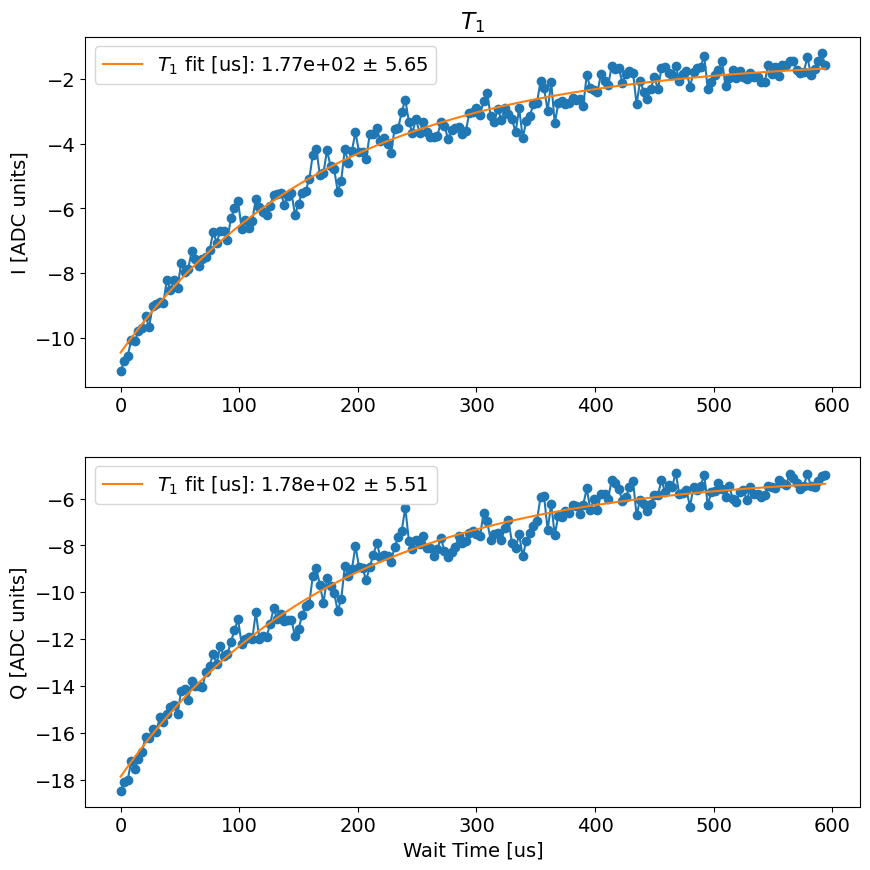

In [221]:
qubit_i = 4
t1 = meas.T1Experiment(
    soccfg=soc,
    path=expt_path,
    prefix=f"t1_qubit{qubit_i}",
    config_file= results_config_path,
)

span = 600 
npts = 200

t1.cfg.expt = dict(
    start=0, # wait time [us]
    step=int(span/npts), 
    expts=npts,
    reps=100*10, # number of times we repeat a time point 
    rounds=1, # number of start to finish sweeps to average over
    qubit=qubit_i,
    length_scan = span, # length of the scan in us
    num_saved_points = 10, # number of points to save for the T1 continuous scan 
)

t1.go(analyze=False, display=False, progress=True, save=False)
t1.analyze(fit=True)
t1.display()

In [222]:
qubit_i = 4
# open the results config file 
with open(results_config_file,'r') as file:
    auto_cfg=AttrDict(yaml.safe_load(file)) # turn it into an attribute dictionary

auto_cfg.device.qubit.T1[qubit_i] = float(t1.data['fit_avgi'][3])  # [DAC units]

# dump it 
auto_cfg= yaml.safe_dump(auto_cfg.to_dict(), default_flow_style=  False) 

# write it: 
with open('autocalibration_cfg.yml', 'w') as modified_file:
    modified_file.write(auto_cfg)
# now, open the modified file again 
with open('autocalibration_cfg.yml','r') as file:
    auto_cfg=AttrDict(yaml.safe_load(file)) # turn it into an attribute dictionary 


In [8]:
import numpy as np
import matplotlib.pyplot as plt
from timeit import default_timer as timer
import yaml

qubit_i = 0 
# Function to run T1 continuous measurement
def run_continuous_t1(qubit_i, t1_raw_i, t1_raw_q, t1_amps):
    t1_cont = meas.T1Continuous(
        soccfg=soc,
        path=expt_path,
        prefix=f"t1_continuous_qubit{qubit_i}",
        config_file=results_config_path,
    )

    span = auto_cfg.device.qubit.T1[qubit_i]
    npts = 1

    t1_cont.cfg.expt = dict(
        start=span / npts,  # wait time [us]
        step=0,
        expts=npts,
        reps= 1000 * 10,  # number of times we repeat a time point
        rounds=1,  # number of start to finish sweeps to average over
        qubit=qubit_i,
    )

    t1_cont.go(analyze=False, display=False, progress=True, save=False)
    t1_raw_i = np.append(t1_raw_i, t1_cont.data['raw_i'])
    t1_raw_q = np.append(t1_raw_q, t1_cont.data['raw_q'])
    t1_amps = np.append(t1_amps, t1_cont.data['raw_amps'])
    return t1_raw_i, t1_raw_q, t1_amps

# Function to run T1 experiment for recalibration
def run_t1_recalibration(qubit_i):
    t1 = meas.T1Experiment(
        soccfg=soc,
        path=expt_path,
        prefix=f"t1_qubit{qubit_i}",
        config_file=results_config_path,
    )

    span = 600
    npts = 100

    t1.cfg.expt = dict(
        start=0,  # wait time [us]
        step=int(span / npts),
        expts=npts,
        reps=100 * 5,  # number of times we repeat a time point
        rounds=1,  # number of start to finish sweeps to average over
        qubit=qubit_i,
        length_scan=span,  # length of the scan in us
        num_saved_points=1,  # number of points to save for the T1 continuous scan
    )

    t1.go(analyze=False, display=False, progress=True, save=False)
    t1.analyze(fit=True)
    t1_err_i = np.sqrt(t1.data['fit_err_avgi'][3][3])
    t1_fit_i =t1.data['fit_avgi'][3]
    err_ratio_i = t1_err_i/t1_fit_i

    t1_err_q = np.sqrt(t1.data['fit_err_avgq'][3][3])
    t1_fit_q =t1.data['fit_avgq'][3]
    err_ratio_q = t1_err_q/t1_fit_q

    # open the results config file 
    with open(results_config_file,'r') as file:
        auto_cfg=AttrDict(yaml.safe_load(file)) # turn it into an attribute dictionary

    if err_ratio_i< err_ratio_q:
        print('t1_i is better, saving T1_i to results cfg file') 
        auto_cfg.device.qubit.T1[qubit_i] = float(t1_fit_i)  # [DAC units]  

    else: 
        print('t1_q is better, saving t1_q to results cfg file')
        auto_cfg.device.qubit.T1[qubit_i] = float(t1_fit_q)  # [DAC units]  

    auto_cfg= yaml.safe_dump(auto_cfg.to_dict(), default_flow_style=  True) # dump it 

    # write it: 
    with open('autocalibration_cfg.yml', 'w') as modified_file:
        modified_file.write(auto_cfg)
    # now, open the modified file again 
    with open('autocalibration_cfg.yml','r') as file:
        auto_cfg=AttrDict(yaml.safe_load(file)) # turn it into an attribute dictionary
    

# Main script
qubit_i = 0
t1_raw_i = np.array([])
t1_raw_q = np.array([])     
t1_amps = np.array([])

t1_i = np.array([])
t1_q = np.array([])
t1_amp = np.array([])
start_time = timer()

while True:  # Run continuously
    # Run continuous T1 measurement
    t1_raw_i, t1_raw_q, t1_amps = run_continuous_t1(qubit_i, t1_raw_i, t1_raw_q, t1_amps)
    t1_i = np.append(t1_raw_i, t1_i)
    t1_q = np.append(t1_raw_q, t1_q)
    t1_amp = np.append(t1_amps, t1_amp)
    end_time = timer()
    if end_time - start_time >=1* 30: 
        with open('test.csv', 'a') as file:
            np.savetxt(file, [t1_i], delimiter=',', newline='\n')
        with open('test.csv', 'a') as file:
            np.savetxt(file, [t1_q], delimiter=',', newline='\n')
        with open('test.csv', 'a') as file:
            np.savetxt(file, [t1_amp], delimiter=',', newline='\n')
        
        print( end_time - start_time, 'has passed. Running T1 recalibration.')
        # Run T1 experiment for recalibration
        t1 = run_t1_recalibration(qubit_i)
        start_time = timer()  # Reset the start time after recalibration
        t1_raw_i = np.array([])  # Reset the raw T1 data array after recalibration
        t1_raw_q = np.array([])  # Reset the raw T1 data array after recalibration
        t1_amps = np.array([])


  0%|          | 0/10000 [00:00<?, ?it/s]

  0%|          | 0/10000 [00:00<?, ?it/s]

55.00139050002326 has passed. Running T1 recalibration.


  0%|          | 0/50000 [00:00<?, ?it/s]

t1_q is better, saving t1_q to results cfg file


  0%|          | 0/10000 [00:00<?, ?it/s]

  0%|          | 0/10000 [00:00<?, ?it/s]

54.941871200018795 has passed. Running T1 recalibration.


  0%|          | 0/50000 [00:00<?, ?it/s]

t1_q is better, saving t1_q to results cfg file


  0%|          | 0/10000 [00:00<?, ?it/s]

KeyboardInterrupt: 

In [19]:
import numpy as np
import matplotlib.pyplot as plt
from timeit import default_timer as timer
import yaml

qubit_i = 0 
# Function to run T1 continuous measurement
def run_continuous_t1(qubit_i):
    t1_cont = meas.T1Continuous(
        soccfg=soc,
        path=expt_path,
        prefix=f"t1_continuous_qubit{qubit_i}",
        config_file=results_config_path,
    )

    span = auto_cfg.device.qubit.T1[qubit_i]
    npts = 1

    t1_cont.cfg.expt = dict(
        start=span / npts,  # wait time [us]
        step=0,
        expts=npts,
        reps= 1000 * 10,  # number of times we repeat a time point
        rounds=1,  # number of start to finish sweeps to average over
        qubit=qubit_i,
    )

    t1_cont.go(analyze=False, display=False, progress=True, save=False)
    t1_raw_i = t1_cont.data['raw_i']
    t1_raw_q = t1_cont.data['raw_q']
    t1_amps = t1_cont.data['raw_amps']
    return t1_raw_i, t1_raw_q, t1_amps

# Function to run T1 experiment for recalibration
def run_t1_recalibration(qubit_i):
    t1 = meas.T1Experiment(
        soccfg=soc,
        path=expt_path,
        prefix=f"t1_qubit{qubit_i}",
        config_file=results_config_path,
    )

    span = 600
    npts = 100

    t1.cfg.expt = dict(
        start=0,  # wait time [us]
        step=int(span / npts),
        expts=npts,
        reps=100 ,  # number of times we repeat a time point
        rounds=1,  # number of start to finish sweeps to average over
        qubit=qubit_i,
        length_scan=span,  # length of the scan in us
        num_saved_points=1,  # number of points to save for the T1 continuous scan
    )

    t1.go(analyze=False, display=False, progress=True, save=False)
    t1.analyze(fit=True)
    t1_err_i = np.sqrt(t1.data['fit_err_avgi'][3][3])
    t1_fit_i =t1.data['fit_avgi'][3]
    err_ratio_i = t1_err_i/t1_fit_i

    t1_err_q = np.sqrt(t1.data['fit_err_avgq'][3][3])
    t1_fit_q =t1.data['fit_avgq'][3]
    err_ratio_q = t1_err_q/t1_fit_q

    # open the results config file 
    with open(results_config_file,'r') as file:
        auto_cfg=AttrDict(yaml.safe_load(file)) # turn it into an attribute dictionary

    if err_ratio_i< err_ratio_q:
        print('t1_i is better, saving T1_i to results cfg file') 
        auto_cfg.device.qubit.T1[qubit_i] = float(t1_fit_i)  # [DAC units]  

    else: 
        print('t1_q is better, saving t1_q to results cfg file')
        auto_cfg.device.qubit.T1[qubit_i] = float(t1_fit_q)  # [DAC units]  

    auto_cfg= yaml.safe_dump(auto_cfg.to_dict(), default_flow_style=  True) # dump it 

    # write it: 
    with open('autocalibration_cfg.yml', 'w') as modified_file:
        modified_file.write(auto_cfg)
    # now, open the modified file again 
    with open('autocalibration_cfg.yml','r') as file:
        auto_cfg=AttrDict(yaml.safe_load(file)) # turn it into an attribute dictionary
    

# Main script
qubit_i = 0
t1_raw_i = np.array([])
t1_raw_q = np.array([])     
t1_amps = np.array([])

t1_i = np.array([])
t1_q = np.array([])
t1_amp = np.array([])

t1_i_array = np.array([])
t1_q_array = np.array([])
t1_amp_array = np.array([])
start_time = timer()

while True:  # Run continuously4
    # Run continuous T1 measurement
    t1_raw_i = np.array([])  # Reset the raw T1 data array after recalibration
    t1_raw_q = np.array([])  # Reset the raw T1 data array after recalibration
    t1_amps = np.array([])

    t1_raw_i, t1_raw_q, t1_amps = run_continuous_t1(qubit_i)

    t1_i = np.append(t1_raw_i, t1_i_array)
    t1_q = np.append(t1_raw_q, t1_q_array)
    t1_amp = np.append(t1_amps, t1_amp_array)
    end_time = timer()

    if end_time - start_time >=1* 30: 
        with open('t1_i02.csv', 'a') as file:
            np.savetxt(file, [t1_i_array], delimiter=',', newline='\n')
        with open('t1_q02.csv', 'a') as file:
            np.savetxt(file, [t1_q_array], delimiter=',', newline='\n')
        with open('t1_amp02.csv', 'a') as file:
            np.savetxt(file, [t1_amp_array], delimiter=',', newline='\n')
        
        print( end_time - start_time, 'has passed. Running T1 recalibration.')
        # Run T1 experiment for recalibration
        t1 = run_t1_recalibration(qubit_i)
        start_time = timer()  # Reset the start time after recalibration
        t1_raw_i = np.array([])  # Reset the raw T1 data array after recalibration
        t1_raw_q = np.array([])  # Reset the raw T1 data array after recalibration
        t1_amps = np.array([])

  0%|          | 0/10000 [00:00<?, ?it/s]

  0%|          | 0/10000 [00:00<?, ?it/s]

55.06126139999833 has passed. Running T1 recalibration.


  0%|          | 0/10000 [00:00<?, ?it/s]

KeyboardInterrupt: 

## THIS IS THE ONE THAT ACTUALLY WORKS

In [11]:
import numpy as np
from timeit import default_timer as timer

# Assuming imports for 'meas', 'AttrDict', 'yaml', and relevant configurations

def run_continuous_t1(qubit_i):
    t1_cont = meas.T1Continuous(
        soccfg=soc,
        path=expt_path,
        prefix=f"t1_continuous_qubit{qubit_i}",
        config_file=results_config_path,
    )

    span = auto_cfg.device.qubit.T1[qubit_i]
    npts = 1

    t1_cont.cfg.expt = dict(
        start=span / npts,  # wait time [us]
        step=0,
        expts=npts,
        reps= 10000 * 10,  # number of times we repeat a time point
        rounds=1,  # number of start to finish sweeps to average over
        qubit=qubit_i,
    )

    t1_cont.go(analyze=False, display=False, progress=True, save=False)
    t1_raw_i = t1_cont.data['raw_i']
    t1_raw_q = t1_cont.data['raw_q']
    t1_amps = t1_cont.data['raw_amps']
    return t1_raw_i, t1_raw_q, t1_amps
pass

def run_t1_recalibration(qubit_i):
    t1 = meas.T1Experiment(
        soccfg=soc,
        path=expt_path,
        prefix=f"t1_qubit{qubit_i}",
        config_file=results_config_path,
        )

    span = 600
    npts = 100

    t1.cfg.expt = dict(
        start=0,  # wait time [us]
        step=int(span / npts),
        expts=npts,
        reps=100*5 ,  # number of times we repeat a time point
        rounds=1,  # number of start to finish sweeps to average over
        qubit=qubit_i,
        length_scan=span,  # length of the scan in us
        num_saved_points=1,  # number of points to save for the T1 continuous scan
        )

    t1.go(analyze=False, display=False, progress=True, save=False)
    t1.analyze(fit=True)
    t1_err_i = np.sqrt(t1.data['fit_err_avgi'][3][3])
    t1_fit_i =t1.data['fit_avgi'][3]
    err_ratio_i = t1_err_i/t1_fit_i

    t1_err_q = np.sqrt(t1.data['fit_err_avgq'][3][3])
    t1_fit_q =t1.data['fit_avgq'][3]
    err_ratio_q = t1_err_q/t1_fit_q

    # open the results config file 
    with open(results_config_file,'r') as file:
        auto_cfg=AttrDict(yaml.safe_load(file)) # turn it into an attribute dictionary

    if err_ratio_i< err_ratio_q:
        print('t1_i is better, saving T1_i to results cfg file') 
        auto_cfg.device.qubit.T1[qubit_i] = float(t1_fit_i)  # [DAC units]  

    else: 
        print('t1_q is better, saving t1_q to results cfg file')
        auto_cfg.device.qubit.T1[qubit_i] = float(t1_fit_q)  # [DAC units]  

    auto_cfg= yaml.safe_dump(auto_cfg.to_dict(), default_flow_style=  True) # dump it 

    # write it: 
    with open('autocalibration_cfg.yml', 'w') as modified_file:
        modified_file.write(auto_cfg)
    # now, open the modified file again 
    with open('autocalibration_cfg.yml','r') as file:
        auto_cfg=AttrDict(yaml.safe_load(file)) # turn it into an attribute dictionary
    
    pass

# Main script
def main():
    qubit_i = 0
    t1_i, t1_q, t1_amp = np.array([]), np.array([]), np.array([])  # Initialize arrays

    start_time = timer()

    while True:  
        t1_raw_i_data, t1_raw_q_data, t1_amps_data = np.array([]), np.array([]), np.array([])  # Reset data arrays
        t1_raw_i_data, t1_raw_q_data, t1_amps_data = run_continuous_t1(qubit_i)
        
        # Append new data to arrays
        t1_i = np.append(t1_i, t1_raw_i_data)
        t1_q = np.append(t1_q, t1_raw_q_data)
        t1_amp = np.append(t1_amp, t1_amps_data)


        # t1_raw_i_data, t1_raw_q_data, t1_amps_data = np.array([]), np.array([]), np.array([])
        end_time = timer()

        if end_time - start_time >= 30*60: 
            # Save data
            np.savetxt('testi.csv', t1_i, delimiter=',')
            np.savetxt('testq.csv', t1_q, delimiter=',')
            np.savetxt('testamp.csv', t1_amp, delimiter=',')
            
            print(f"{end_time - start_time} seconds have passed. Running T1 recalibration.")
            run_t1_recalibration(qubit_i)
            start_time = timer()  # Reset the start time
            # t1_i, t1_q, t1_amp = np.array([]), np.array([]), np.array([])  # Reset data arrays

if __name__ == "__main__":
    main()


  0%|          | 0/100000 [00:00<?, ?it/s]

KeyboardInterrupt: 

Plot the results of 1 QB continuous measurements: 

Two Qubit T1

In [28]:
import numpy as np
import matplotlib.pyplot as plt
from timeit import default_timer as timer
import yaml

qubit_i = 0
qubit_j = 4
# Function to run T1 continuous measurement
def run_continuous_t1(qubit_i, t1_raw_ia, t1_raw_ib):
    t1_cont = meas.T1_2qbContinuous(
        soccfg=soc,
        path=expt_path,
        prefix=f"t1_continuous_2qubit{qubit_i, qubit_j}",
        config_file=results_config_path,
    )

    spanA = auto_cfg.device.qubit.T1[qubit_i]
    spanB = auto_cfg.device.qubit.T1[qubit_j]
    npts = 1

    t1_cont.cfg.expt = dict(
        startA= spanA / npts,  # wait time [us]
        startB = spanB / npts,  # wait time [us]
        step=0,
        expts=npts,
        reps=100 * 50,  # number of times we repeat a time point
        rounds=1,  # number of start to finish sweeps to average over
        qubits=[qubit_i, qubit_j],
    )

    t1_cont.go(analyze=False, display=False, progress=True, save=False)
    t1_raw_ia = np.append(t1_raw_ia, t1_cont.data['raw_ia'])
    t1_raw_ib = np.append(t1_raw_ib, t1_cont.data['raw_ib'])


    return t1_raw_ia, t1_raw_ib

# Function to run T1 experiment for recalibration
def run_t1_recalibration(qubit_i, qubit_j):
    t1 = meas.T1_2qbExperiment(
        soccfg=soc,
        path=expt_path,
        prefix=f"t1_2qubit{qubit_i, qubit_j}",
        config_file=results_config_path,
    )

    span = 600
    npts = 200

    t1.cfg.expt = dict(
        start=0,  # wait time [us]
        step=int(span / npts),
        expts=npts,
        reps=100 * 10,  # number of times we repeat a time point
        rounds=1,  # number of start to finish sweeps to average over
        qubit= [qubit_i, qubit_j],
        length_scan=span,  # length of the scan in us
        num_saved_points=1,  # number of points to save for the T1 continuous scan
    )

    t1.go(analyze=False, display=False, progress=True, save=False)
    t1.analyze(fit=True)
    t1_fit_ia =t1.data['fit_avgia'][3]
    t1_fit_ib = t1.data['fit_avgib'][3]
    # open the results config file 
    with open(results_config_file,'r') as file:
        auto_cfg=AttrDict(yaml.safe_load(file)) # turn it into an attribute dictionary

    auto_cfg.device.qubit.T1[qubit_i] = float(t1_fit_ia)  # [DAC units]  
    auto_cfg.device.qubit.T1[qubit_j] = float(t1_fit_ib)  # [DAC units]  

    
    auto_cfg= yaml.safe_dump(auto_cfg.to_dict(), default_flow_style=  False) # dump it 

    # write it: 
    with open('autocalibration_cfg.yml', 'w') as modified_file:
        modified_file.write(auto_cfg)
    # now, open the modified file again 
    with open('autocalibration_cfg.yml','r') as file:
        auto_cfg=AttrDict(yaml.safe_load(file)) # turn it into an attribute dictionary
    

# Main script
qubit_i = 0
t1_raw_ia = np.array([])
t1_raw_ib =  np.array([])
start_time = timer()

while True:  # Run continuously
    # Run continuous T1 measurement
    t1_raw_ib, t1_raw_ia = np.append(run_continuous_t1(qubit_i, t1_raw_ia, t1_raw_ib), t1_raw_ia, t1_raw_ib)

    end_time = timer()
    if end_time - start_time >= 30:
        print( end_time - start_time, 'has passed. Running T1 recalibration.')
        # Run T1 experiment for recalibration
        t1 = run_t1_recalibration(qubit_i, qubit_j)
        start_time = timer()  # Reset the start time after recalibration


TypeError: 'int' object is not iterable

## Qubit Calibration 

  0%|          | 0/250 [00:00<?, ?it/s]

From Fit:
	f0: 7097.9896932530455
	kappa[MHz]: 0.2952591750505526


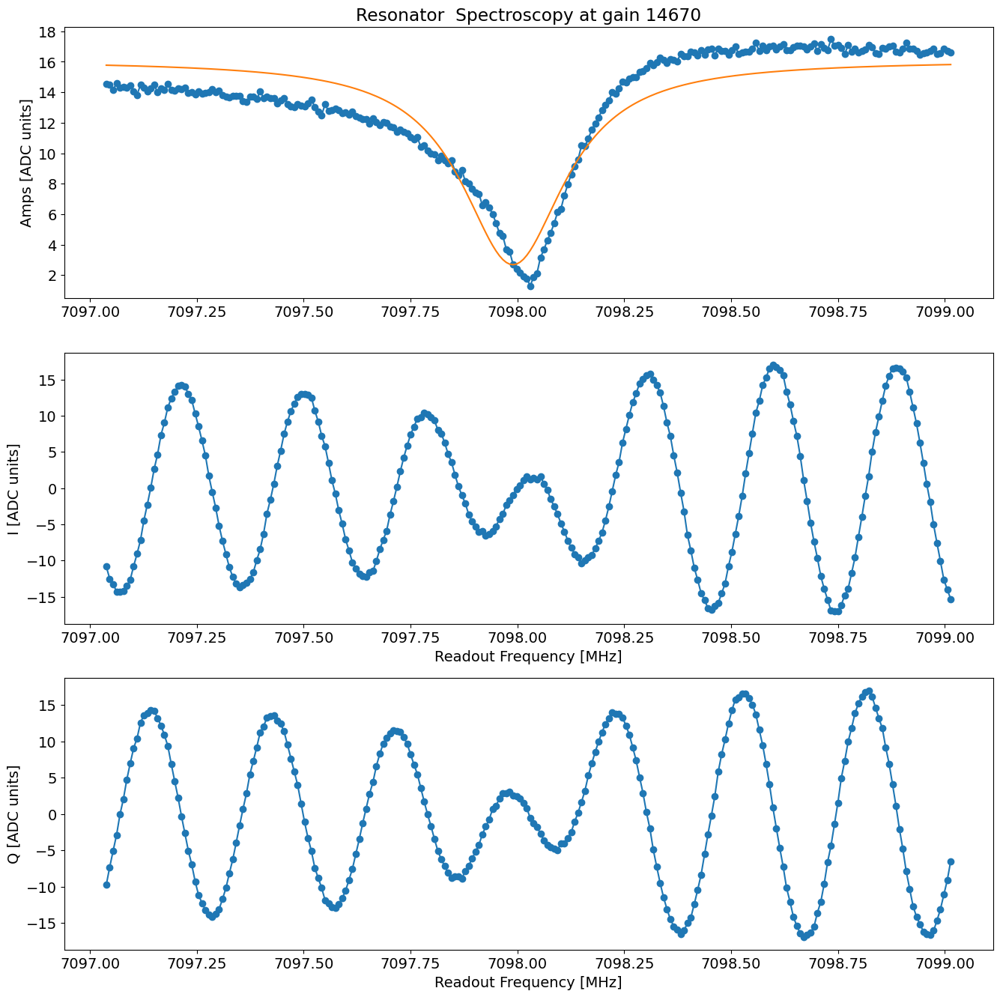

In [20]:
# Resonator Spectroscopy
qubit_i = 0
rspec = meas.ResonatorSpectroscopyExperiment(
    soccfg=soc,
    path=expt_path,
    prefix=f"resonator_spectroscopy_qubit{qubit_i}",
    config_file=results_config_path,   
)
span = 2 # MHz
npts = 250 

rspec.cfg.expt = dict(
    start=rspec.cfg.device.readout.frequency[qubit_i]-span/2, # resonator 
    step=span/npts, # min step ~1 Hz
    expts=npts, # Number experiments stepping from start
    reps= 500, # Number averages per point 500
    pulse_e=False, # add ge pi pulse prior to measurement
    pulse_f=False, # add ef pi pulse prior to measurement
    qubit=qubit_i,
)

rspec.cfg.device.readout.relax_delay = 5 # Wait time between experiments [us]
rspec.go(analyze=False, display=False, progress=True, save=False)

rspec.analyze(fit=True, findpeaks=False)
rspec.display(fit=True, findpeaks=False)





From Fit:
	f0: 7097.9896932530455
	kappa[MHz]: 0.2952591750505526


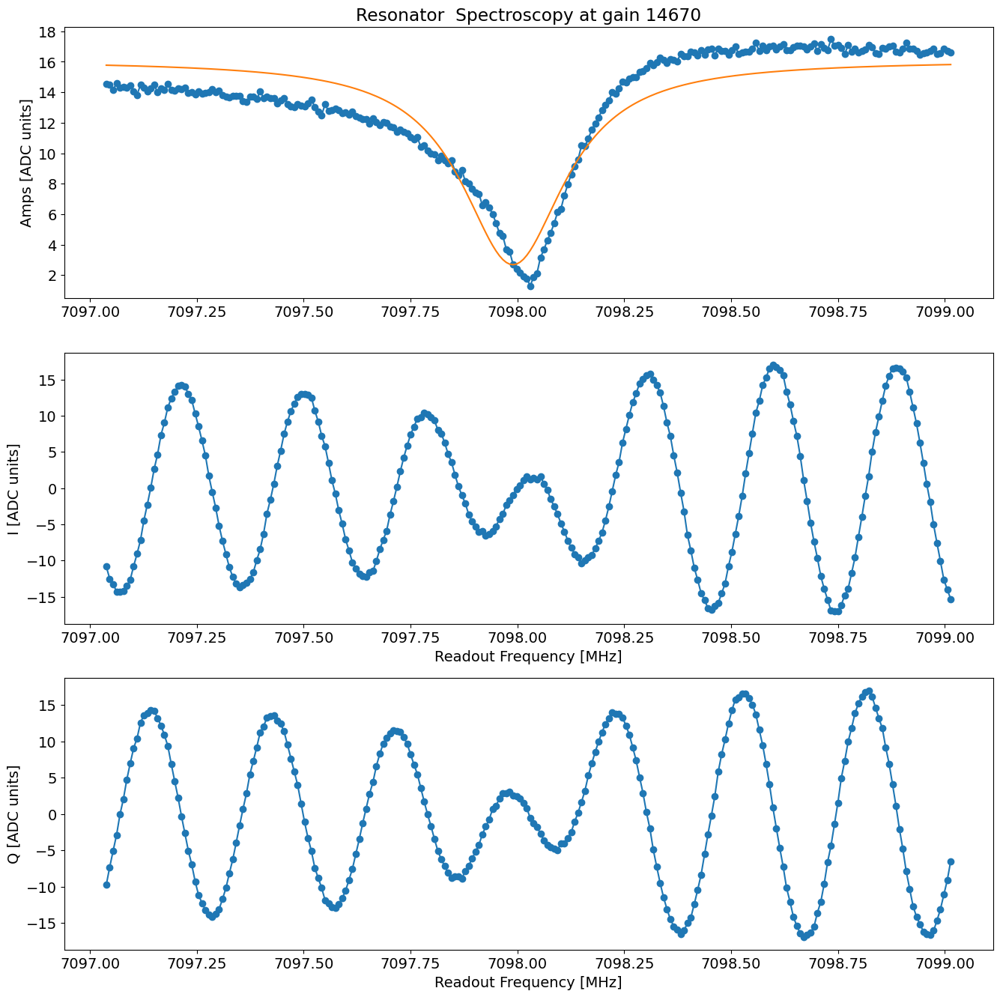

In [21]:
rspec.analyze(fit=True, findpeaks=False)
rspec.display(fit=True, findpeaks=False)

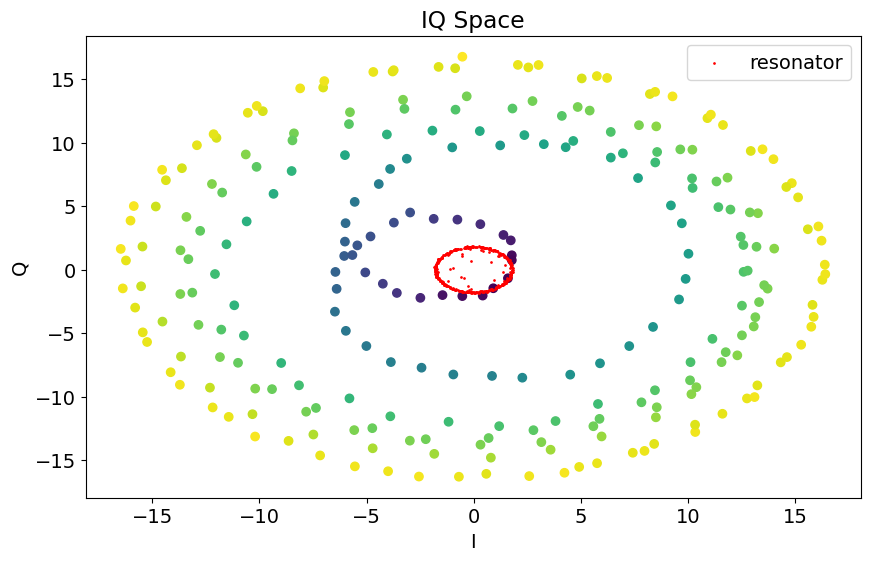

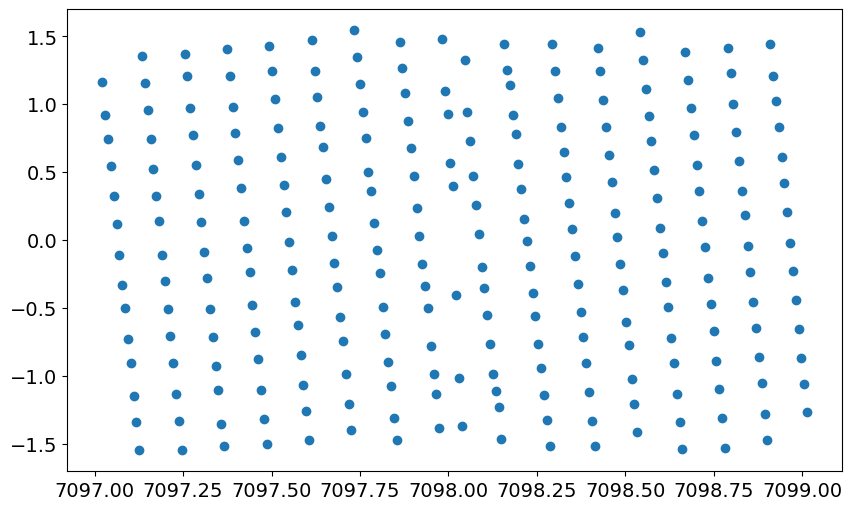

In [78]:
I = rspec.data['avgi']
Q = rspec.data['avgq']  
amp = np.sqrt(I**2 + Q**2)

i_res = []
q_res = []

for i, q in zip(g['avgi'][:], g['avgq'][:]):
    if i**2 + q**2 < 15**2:
        i_res.append(i)
        q_res.append(q)

    
plt.scatter(I, Q, c = amp)
plt.scatter(i_res, q_res, color='r', s = 0.9, label = 'resonator')
plt.xlabel('I')
plt.ylabel('Q')
plt.title('IQ Space')
plt.legend() 

plt.figure() 
phase = (np.arctan(rspec.data['avgq']/rspec.data['avgi']))
plt.plot(rspec.data['xpts'], phase, 'o')

<KeysViewHDF5 ['amps', 'avgi', 'avgq', 'fit', 'fit_err', 'phases', 'xpts']>
(400,)
(400,)
(400,)


C:\Users\slab\AppData\Local\Temp\ipykernel_16996\3476783682.py:50: MatplotlibDeprecationWarning: Auto-removal of overlapping axes is deprecated since 3.6 and will be removed two minor releases later; explicitly call ax.remove() as needed.
  plt.subplot(3, 1, 1)


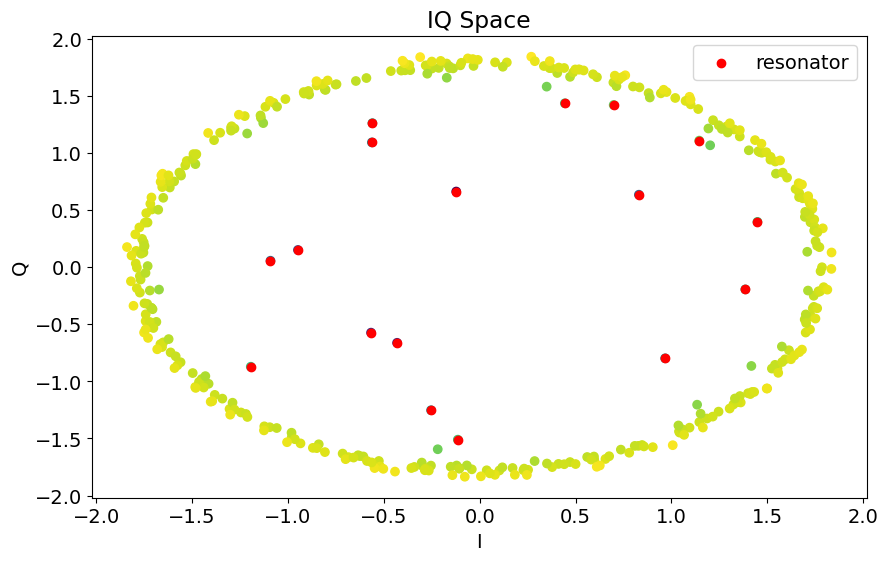

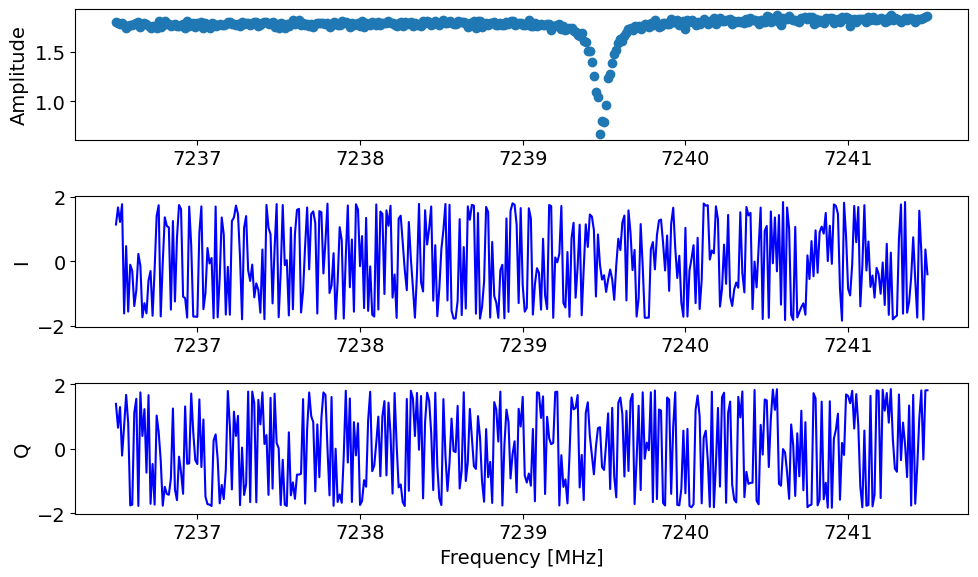

In [76]:
# open h5 file 
import h5py
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.cm as cm


pth = "C:\\_Lib\\python\\rfsoc\\elaine_rfsoc\\slab_rfsoc_expts\\data\\00000_resonator_spectroscopy_qubit5.h5"

g = h5py.File(pth, 'r')
print(g.keys())

# plt.plot(g['avgi'], g['avgq'], 'o')
print(np.shape(g['avgi']))
print(np.shape(g['avgq']))  
print(np.shape(g['xpts']))

amp = np.sqrt(g['avgi'][:]**2 + g['avgq'][:]**2)

# extract the points that contribute to the resonator peak

i_res = []
q_res = []

for i, q in zip(g['avgi'][:], g['avgq'][:]):
    if i**2 + q**2 < 1.6**2:
        i_res.append(i)
        q_res.append(q)


#colors = cm.rainbow(g['xpts'][:])
#print(colors)

plt.scatter(g['avgi'][:], g['avgq'][:], c =amp)
plt.scatter(i_res, q_res, c='red', label='resonator')
plt.xlabel('I')
plt.ylabel('Q')
plt.title('IQ Space')
plt.legend()

plt.figure()
plt.plot(g['xpts'][:], g['avgi'][:], 'green')
plt.plot(g['xpts'][:], g['avgq'][:], 'blue')


# plt.figure()
# amp = np.sqrt(g['avgi'][:]**2 + g['avgq'][:]**2)
# create a subplot with 1 column and 3 rows 

plt.subplot(3, 1, 1)
plt.plot(g['xpts'][:], amp,  'o')
plt.ylabel('Amplitude')
plt.subplot(3, 1, 2)
plt.plot(g['xpts'][:], g['avgi'][:], 'blue')
plt.ylabel('I')
plt.subplot(3, 1, 3)
plt.plot(g['xpts'][:], g['avgq'][:], 'blue')
plt.xlabel('Frequency [MHz]')
plt.ylabel('Q')
# reshape the subplot to fit the figure
plt.tight_layout()

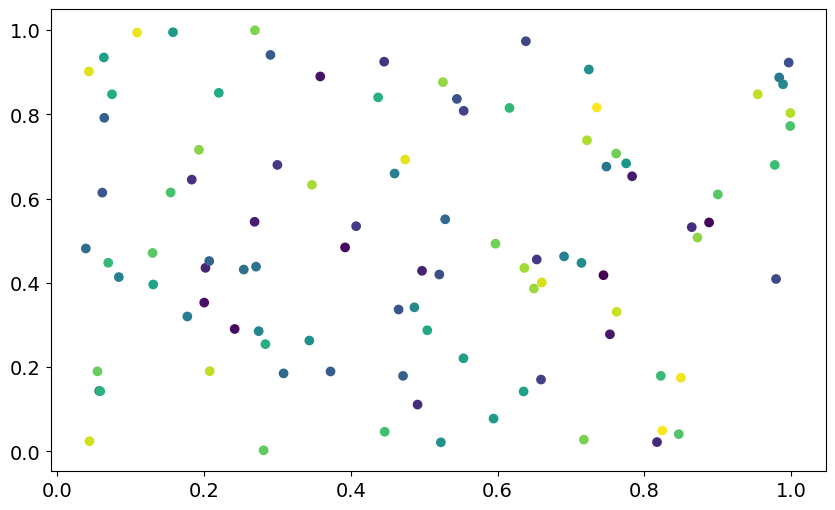

In [51]:
import numpy as np
import matplotlib.pyplot as plt

x = np.random.rand(100)
y = np.random.rand(100)
t = np.arange(100)

plt.scatter(x, y, c=t)
plt.show()

7098.030026730655


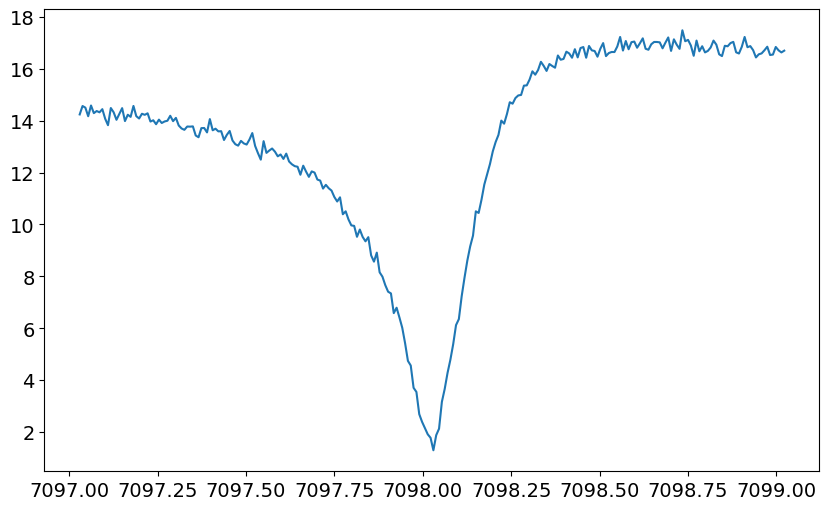

In [22]:
amp_value = np.min(rspec.data['amps'])
frequency = rspec.data['xpts'][np.where(rspec.data['amps'] == amp_value)]

plt.plot(rspec.data['xpts'], rspec.data['amps'])
print(frequency[0])

In [13]:
# open the results config file 
with open(results_config_file,'r') as file:
  auto_cfg=AttrDict(yaml.safe_load(file)) # turn it into an attribute dictionary 

# assign the resonator frequency to the results config file
auto_cfg.device.readout.frequency[qubit_i] = float(rspec.data['lorentz_fit'][2])
auto_cfg.device.readout.kappa[qubit_i] = float(2*rspec.data['lorentz_fit'][3])  

auto_cfg= yaml.safe_dump(auto_cfg.to_dict(), default_flow_style=  True)

# write it: 
with open('autocalibration_cfg.yml', 'w') as modified_file:
  modified_file.write(auto_cfg)
# now, open the modified file again 
with open('autocalibration_cfg.yml','r') as file:
  auto_cfg=AttrDict(yaml.safe_load(file)) # turn it into an attribute dictionary 

print(f'*Set cfg res {qubit_i} freq to {auto_cfg.device.readout.frequency[qubit_i]} Mhz*')
print(f'*Set cfg res {qubit_i} kappa to {auto_cfg.device.readout.kappa[qubit_i]} MHz*')

*Set cfg res 0 freq to 7098.094026730655 Mhz*
*Set cfg res 0 kappa to 0.2759034888460681 MHz*


  0%|          | 0/250000 [00:00<?, ?it/s]

Found peak in amps at [MHz] 3570.6280533122963, HWHM 0.1936569998456466
Found peak in I at [MHz] 3570.6282630442897, HWHM 0.1951452858523585
Found peak in Q at [MHz] 3570.6169339775834, HWHM 0.16194641646471378


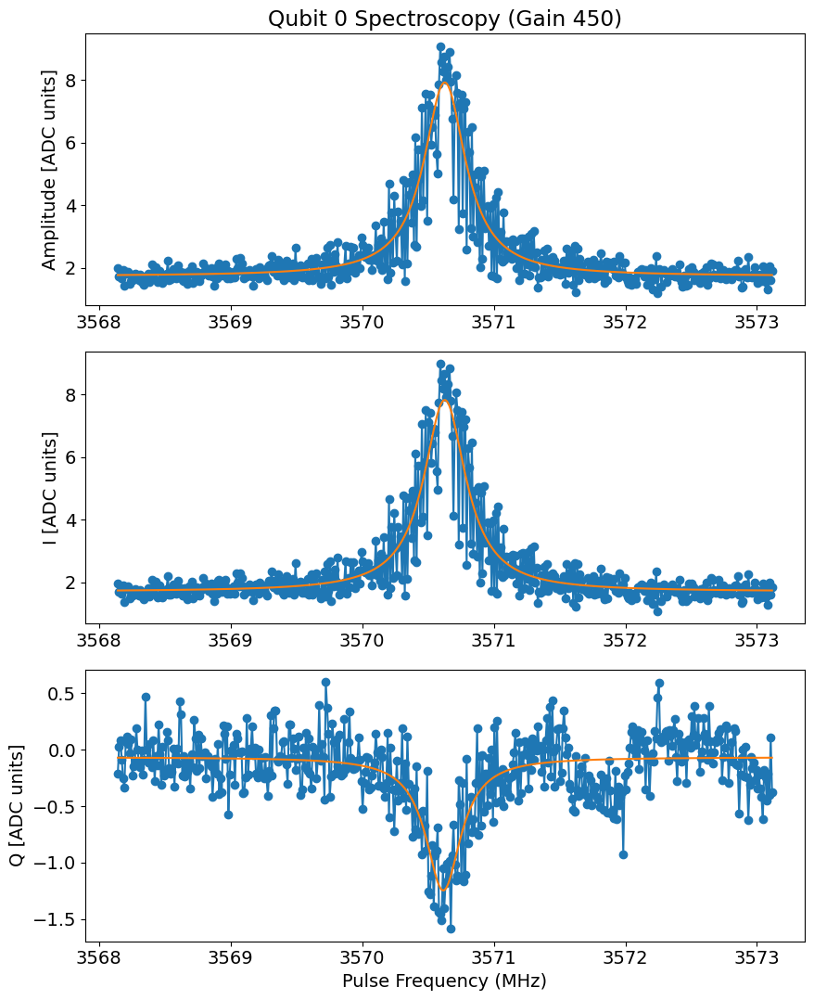

In [23]:
qspec = meas.PulseProbeSpectroscopyExperiment(
    soccfg=soc,
    path = expt_path, 
    prefix = f"qubit_spectroscopy_qubit{qubit_i}",
    config_file=results_config_path,
    )

span = 5 
npts = 500

qspec.cfg.expt = dict(
    start= qspec.cfg.device.qubit.f_ge[qubit_i]-span/2, # qubit frequency to be mixed up [MHz]
    step = span/npts, # min step ~1 Hz
    expts = npts, # Number experiments stepping from start
    reps = 500, # Number averages per point
    rounds = 1, #Number of start to finish sweeps to average over 
    length = 50, # qubit probe constant pulse length [us]
    gain = 450, #qubit pulse gain  
    pulse_type = 'const', 
    #pulse_type = 'gauss',  
    qubit = qubit_i,
) 

qspec.cfg.device.readout.relax_delay = 10 # Wait time between experiments [us]
qspec.go(analyze=False, display=False, progress=True, save=False)

qspec.analyze(fit=True, signs = [1,-1,1])
qspec.display(fit=True, signs= [1, -1, 1])


In [24]:
# open the results config file 
with open(results_config_file,'r') as file:
  auto_cfg=AttrDict(yaml.safe_load(file)) # turn it into an attribute dictionary 

# assign the qubit frequency to the results config file
auto_cfg.device.qubit.f_ge[qubit_i] = float(qspec.data["fit_amps"][2])
auto_cfg.device.qubit.kappa[qubit_i] = float(2*qspec.data["fit_amps"][3])
auto_cfg= yaml.safe_dump(auto_cfg.to_dict(), default_flow_style=  True) # dump it 

# write it:
with open('autocalibration_cfg.yml', 'w') as modified_file:
  modified_file.write(auto_cfg)
# now, open the modified file again 
with open('autocalibration_cfg.yml','r') as file:
  auto_cfg=AttrDict(yaml.safe_load(file)) # turn it into an attribute dictionary 


print(f'*Set cfg qubit {qubit_i} freq to {auto_cfg.device.qubit.f_ge[qubit_i]} MHz*')
print(f'*Set cfg qubit {qubit_i} kappa to {auto_cfg.device.qubit.kappa[qubit_i]} MHz*')

*Set cfg qubit 0 freq to 3570.6280533122963 MHz*
*Set cfg qubit 0 kappa to 0.3873139996912932 MHz*


  0%|          | 0/300 [00:00<?, ?it/s]

Attempted to init fitparam 1 to 184.11451505016723, which is out of bounds 0.14432214765100673 to 21.648322147651008. Instead init to 10.896322147651007
Attempted to init fitparam 1 to 184.11451505016723, which is out of bounds 0.14432214765100673 to 21.648322147651008. Instead init to 10.896322147651007
Decay from avgi [us] 0.2078683035714286
Pi length from avgi data [us]: 0.07975045647424701
	Pi/2 length from avgi data [us]: 0.03987522823712351

Decay from avgq [us] 0.6368214498697397
Pi length from avgq data [us]: 0.16401944995271794
Pi/2 length from avgq data [us]: 0.08200972497635897


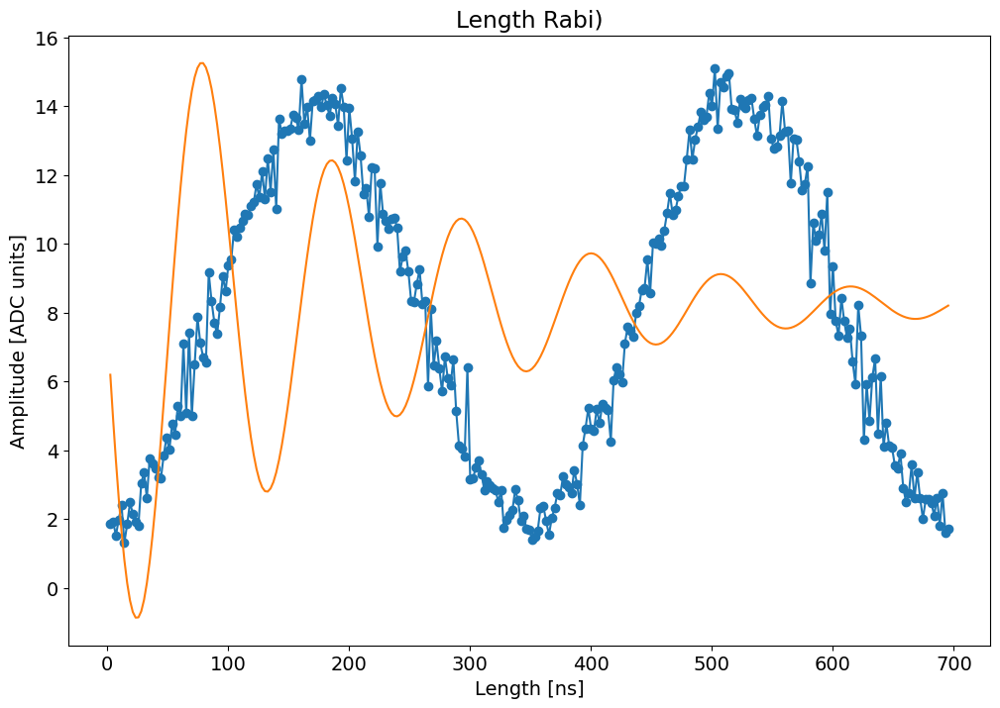

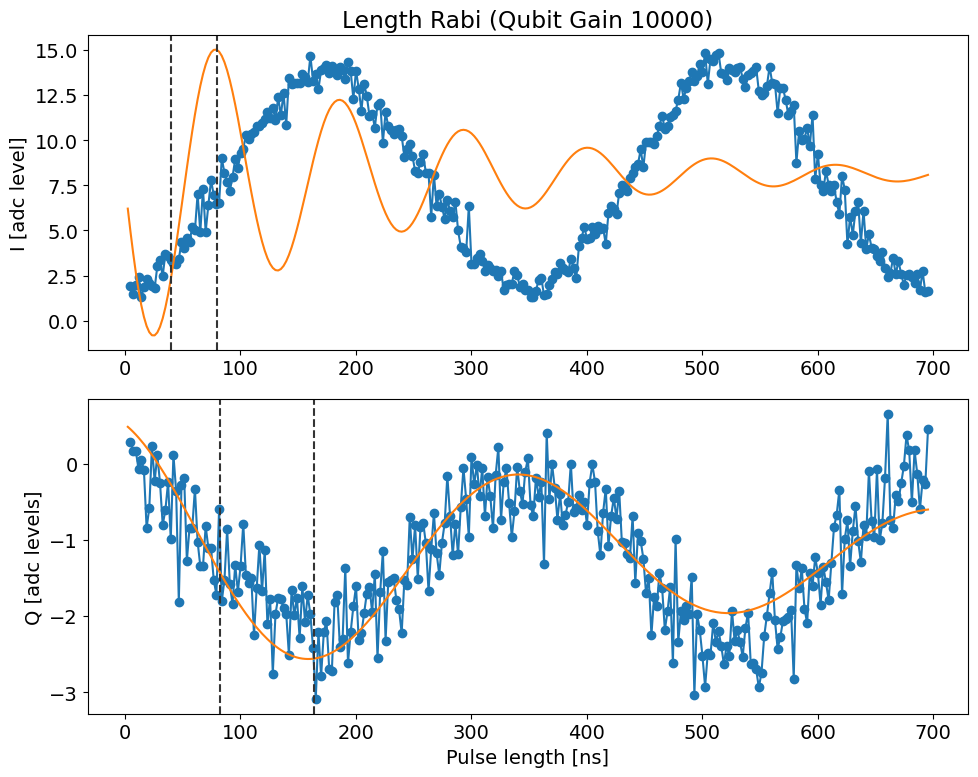

In [25]:
# Length Rabi

lengthrabi = meas.LengthRabiExperiment(
    soccfg=soc,
    path=expt_path,
    prefix=f"length_rabi_qubit{qubit_i}",
    config_file=results_config_path,
)

lengthrabi.cfg.expt = dict(
    start =  0.0025, 
    step=  soc.cycles2us(1), # [us] this is the samllest possible step size (size of clock cycle)
    expts= 300 , #51 #number of experiments stepping from start to end 
    reps= 100, #2000
    gain = 10000, #qubit gain [DAC units]
    #gain=lengthrabi.cfg.device.qubit.pulses.pi_ge.gain[qubit_i],
    pulse_type='gauss',
    # pulse_type='const',
    checkZZ=False,
    checkEF=False, 
    qubits=[qubit_i],
    num_pulses = 1, #number of pulses to play, must be an odd number 
)

import Pyro4.util
try:
    lengthrabi.go(analyze=False, display=False, progress=True, save=False)
except Exception:
    print("Pyro traceback:")
    print("".join(Pyro4.util.getPyroTraceback()))

lengthrabi.analyze(fit=True)
lengthrabi.display(fit=True)


***NOTE: NEED TO FIND BETTER WAY TO SAVE THE PI LENGTH (MAKE SURE NOT SAVING A CRAPPY PI LENGTH --> LOOK AT ERROR RATIO BETWEEN PI LENGTH AND I / Q DATA)

In [26]:

# save the pi pulse length to the results config file
p = lengthrabi.data['fit_avgi']     
if p[2] > 180: p[2] = p[2] - 360
elif p[2] < -180: p[2] = p[2] + 360
if p[2] < 0: pi_lengthi = (1/2 - p[2]/180)/2/p[1]
else: pi_lengthi= (3/2 - p[2]/180)/2/p[1]

p = lengthrabi.data['fit_avgq']     
if p[2] > 180: p[2] = p[2] - 360
elif p[2] < -180: p[2] = p[2] + 360
if p[2] < 0: pi_lengthq = (1/2 - p[2]/180)/2/p[1]
else: pi_lengthq= (3/2 - p[2]/180)/2/p[1]

# open the results config file 
with open(results_config_file,'r') as file:
    auto_cfg=AttrDict(yaml.safe_load(file)) # turn it into an attribute dictionary

auto_cfg.device.qubit.pulses.pi_ge.sigma[qubit_i] = float(pi_lengthq)  # [us] (pi pulse length)


auto_cfg= yaml.safe_dump(auto_cfg.to_dict(), default_flow_style=  True) # dump it 

# write it: 
with open('autocalibration_cfg.yml', 'w') as modified_file:
    modified_file.write(auto_cfg)
# now, open the modified file again 
with open('autocalibration_cfg.yml','r') as file:
    auto_cfg=AttrDict(yaml.safe_load(file)) # turn it into an attribute dictionary 

print(f'*Set cfg qubit {qubit_i} rabi length to {auto_cfg.device.qubit.pulses.pi_ge.sigma[qubit_i]}* us')



*Set cfg qubit 0 rabi length to 0.16401944995271794* us


qTest =  0.16401944995271794
gauss


  0%|          | 0/20000 [00:00<?, ?it/s]

Pi gain from amps data [dac units]: 10582
	Pi/2 gain from amps data [dac units]: 5291
Pi gain from avgi data [dac units]: 10579
	Pi/2 gain from avgi data [dac units]: 5289
Pi gain from avgq data [dac units]: 10315
	Pi/2 gain from avgq data [dac units]: 5157


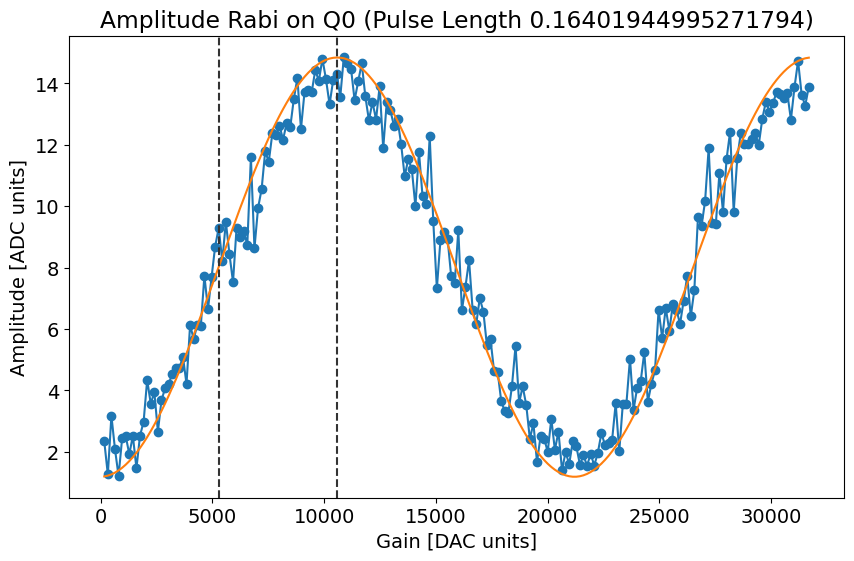

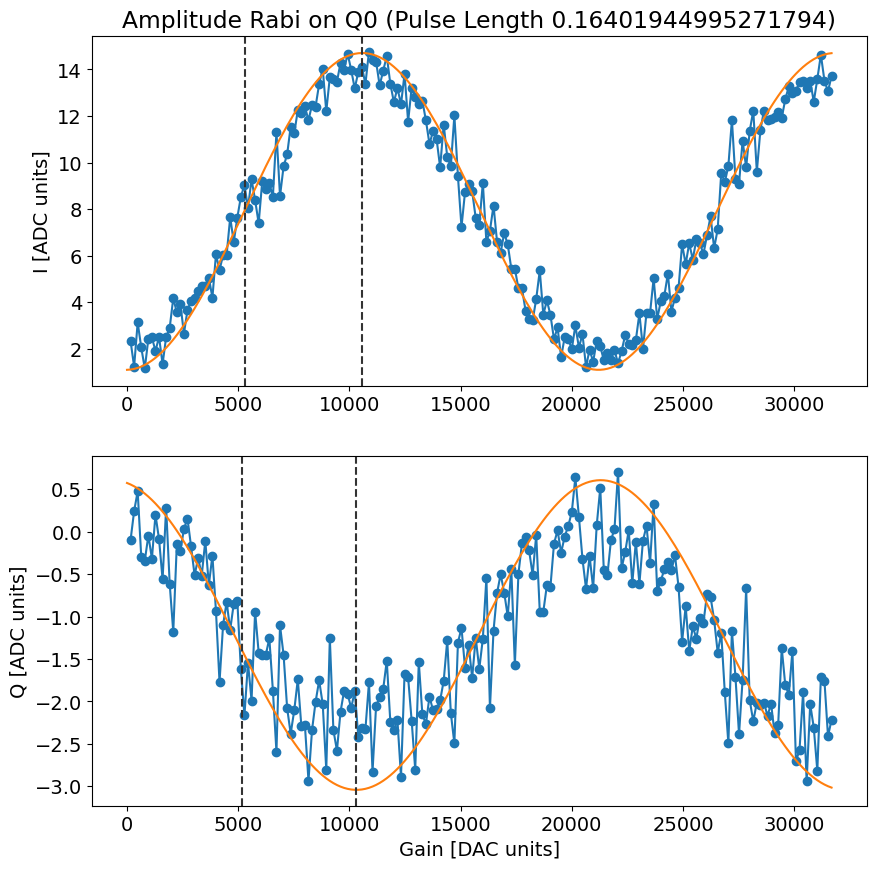

In [27]:
# Amplitude Rabi
amprabi = meas.AmplitudeRabiExperiment(
    soccfg=soc,
    path=expt_path,
    prefix=f"amp_rabi_qubit{qubit_i}",
    config_file=results_config_path,
)

span = 32000
npts = 200
amprabi.cfg.expt = dict(
    start= 0,
    step=int(span/npts), # [dac level]
    expts=npts,
    reps=100,
    rounds=1,
    sigma_test= auto_cfg.device.qubit.pulses.pi_ge.sigma[qubit_i], # gaussian sigma for pulse length - overrides config [us]
    checkZZ=False,
    checkEF=False, 
    qubits=[qubit_i],
    pulse_type='gauss',
    # pulse_type='const',
    num_pulses = 1, #number of pulses to play, must be an odd number in order to achieve a pi rotation at pi length/ num_pulses 
)

import Pyro4.util
try:
    amprabi.go(analyze=False, display=False, progress=True, save=False)
except Exception:
    print("Pyro traceback:")
    print("".join(Pyro4.util.getPyroTraceback()))

amprabi.analyze(fit=True)
amprabi.display(fit=True)

***NOTE: NEED TO FIND BETTER WAY TO SAVE THE PI LENGTH (MAKE SURE NOT SAVING A CRAPPY PI LENGTH --> LOOK AT ERROR RATIO BETWEEN PI LENGTH AND I / Q DATA)

In [28]:
p = amprabi.data['fit_avgi']
if p[2] > 180: p[2] = p[2] - 360
elif p[2] < -180: p[2] = p[2] + 360
if p[2] < 0: pi_gaini = (1/2 - p[2]/180)/2/p[1]
else: pi_gaini= (3/2 - p[2]/180)/2/p[1]

p = amprabi.data['fit_avgq']
if p[2] > 180: p[2] = p[2] - 360
elif p[2] < -180: p[2] = p[2] + 360
if p[2] < 0: pi_gainq = (1/2 - p[2]/180)/2/p[1]
else: pi_gainq = (3/2 - p[2]/180)/2/p[1]


# open the results config file 
with open(results_config_file,'r') as file:
    auto_cfg=AttrDict(yaml.safe_load(file)) # turn it into an attribute dictionary

auto_cfg.device.qubit.pulses.pi_ge.gain[qubit_i] = int(pi_gaini)  # [DAC units]  

auto_cfg= yaml.safe_dump(auto_cfg.to_dict(), default_flow_style=  True) # dump it 

# write it: 
with open('autocalibration_cfg.yml', 'w') as modified_file:
    modified_file.write(auto_cfg)
# now, open the modified file again 
with open('autocalibration_cfg.yml','r') as file:
    auto_cfg=AttrDict(yaml.safe_load(file)) # turn it into an attribute dictionary 

print(f'*Set cfg qubit {qubit_i} rabi amplitude to {auto_cfg.device.qubit.pulses.pi_ge.gain[qubit_i]}* DAC units')


*Set cfg qubit 0 rabi amplitude to 10579* DAC units


In [98]:
shot = meas.HistogramExperiment(
    soccfg=soc,
    path=expt_path,
    prefix=f"single_shot_qubit{qubit_i}",
    config_file= results_config_path,
)

shot.cfg.expt = dict(
    reps=1000,
    check_e = True, 
    check_f=False,
    qubit=0,
)

shot.go(analyze=False, display=False, progress=True, save=True)

using phase reset
<Pyro4.core.Proxy at 0x28c75720b80; not connected; for PYRO:obj_e0a12d402d674a73a40b28fdfe13addf@192.168.137.233:40721>


  0%|          | 0/1000 [00:00<?, ?it/s]

using phase reset


  0%|          | 0/1000 [00:00<?, ?it/s]

Saving c:\_Lib\python\rfsoc\elaine_rfsoc\slab_rfsoc_expts\00024_single_shot_qubit0.h5


Unrotated:
Ig 1.0257535021932926 +/- 3.475207311378478 	 Qg 0.5237017121833876 +/- 3.4123942188501752 	 Amp g 1.1517090477223912
Ie 10.15579453799349 +/- 4.504049684394578 	 Qe 0.7135276637894439 +/- 3.345041258135371 	 Amp e 10.180829260179705
Rotated:
Ig 1.0435913677812225 +/- 3.475207311378478 	 Qg 0.48359910448801846 +/- 3.4123942188501752 	 Amp g 1.1501960862257774
Ie 10.167057818819263 +/- 4.504049684394578 	 Qe 0.44851408927363967 +/- 3.345041258135371 	 Amp e 10.176945984896001


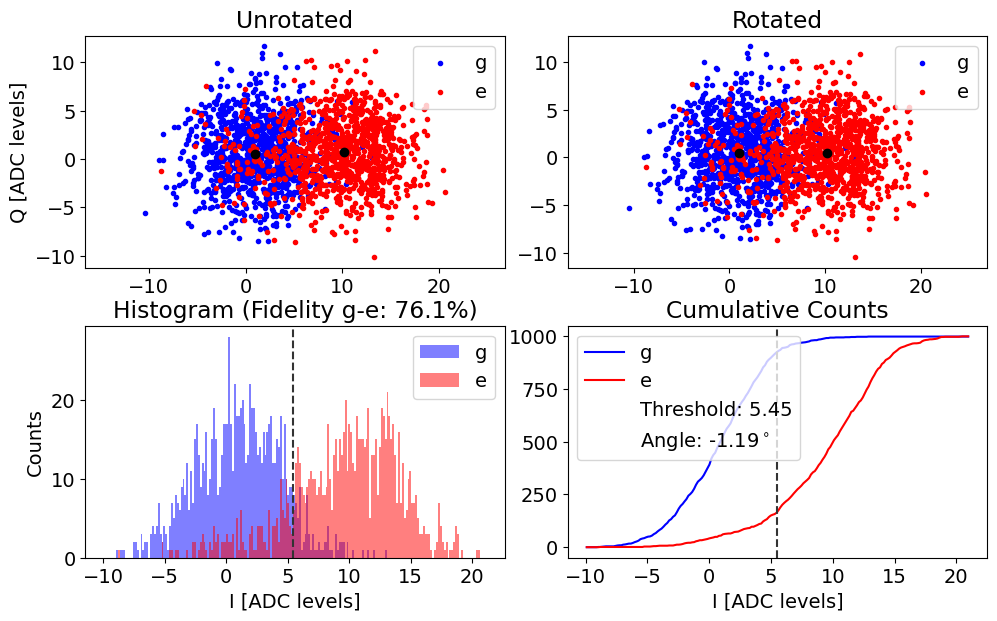

ge fidelity (%): 76.13806903451726
rotation angle (deg): -1.1910854550489562
threshold ge: 5.450241817147646


In [99]:
# # TESTING
shot.analyze(verbose=False)
shot.display(verbose=True, plot_f=False)

In [97]:
with open(results_config_file,'r') as file:
    auto_cfg=AttrDict(yaml.safe_load(file)) # turn it into an attribute dictionary

auto_cfg.device.readout.phase[qubit_i] = 9.9115919221181 # degrees
# auto_cfg.device.readout.threshold[qubit_i] = 57.221847452942725 # [DAC units]
    
auto_cfg.device.readout.gain[qubit_i] = 10000 # [DAC units]
auto_cfg.device.readout.readout_length[qubit_i] = 23 # [us]
# auto_cfg.device.readout.frequency[qubit_i] = 7098.022026730655

auto_cfg= yaml.safe_dump(auto_cfg.to_dict(), default_flow_style=  True) # dump it 

# write it: 
with open('autocalibration_cfg.yml', 'w') as modified_file:
    modified_file.write(auto_cfg)
# now, open the modified file again 
with open('autocalibration_cfg.yml','r') as file:
    auto_cfg=AttrDict(yaml.safe_load(file)) # turn it into an attribute dictionary

In [53]:
qubit_i = 0

  0%|          | 0/25000 [00:00<?, ?it/s]

Saving c:\_Lib\python\rfsoc\elaine_rfsoc\slab_rfsoc_expts\00000_t1_qubit0.h5
Fit T1 avgi [us]: 140.79570726285655
Fit T1 avgq [us]: 128.76147413623656


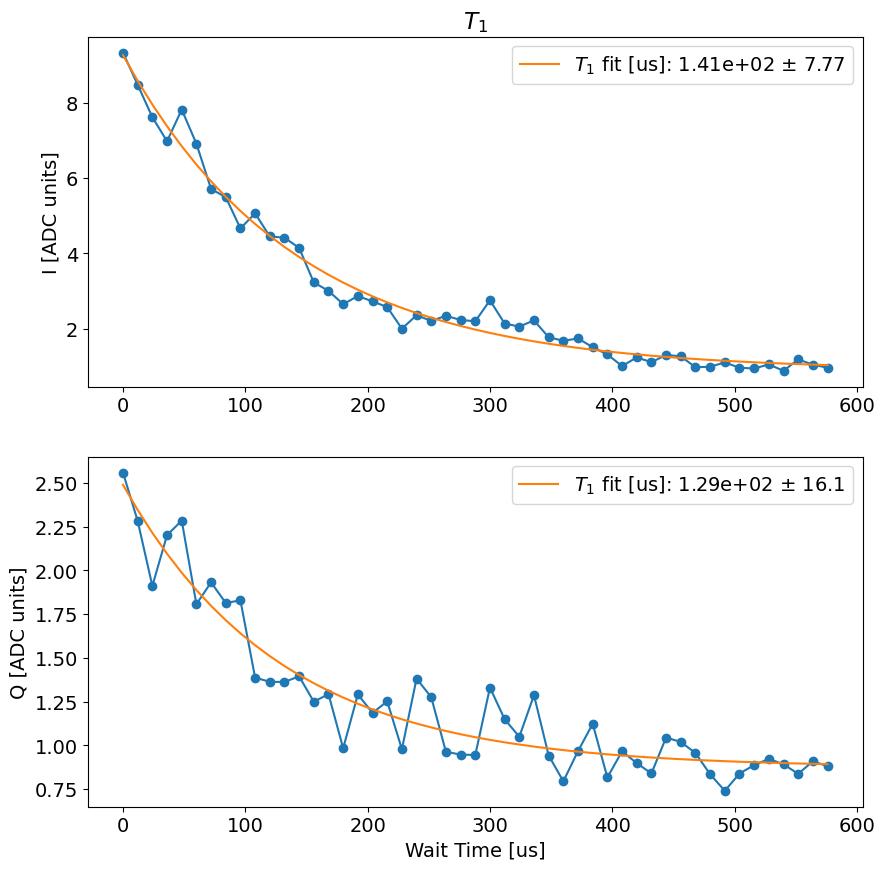

In [100]:
# T1 
t1 = meas.T1Experiment(
    soccfg=soc,
    path=expt_path,
    prefix=f"t1_qubit{qubit_i}",
    config_file= results_config_path,
)

span = 600 
npts = 50

t1.cfg.expt = dict(
    start=0, # wait time [us]
    step=int(span/npts), 
    expts=npts,
    reps=5*100, # number of times we repeat a time point 
    rounds=1, # number of start to finish sweeps to average over
    qubit=qubit_i,
    length_scan = span, # length of the scan in us
    num_saved_points = 0, # number of points to save for the T1 continuous scan 
)

t1.go(analyze=False, display=False, progress=True, save=True)
t1.analyze(fit=True)
t1.display()

In [101]:
t1_err_i = np.sqrt(t1.data['fit_err_avgi'][3][3])
t1_fit_i =t1.data['fit_avgi'][3]
err_ratio_i = t1_err_i/t1_fit_i
print('t1_i error:fit ratio=', err_ratio_i)

t1_err_q = np.sqrt(t1.data['fit_err_avgq'][3][3])
t1_fit_q =t1.data['fit_avgq'][3]
err_ratio_q = t1_err_q/t1_fit_q
print('t1_q error:fit ratio=', err_ratio_q)

# open the results config file 
with open(results_config_file,'r') as file:
    auto_cfg=AttrDict(yaml.safe_load(file)) # turn it into an attribute dictionary

if err_ratio_i< err_ratio_q:
    print('t1_i is better, saving T1_i to results cfg file') 
    auto_cfg.device.qubit.T1[qubit_i] = float(t1_fit_i)  # [DAC units]  

else: 
    print('t1_q is better, saving t1_q to results cfg file')
    auto_cfg.device.qubit.T1[qubit_i] = float(t1_fit_q)  # [DAC units]  

auto_cfg= yaml.safe_dump(auto_cfg.to_dict(), default_flow_style=  True) # dump it 

# write it: 
with open('autocalibration_cfg.yml', 'w') as modified_file:
    modified_file.write(auto_cfg)
# now, open the modified file again 
with open('autocalibration_cfg.yml','r') as file:
    auto_cfg=AttrDict(yaml.safe_load(file)) # turn it into an attribute dictionary 

print(f'*Set cfg qubit {qubit_i} T1 to {auto_cfg.device.qubit.T1[qubit_i]}* us')

t1_i error:fit ratio= 0.05517387309068736
t1_q error:fit ratio= 0.12527723868882668
t1_i is better, saving T1_i to results cfg file
*Set cfg qubit 0 T1 to 140.79570726285655* us


In [18]:
print(np.shape(t1.data['avgi']))

(200,)


Readout Optimization

In [23]:
shotopt = meas.SingleShotOptExperiment(
    soccfg=soc,
    path=expt_path,
    prefix=f"single_shot_opt_qubit{qubit_i}",
    config_file=results_config_path,
)

span_f = 1 # MHz
npts_f = 5

span_gain = 0.07
# npts_gain = 2
npts_gain = 7

span_len = 9 # us
npts_len = 3

shotopt.cfg.expt = dict(
    reps=100000,
    qubit=qubit_i,

    start_f=shotopt.cfg.device.readout.frequency[qubit_i] - 0.5*span_f,
    step_f=span_f/npts_f,
    expts_f=npts_f,

    start_gain=0.01,
    step_gain=span_gain/npts_gain,
    expts_gain=npts_gain,

    start_len=3,
    step_len=span_len/npts_len,
    expts_len=npts_len,
)

print(shotopt.cfg)

shotopt.go(analyze=False, display=False, progress=True, save=False)

{'aliases': {'readout_LO': 'SC_26C1', 'soc': 'Qick233'}, 'device': {'qubit': {'T1': [119.64880616178345, 100, 100, 100, 177.46967033548438, 100], 'f_EgGf': [2000, 2000, 2000, 2000, 2000, 2000], 'f_ef': [4000, 4000, 4000, 4000, 4000, 4000], 'f_ge': [3571.1876956515216, 3309, 3300, 3300, 3267.9508134627254, 3300], 'kappa': [0.2304026448276766, 0, 0, 0, 0.5450565427872616, 0], 'pulses': {'hpi_ge': {'gain': [500, 500, 500, 500, 500, 500], 'sigma': [0.05889005791993152, 0.2, 0.2, 0.2, 0.05344152043448767, 0.2], 'type': ['gauss', 'gauss', 'gauss', 'gauss', 'gauss', 'gauss']}, 'pi_EgGf': {'gain': 10000, 'sigma': 0.1, 'type': ['gauss', 'gauss', 'gauss', 'gauss', 'gauss', 'gauss']}, 'pi_ef': {'gain': 10000, 'sigma': 0.1, 'type': ['gauss', 'gauss', 'gauss', 'gauss', 'gauss', 'gauss']}, 'pi_ge': {'gain': [18342, 1000, 1000, 1000, 15070, 1000], 'sigma': [0.09828914459485547, 0.01, 0.01, 0.01, 0.10688304086897533, 0.01], 'type': ['gauss', 'gauss', 'gauss', 'gauss', 'gauss', 'gauss']}}}, 'readout': 

  0%|          | 0/5 [00:00<?, ?it/s]

TypeError: ufunc 'left_shift' not supported for the input types, and the inputs could not be safely coerced to any supported types according to the casting rule ''safe''